# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:07, 23.9MB/s]                            
SVHN Testing Set: 64.3MB [00:01, 34.4MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

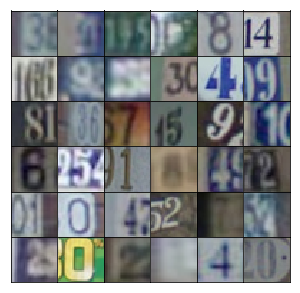

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512, activation=None, use_bias=False)
        x = tf.reshape(x, [-1, 4, 4, 512])
        # Batch normalization
        x = tf.layers.batch_normalization(x, training=training)
        # Leaky ReLU
        x = tf.maximum(x, alpha * x)
        
        # First convolutional layer, with shape 8x8x256
        conv_1 = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same', activation=None, use_bias=False)
        # Batch normalization
        conv_1 = tf.layers.batch_normalization(conv_1, training=training)
        # Leaky ReLU
        conv_1 = tf.maximum(conv_1, alpha * conv_1)
        
        # Second convolutional layer, with shape 16x16x128
        conv_2 = tf.layers.conv2d_transpose(conv_1, 128, 5, strides=2, padding='same', activation=None, use_bias=False)
        # Batch normalization
        conv_2 = tf.layers.batch_normalization(conv_2, training=training)
        # Leaky ReLU
        conv_2 = tf.maximum(conv_2, alpha * conv_2)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv_2, output_dim, 5, strides=2, padding='same', activation=None, use_bias=False)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        # First convolution, 16x16x64
        conv_1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same', activation=None)
        # Leaky ReLU
        conv_1 = tf.maximum(conv_1, alpha * conv_1)
        
        # Second convolution, 8x8x128
        conv_2 = tf.layers.conv2d(conv_1, 128, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv_2 = tf.layers.batch_normalization(conv_2, training=True)
        conv_2 = tf.maximum(conv_2, alpha * conv_2)
        
        # Third convolution, 4x4x256
        conv_3 = tf.layers.conv2d(conv_2, 256, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv_3 = tf.layers.batch_normalization(conv_3, training=True)
        conv_3 = tf.maximum(conv_3, alpha * conv_3)
        
        flat = tf.reshape(conv_3, [-1, 4*4*256])
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2958... Generator Loss: 0.6561
Epoch 1/25... Discriminator Loss: 0.6534... Generator Loss: 1.1289
Epoch 1/25... Discriminator Loss: 0.1459... Generator Loss: 2.7388
Epoch 1/25... Discriminator Loss: 0.1748... Generator Loss: 2.4625
Epoch 1/25... Discriminator Loss: 0.1564... Generator Loss: 2.6698
Epoch 1/25... Discriminator Loss: 0.1052... Generator Loss: 3.1226
Epoch 1/25... Discriminator Loss: 0.0971... Generator Loss: 3.3389
Epoch 1/25... Discriminator Loss: 0.1554... Generator Loss: 3.1315
Epoch 1/25... Discriminator Loss: 0.0734... Generator Loss: 3.6731
Epoch 1/25... Discriminator Loss: 0.3912... Generator Loss: 1.8796


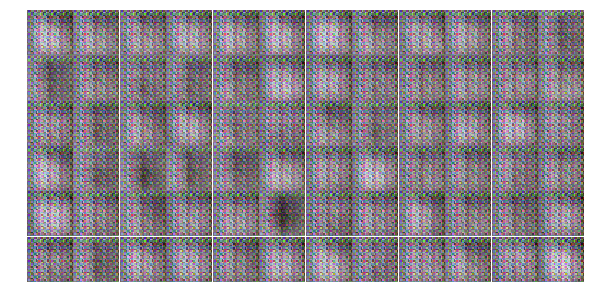

Epoch 1/25... Discriminator Loss: 0.4032... Generator Loss: 2.0345
Epoch 1/25... Discriminator Loss: 0.5655... Generator Loss: 1.8146
Epoch 1/25... Discriminator Loss: 0.5207... Generator Loss: 1.4245
Epoch 1/25... Discriminator Loss: 0.3213... Generator Loss: 1.8300
Epoch 1/25... Discriminator Loss: 0.5163... Generator Loss: 1.7931
Epoch 1/25... Discriminator Loss: 0.5945... Generator Loss: 1.2275
Epoch 1/25... Discriminator Loss: 0.3200... Generator Loss: 1.6916
Epoch 1/25... Discriminator Loss: 0.9902... Generator Loss: 2.0376
Epoch 1/25... Discriminator Loss: 0.6557... Generator Loss: 1.0742
Epoch 1/25... Discriminator Loss: 0.6739... Generator Loss: 1.1384


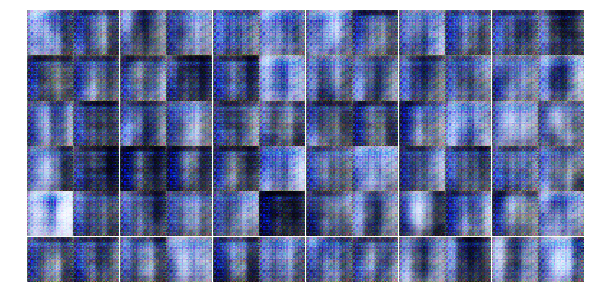

Epoch 1/25... Discriminator Loss: 0.5545... Generator Loss: 1.3772
Epoch 1/25... Discriminator Loss: 0.3391... Generator Loss: 1.6001
Epoch 1/25... Discriminator Loss: 0.3646... Generator Loss: 1.8586
Epoch 1/25... Discriminator Loss: 0.7995... Generator Loss: 0.9983
Epoch 1/25... Discriminator Loss: 1.9386... Generator Loss: 5.0906
Epoch 1/25... Discriminator Loss: 2.0655... Generator Loss: 0.2416
Epoch 1/25... Discriminator Loss: 0.7100... Generator Loss: 1.0366
Epoch 1/25... Discriminator Loss: 0.4877... Generator Loss: 1.8190
Epoch 1/25... Discriminator Loss: 0.5780... Generator Loss: 1.8384
Epoch 1/25... Discriminator Loss: 0.5398... Generator Loss: 1.7504


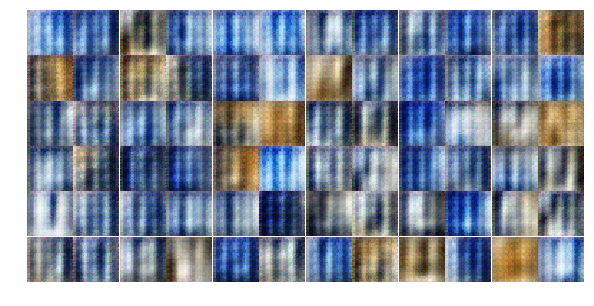

Epoch 1/25... Discriminator Loss: 0.4245... Generator Loss: 1.7613
Epoch 1/25... Discriminator Loss: 0.4829... Generator Loss: 4.1023
Epoch 1/25... Discriminator Loss: 0.7716... Generator Loss: 1.5730
Epoch 1/25... Discriminator Loss: 0.4904... Generator Loss: 2.0452
Epoch 1/25... Discriminator Loss: 0.2984... Generator Loss: 1.8897
Epoch 1/25... Discriminator Loss: 0.6629... Generator Loss: 2.8658
Epoch 1/25... Discriminator Loss: 1.2556... Generator Loss: 0.5808
Epoch 1/25... Discriminator Loss: 0.9234... Generator Loss: 1.1843
Epoch 1/25... Discriminator Loss: 0.9703... Generator Loss: 1.7917
Epoch 1/25... Discriminator Loss: 0.6205... Generator Loss: 1.3051


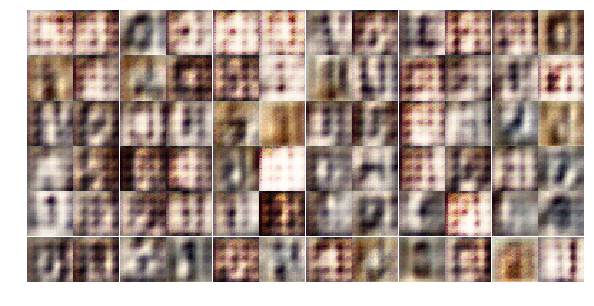

Epoch 1/25... Discriminator Loss: 0.4690... Generator Loss: 1.7235
Epoch 1/25... Discriminator Loss: 0.7092... Generator Loss: 1.4587
Epoch 1/25... Discriminator Loss: 1.1493... Generator Loss: 1.4866
Epoch 1/25... Discriminator Loss: 0.8633... Generator Loss: 2.3584
Epoch 1/25... Discriminator Loss: 0.6709... Generator Loss: 1.8855
Epoch 1/25... Discriminator Loss: 0.7415... Generator Loss: 1.3071
Epoch 1/25... Discriminator Loss: 0.4141... Generator Loss: 1.8763
Epoch 1/25... Discriminator Loss: 0.6257... Generator Loss: 2.5404
Epoch 1/25... Discriminator Loss: 0.6928... Generator Loss: 1.0801
Epoch 1/25... Discriminator Loss: 0.9369... Generator Loss: 1.1111


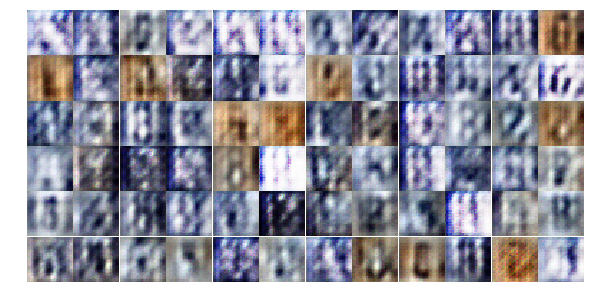

Epoch 1/25... Discriminator Loss: 0.6804... Generator Loss: 1.2858
Epoch 1/25... Discriminator Loss: 0.8605... Generator Loss: 0.9798
Epoch 1/25... Discriminator Loss: 0.5840... Generator Loss: 1.8869
Epoch 1/25... Discriminator Loss: 0.9826... Generator Loss: 0.7099
Epoch 1/25... Discriminator Loss: 0.8671... Generator Loss: 1.0450
Epoch 1/25... Discriminator Loss: 1.0371... Generator Loss: 1.7832
Epoch 1/25... Discriminator Loss: 0.8890... Generator Loss: 1.8652
Epoch 2/25... Discriminator Loss: 0.8487... Generator Loss: 1.4639
Epoch 2/25... Discriminator Loss: 0.5791... Generator Loss: 1.5191
Epoch 2/25... Discriminator Loss: 0.5616... Generator Loss: 1.7286


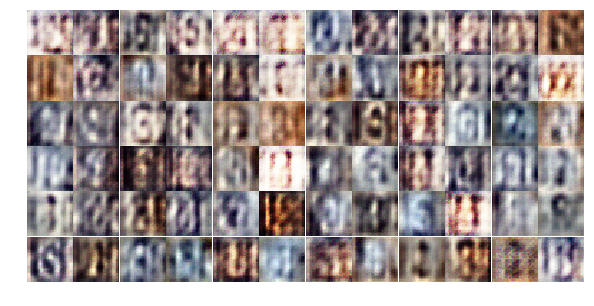

Epoch 2/25... Discriminator Loss: 0.9812... Generator Loss: 1.2624
Epoch 2/25... Discriminator Loss: 0.7012... Generator Loss: 2.0820
Epoch 2/25... Discriminator Loss: 1.0970... Generator Loss: 1.0430
Epoch 2/25... Discriminator Loss: 0.6802... Generator Loss: 1.6954
Epoch 2/25... Discriminator Loss: 0.9177... Generator Loss: 0.8801
Epoch 2/25... Discriminator Loss: 0.8945... Generator Loss: 1.3284
Epoch 2/25... Discriminator Loss: 1.2015... Generator Loss: 0.7490
Epoch 2/25... Discriminator Loss: 0.8484... Generator Loss: 1.5207
Epoch 2/25... Discriminator Loss: 1.3921... Generator Loss: 0.5292
Epoch 2/25... Discriminator Loss: 0.7964... Generator Loss: 1.4280


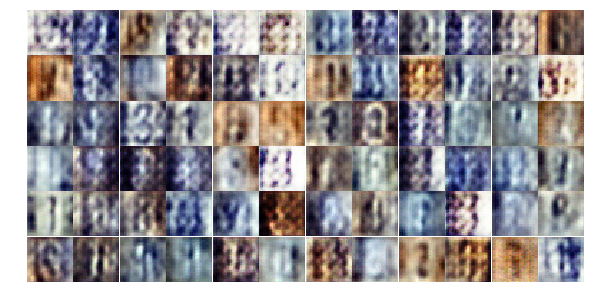

Epoch 2/25... Discriminator Loss: 1.0290... Generator Loss: 0.7953
Epoch 2/25... Discriminator Loss: 1.0221... Generator Loss: 1.2842
Epoch 2/25... Discriminator Loss: 1.1375... Generator Loss: 0.7704
Epoch 2/25... Discriminator Loss: 0.8482... Generator Loss: 0.9348
Epoch 2/25... Discriminator Loss: 1.1789... Generator Loss: 1.0871
Epoch 2/25... Discriminator Loss: 1.1795... Generator Loss: 0.6563
Epoch 2/25... Discriminator Loss: 1.1154... Generator Loss: 1.2057
Epoch 2/25... Discriminator Loss: 1.2600... Generator Loss: 0.7816
Epoch 2/25... Discriminator Loss: 1.2499... Generator Loss: 0.9242
Epoch 2/25... Discriminator Loss: 1.2933... Generator Loss: 0.6999


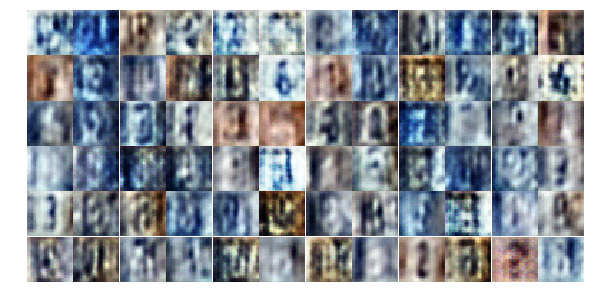

Epoch 2/25... Discriminator Loss: 0.9158... Generator Loss: 1.0633
Epoch 2/25... Discriminator Loss: 0.9686... Generator Loss: 1.2259
Epoch 2/25... Discriminator Loss: 0.8152... Generator Loss: 1.0602
Epoch 2/25... Discriminator Loss: 0.9574... Generator Loss: 1.3446
Epoch 2/25... Discriminator Loss: 0.8482... Generator Loss: 1.3255
Epoch 2/25... Discriminator Loss: 0.7631... Generator Loss: 1.8013
Epoch 2/25... Discriminator Loss: 1.2817... Generator Loss: 0.5112
Epoch 2/25... Discriminator Loss: 1.2314... Generator Loss: 0.7174
Epoch 2/25... Discriminator Loss: 1.2216... Generator Loss: 1.1099
Epoch 2/25... Discriminator Loss: 1.2210... Generator Loss: 0.5888


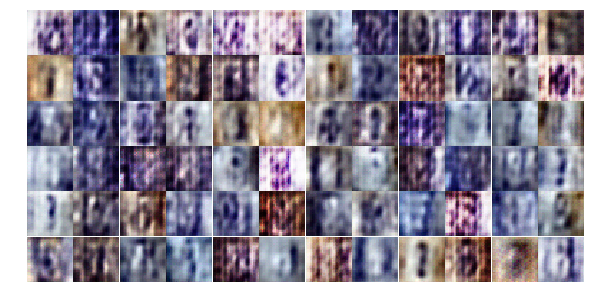

Epoch 2/25... Discriminator Loss: 1.0552... Generator Loss: 1.1072
Epoch 2/25... Discriminator Loss: 1.1299... Generator Loss: 0.7416
Epoch 2/25... Discriminator Loss: 1.7028... Generator Loss: 0.4408
Epoch 2/25... Discriminator Loss: 1.4690... Generator Loss: 0.5770
Epoch 2/25... Discriminator Loss: 1.0568... Generator Loss: 1.1909
Epoch 2/25... Discriminator Loss: 1.4295... Generator Loss: 1.1761
Epoch 2/25... Discriminator Loss: 1.2874... Generator Loss: 0.8477
Epoch 2/25... Discriminator Loss: 1.0428... Generator Loss: 1.1471
Epoch 2/25... Discriminator Loss: 1.0725... Generator Loss: 1.0602
Epoch 2/25... Discriminator Loss: 0.9425... Generator Loss: 1.4794


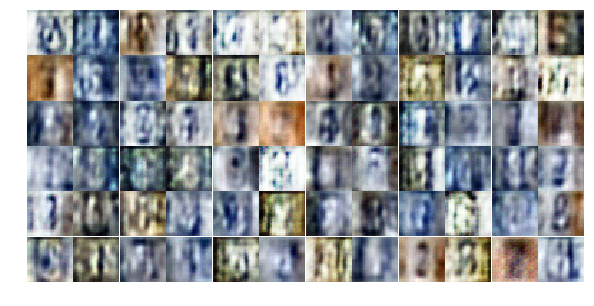

Epoch 2/25... Discriminator Loss: 0.8218... Generator Loss: 1.3318
Epoch 2/25... Discriminator Loss: 1.3795... Generator Loss: 0.6506
Epoch 2/25... Discriminator Loss: 0.8777... Generator Loss: 1.0278
Epoch 2/25... Discriminator Loss: 1.0019... Generator Loss: 1.2211
Epoch 2/25... Discriminator Loss: 1.0449... Generator Loss: 0.9512
Epoch 2/25... Discriminator Loss: 1.1702... Generator Loss: 0.7174
Epoch 2/25... Discriminator Loss: 1.0745... Generator Loss: 1.6157
Epoch 2/25... Discriminator Loss: 0.9048... Generator Loss: 1.1745
Epoch 2/25... Discriminator Loss: 0.7935... Generator Loss: 1.1734
Epoch 2/25... Discriminator Loss: 0.8260... Generator Loss: 1.3861


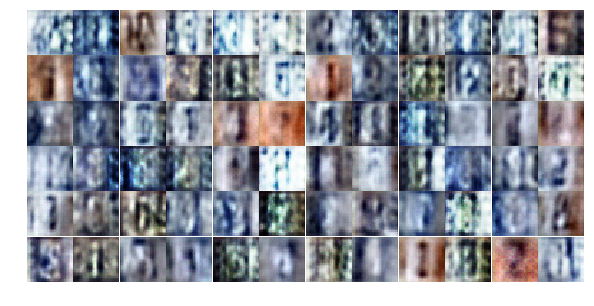

Epoch 2/25... Discriminator Loss: 1.3247... Generator Loss: 1.2223
Epoch 2/25... Discriminator Loss: 0.8233... Generator Loss: 1.0766
Epoch 2/25... Discriminator Loss: 1.3838... Generator Loss: 0.5178
Epoch 2/25... Discriminator Loss: 0.9592... Generator Loss: 0.9523
Epoch 3/25... Discriminator Loss: 0.6395... Generator Loss: 1.5557
Epoch 3/25... Discriminator Loss: 1.3900... Generator Loss: 2.5249
Epoch 3/25... Discriminator Loss: 1.1360... Generator Loss: 0.9587
Epoch 3/25... Discriminator Loss: 0.6603... Generator Loss: 1.2070
Epoch 3/25... Discriminator Loss: 0.8512... Generator Loss: 0.8183
Epoch 3/25... Discriminator Loss: 0.7515... Generator Loss: 2.0618


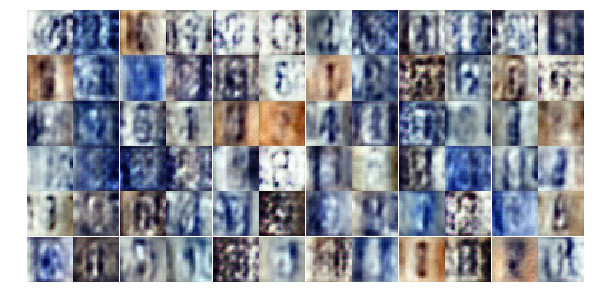

Epoch 3/25... Discriminator Loss: 0.7543... Generator Loss: 1.2339
Epoch 3/25... Discriminator Loss: 0.5339... Generator Loss: 1.9136
Epoch 3/25... Discriminator Loss: 0.7279... Generator Loss: 0.9591
Epoch 3/25... Discriminator Loss: 0.9660... Generator Loss: 1.0198
Epoch 3/25... Discriminator Loss: 0.6983... Generator Loss: 1.1216
Epoch 3/25... Discriminator Loss: 1.0241... Generator Loss: 0.7323
Epoch 3/25... Discriminator Loss: 0.6562... Generator Loss: 1.1486
Epoch 3/25... Discriminator Loss: 1.0852... Generator Loss: 0.6266
Epoch 3/25... Discriminator Loss: 0.4103... Generator Loss: 1.7603
Epoch 3/25... Discriminator Loss: 0.6929... Generator Loss: 1.1387


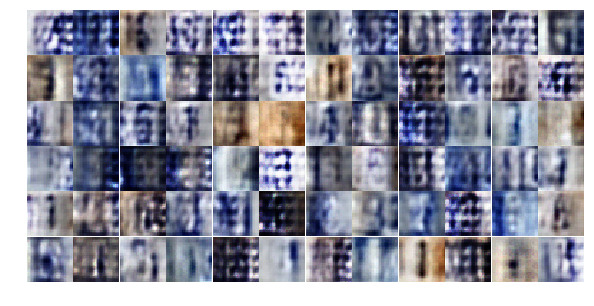

Epoch 3/25... Discriminator Loss: 0.7282... Generator Loss: 2.4390
Epoch 3/25... Discriminator Loss: 1.1182... Generator Loss: 1.6948
Epoch 3/25... Discriminator Loss: 0.7692... Generator Loss: 1.2936
Epoch 3/25... Discriminator Loss: 0.5525... Generator Loss: 1.4054
Epoch 3/25... Discriminator Loss: 1.3014... Generator Loss: 0.4414
Epoch 3/25... Discriminator Loss: 0.6406... Generator Loss: 2.5753
Epoch 3/25... Discriminator Loss: 1.1104... Generator Loss: 0.5746
Epoch 3/25... Discriminator Loss: 0.5153... Generator Loss: 2.4455
Epoch 3/25... Discriminator Loss: 0.5193... Generator Loss: 1.6237
Epoch 3/25... Discriminator Loss: 0.4490... Generator Loss: 1.6553


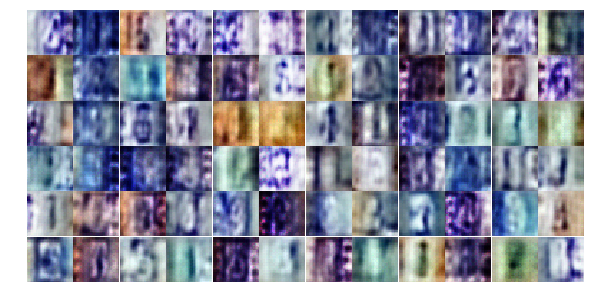

Epoch 3/25... Discriminator Loss: 0.4364... Generator Loss: 2.1372
Epoch 3/25... Discriminator Loss: 0.4255... Generator Loss: 3.1717
Epoch 3/25... Discriminator Loss: 0.7682... Generator Loss: 2.4785
Epoch 3/25... Discriminator Loss: 0.2817... Generator Loss: 1.8717
Epoch 3/25... Discriminator Loss: 0.6625... Generator Loss: 1.2750
Epoch 3/25... Discriminator Loss: 0.7531... Generator Loss: 2.7934
Epoch 3/25... Discriminator Loss: 0.9156... Generator Loss: 0.8938
Epoch 3/25... Discriminator Loss: 0.4797... Generator Loss: 2.0436
Epoch 3/25... Discriminator Loss: 0.9269... Generator Loss: 2.9363
Epoch 3/25... Discriminator Loss: 0.7288... Generator Loss: 0.9866


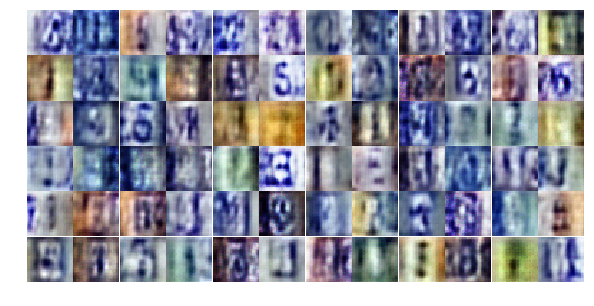

Epoch 3/25... Discriminator Loss: 0.7769... Generator Loss: 1.7134
Epoch 3/25... Discriminator Loss: 0.5808... Generator Loss: 1.9133
Epoch 3/25... Discriminator Loss: 0.3928... Generator Loss: 1.9746
Epoch 3/25... Discriminator Loss: 0.2912... Generator Loss: 2.0621
Epoch 3/25... Discriminator Loss: 0.7681... Generator Loss: 1.9966
Epoch 3/25... Discriminator Loss: 0.5215... Generator Loss: 1.3448
Epoch 3/25... Discriminator Loss: 0.8626... Generator Loss: 0.8740
Epoch 3/25... Discriminator Loss: 0.7608... Generator Loss: 1.3096
Epoch 3/25... Discriminator Loss: 0.7921... Generator Loss: 0.9858
Epoch 3/25... Discriminator Loss: 0.4763... Generator Loss: 1.7619


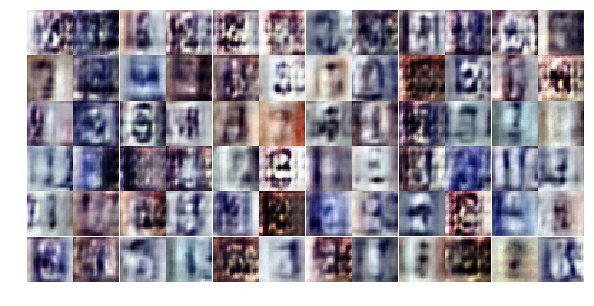

Epoch 3/25... Discriminator Loss: 1.2449... Generator Loss: 0.5254
Epoch 3/25... Discriminator Loss: 0.5984... Generator Loss: 1.3604
Epoch 3/25... Discriminator Loss: 0.7941... Generator Loss: 0.8809
Epoch 3/25... Discriminator Loss: 0.7733... Generator Loss: 1.5745
Epoch 3/25... Discriminator Loss: 0.7752... Generator Loss: 1.0321
Epoch 3/25... Discriminator Loss: 0.5338... Generator Loss: 2.1370
Epoch 3/25... Discriminator Loss: 0.6575... Generator Loss: 2.2666
Epoch 3/25... Discriminator Loss: 0.3980... Generator Loss: 1.9913
Epoch 3/25... Discriminator Loss: 0.3765... Generator Loss: 1.7766
Epoch 3/25... Discriminator Loss: 0.8176... Generator Loss: 0.7979


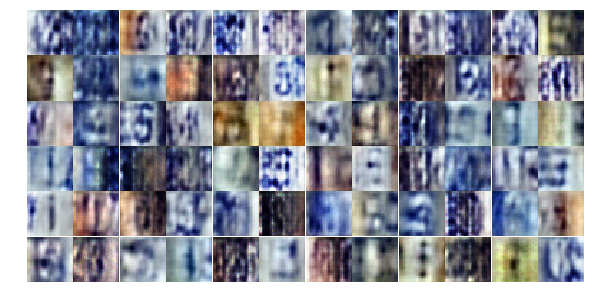

Epoch 3/25... Discriminator Loss: 0.7996... Generator Loss: 0.9270
Epoch 4/25... Discriminator Loss: 0.9277... Generator Loss: 0.8100
Epoch 4/25... Discriminator Loss: 0.4012... Generator Loss: 2.0646
Epoch 4/25... Discriminator Loss: 0.8424... Generator Loss: 0.8308
Epoch 4/25... Discriminator Loss: 0.3913... Generator Loss: 1.7213
Epoch 4/25... Discriminator Loss: 0.4732... Generator Loss: 1.5522
Epoch 4/25... Discriminator Loss: 0.6564... Generator Loss: 1.4814
Epoch 4/25... Discriminator Loss: 0.9390... Generator Loss: 1.2687
Epoch 4/25... Discriminator Loss: 1.3290... Generator Loss: 3.1258
Epoch 4/25... Discriminator Loss: 0.7489... Generator Loss: 1.6714


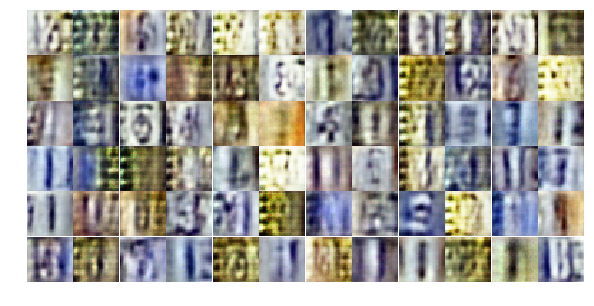

Epoch 4/25... Discriminator Loss: 0.3893... Generator Loss: 1.8979
Epoch 4/25... Discriminator Loss: 0.8085... Generator Loss: 0.9213
Epoch 4/25... Discriminator Loss: 0.8108... Generator Loss: 0.9400
Epoch 4/25... Discriminator Loss: 0.6347... Generator Loss: 1.6562
Epoch 4/25... Discriminator Loss: 0.9673... Generator Loss: 2.6456
Epoch 4/25... Discriminator Loss: 1.6063... Generator Loss: 0.3659
Epoch 4/25... Discriminator Loss: 0.6894... Generator Loss: 2.9409
Epoch 4/25... Discriminator Loss: 1.0313... Generator Loss: 0.5876
Epoch 4/25... Discriminator Loss: 1.2211... Generator Loss: 2.6636
Epoch 4/25... Discriminator Loss: 0.8352... Generator Loss: 2.7403


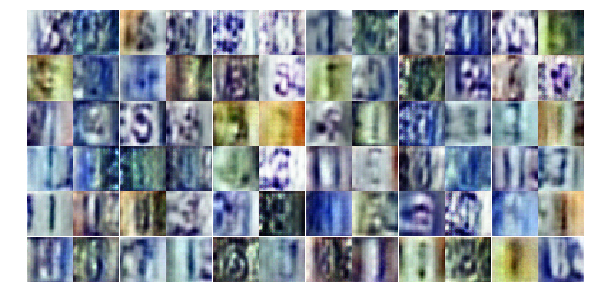

Epoch 4/25... Discriminator Loss: 0.4458... Generator Loss: 1.5578
Epoch 4/25... Discriminator Loss: 0.5576... Generator Loss: 1.3074
Epoch 4/25... Discriminator Loss: 0.5820... Generator Loss: 1.2038
Epoch 4/25... Discriminator Loss: 1.1511... Generator Loss: 0.5289
Epoch 4/25... Discriminator Loss: 0.5617... Generator Loss: 1.3197
Epoch 4/25... Discriminator Loss: 0.3552... Generator Loss: 2.4780
Epoch 4/25... Discriminator Loss: 0.2867... Generator Loss: 2.1486
Epoch 4/25... Discriminator Loss: 0.4606... Generator Loss: 1.9954
Epoch 4/25... Discriminator Loss: 0.7390... Generator Loss: 1.4003
Epoch 4/25... Discriminator Loss: 0.6797... Generator Loss: 1.1482


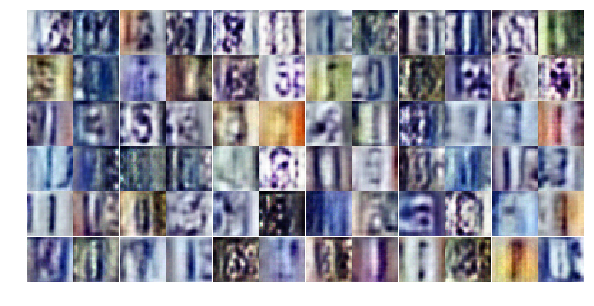

Epoch 4/25... Discriminator Loss: 0.4998... Generator Loss: 1.6077
Epoch 4/25... Discriminator Loss: 0.6736... Generator Loss: 0.9812
Epoch 4/25... Discriminator Loss: 0.6544... Generator Loss: 1.2666
Epoch 4/25... Discriminator Loss: 0.4666... Generator Loss: 1.8161
Epoch 4/25... Discriminator Loss: 0.3663... Generator Loss: 2.0431
Epoch 4/25... Discriminator Loss: 0.3698... Generator Loss: 2.1026
Epoch 4/25... Discriminator Loss: 0.5621... Generator Loss: 1.1886
Epoch 4/25... Discriminator Loss: 0.3946... Generator Loss: 1.4910
Epoch 4/25... Discriminator Loss: 0.7615... Generator Loss: 0.9443
Epoch 4/25... Discriminator Loss: 0.9063... Generator Loss: 1.8930


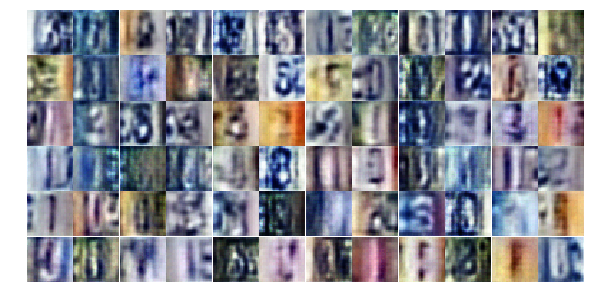

Epoch 4/25... Discriminator Loss: 0.5796... Generator Loss: 1.3332
Epoch 4/25... Discriminator Loss: 0.3714... Generator Loss: 1.7226
Epoch 4/25... Discriminator Loss: 0.6287... Generator Loss: 1.4630
Epoch 4/25... Discriminator Loss: 0.5635... Generator Loss: 1.4551
Epoch 4/25... Discriminator Loss: 0.5879... Generator Loss: 1.2066
Epoch 4/25... Discriminator Loss: 0.6742... Generator Loss: 1.2744
Epoch 4/25... Discriminator Loss: 0.3363... Generator Loss: 2.1216
Epoch 4/25... Discriminator Loss: 0.6663... Generator Loss: 1.2781
Epoch 4/25... Discriminator Loss: 0.9438... Generator Loss: 0.6822
Epoch 4/25... Discriminator Loss: 0.7514... Generator Loss: 1.0203


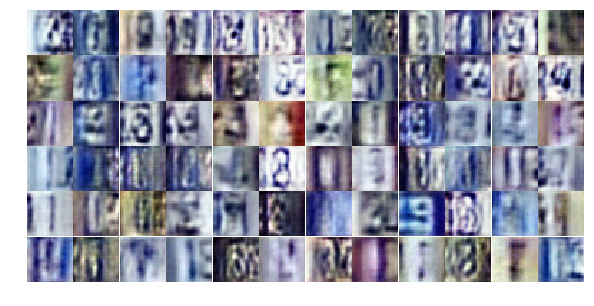

Epoch 4/25... Discriminator Loss: 0.4579... Generator Loss: 1.5489
Epoch 4/25... Discriminator Loss: 0.5470... Generator Loss: 2.5844
Epoch 4/25... Discriminator Loss: 0.3918... Generator Loss: 2.3045
Epoch 4/25... Discriminator Loss: 1.3964... Generator Loss: 4.2188
Epoch 4/25... Discriminator Loss: 0.5889... Generator Loss: 1.3548
Epoch 4/25... Discriminator Loss: 0.5574... Generator Loss: 1.6071
Epoch 4/25... Discriminator Loss: 0.7814... Generator Loss: 0.8254
Epoch 4/25... Discriminator Loss: 0.7784... Generator Loss: 0.9759
Epoch 4/25... Discriminator Loss: 0.4571... Generator Loss: 1.6273
Epoch 5/25... Discriminator Loss: 0.5201... Generator Loss: 1.4555


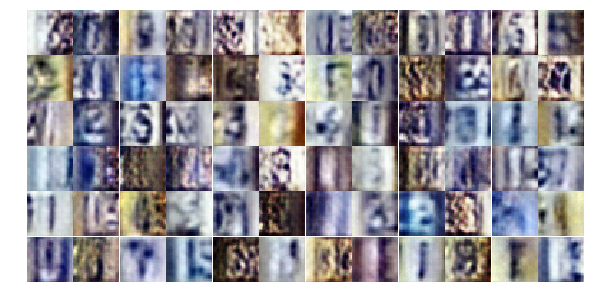

Epoch 5/25... Discriminator Loss: 0.4240... Generator Loss: 1.7335
Epoch 5/25... Discriminator Loss: 1.0852... Generator Loss: 0.7550
Epoch 5/25... Discriminator Loss: 0.6387... Generator Loss: 1.3232
Epoch 5/25... Discriminator Loss: 0.4496... Generator Loss: 1.4281
Epoch 5/25... Discriminator Loss: 0.3851... Generator Loss: 1.9838
Epoch 5/25... Discriminator Loss: 0.7521... Generator Loss: 0.8691
Epoch 5/25... Discriminator Loss: 0.5388... Generator Loss: 1.2099
Epoch 5/25... Discriminator Loss: 0.4047... Generator Loss: 1.8859
Epoch 5/25... Discriminator Loss: 0.7155... Generator Loss: 0.9043
Epoch 5/25... Discriminator Loss: 0.8233... Generator Loss: 1.3953


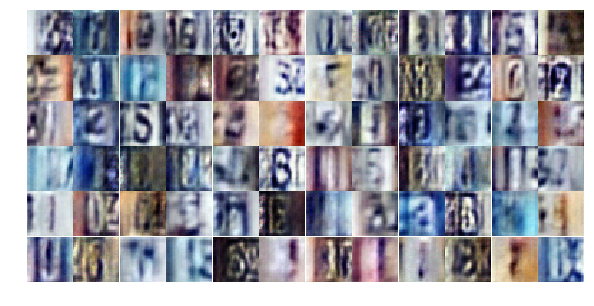

Epoch 5/25... Discriminator Loss: 0.6521... Generator Loss: 1.0442
Epoch 5/25... Discriminator Loss: 0.4695... Generator Loss: 1.4135
Epoch 5/25... Discriminator Loss: 1.0401... Generator Loss: 0.5381
Epoch 5/25... Discriminator Loss: 1.5235... Generator Loss: 0.4054
Epoch 5/25... Discriminator Loss: 0.4578... Generator Loss: 1.8087
Epoch 5/25... Discriminator Loss: 0.7964... Generator Loss: 0.8793
Epoch 5/25... Discriminator Loss: 0.5775... Generator Loss: 1.3445
Epoch 5/25... Discriminator Loss: 0.6579... Generator Loss: 1.0101
Epoch 5/25... Discriminator Loss: 0.3589... Generator Loss: 1.6337
Epoch 5/25... Discriminator Loss: 0.3265... Generator Loss: 1.9126


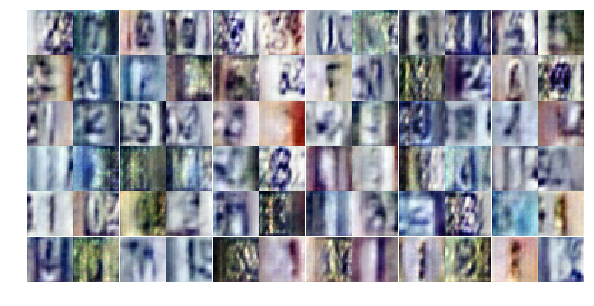

Epoch 5/25... Discriminator Loss: 0.6156... Generator Loss: 1.0772
Epoch 5/25... Discriminator Loss: 0.5641... Generator Loss: 1.2635
Epoch 5/25... Discriminator Loss: 0.5321... Generator Loss: 1.4102
Epoch 5/25... Discriminator Loss: 0.5617... Generator Loss: 1.3795
Epoch 5/25... Discriminator Loss: 1.2802... Generator Loss: 0.4383
Epoch 5/25... Discriminator Loss: 0.8313... Generator Loss: 0.7897
Epoch 5/25... Discriminator Loss: 1.1546... Generator Loss: 0.5002
Epoch 5/25... Discriminator Loss: 0.7523... Generator Loss: 0.9619
Epoch 5/25... Discriminator Loss: 1.0346... Generator Loss: 0.6336
Epoch 5/25... Discriminator Loss: 0.4009... Generator Loss: 1.7047


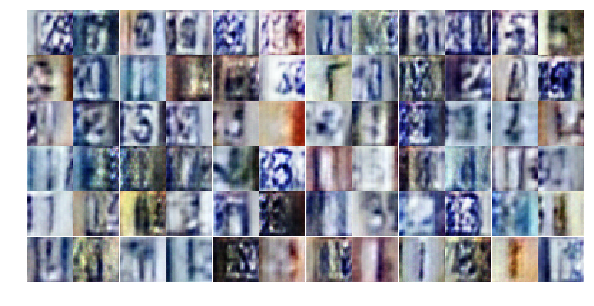

Epoch 5/25... Discriminator Loss: 0.5180... Generator Loss: 1.7593
Epoch 5/25... Discriminator Loss: 0.6579... Generator Loss: 1.0204
Epoch 5/25... Discriminator Loss: 0.4716... Generator Loss: 1.8616
Epoch 5/25... Discriminator Loss: 0.3866... Generator Loss: 2.3786
Epoch 5/25... Discriminator Loss: 0.6092... Generator Loss: 1.8265
Epoch 5/25... Discriminator Loss: 0.4482... Generator Loss: 2.0560
Epoch 5/25... Discriminator Loss: 0.7362... Generator Loss: 0.8910
Epoch 5/25... Discriminator Loss: 0.6277... Generator Loss: 1.0538
Epoch 5/25... Discriminator Loss: 0.6362... Generator Loss: 1.0388
Epoch 5/25... Discriminator Loss: 0.5919... Generator Loss: 1.1094


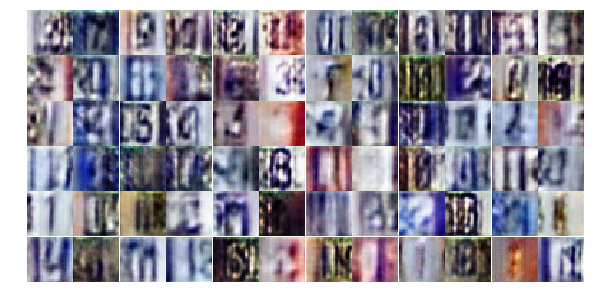

Epoch 5/25... Discriminator Loss: 0.4538... Generator Loss: 1.8154
Epoch 5/25... Discriminator Loss: 0.9665... Generator Loss: 0.5980
Epoch 5/25... Discriminator Loss: 1.5620... Generator Loss: 0.3450
Epoch 5/25... Discriminator Loss: 0.6998... Generator Loss: 1.2915
Epoch 5/25... Discriminator Loss: 0.6893... Generator Loss: 1.2190
Epoch 5/25... Discriminator Loss: 0.7761... Generator Loss: 1.8938
Epoch 5/25... Discriminator Loss: 0.6211... Generator Loss: 1.1663
Epoch 5/25... Discriminator Loss: 0.7114... Generator Loss: 0.9819
Epoch 5/25... Discriminator Loss: 0.5628... Generator Loss: 1.9559
Epoch 5/25... Discriminator Loss: 0.5929... Generator Loss: 2.1247


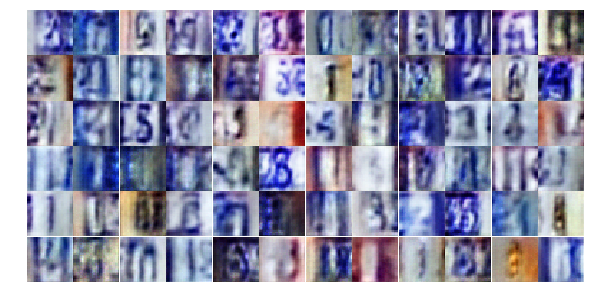

Epoch 5/25... Discriminator Loss: 1.2249... Generator Loss: 2.2268
Epoch 5/25... Discriminator Loss: 0.6732... Generator Loss: 1.0492
Epoch 5/25... Discriminator Loss: 0.8660... Generator Loss: 0.7882
Epoch 5/25... Discriminator Loss: 0.8061... Generator Loss: 0.8303
Epoch 5/25... Discriminator Loss: 0.4905... Generator Loss: 2.0909
Epoch 5/25... Discriminator Loss: 0.6071... Generator Loss: 1.2912
Epoch 6/25... Discriminator Loss: 0.8094... Generator Loss: 0.7815
Epoch 6/25... Discriminator Loss: 0.5818... Generator Loss: 1.1643
Epoch 6/25... Discriminator Loss: 0.5278... Generator Loss: 2.1638
Epoch 6/25... Discriminator Loss: 0.5658... Generator Loss: 1.2051


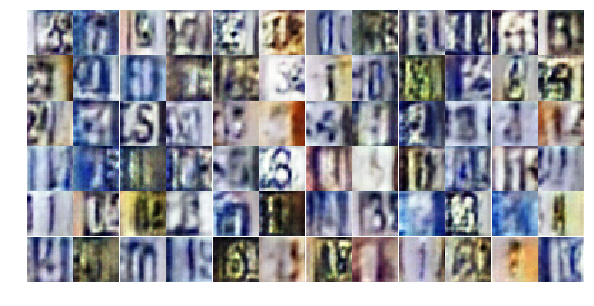

Epoch 6/25... Discriminator Loss: 0.5981... Generator Loss: 1.0807
Epoch 6/25... Discriminator Loss: 1.8361... Generator Loss: 0.3064
Epoch 6/25... Discriminator Loss: 0.7369... Generator Loss: 1.1593
Epoch 6/25... Discriminator Loss: 0.7553... Generator Loss: 1.1371
Epoch 6/25... Discriminator Loss: 1.1073... Generator Loss: 0.5200
Epoch 6/25... Discriminator Loss: 1.3427... Generator Loss: 0.3825
Epoch 6/25... Discriminator Loss: 0.3962... Generator Loss: 1.8316
Epoch 6/25... Discriminator Loss: 1.1639... Generator Loss: 0.4646
Epoch 6/25... Discriminator Loss: 0.7200... Generator Loss: 1.2711
Epoch 6/25... Discriminator Loss: 0.6010... Generator Loss: 1.5831


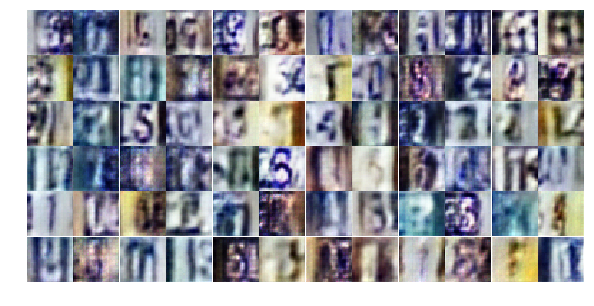

Epoch 6/25... Discriminator Loss: 0.4891... Generator Loss: 1.4998
Epoch 6/25... Discriminator Loss: 0.6282... Generator Loss: 1.1134
Epoch 6/25... Discriminator Loss: 0.7365... Generator Loss: 0.8583
Epoch 6/25... Discriminator Loss: 0.7386... Generator Loss: 1.0326
Epoch 6/25... Discriminator Loss: 0.9876... Generator Loss: 3.1256
Epoch 6/25... Discriminator Loss: 0.7835... Generator Loss: 2.6267
Epoch 6/25... Discriminator Loss: 0.5800... Generator Loss: 1.5245
Epoch 6/25... Discriminator Loss: 0.8332... Generator Loss: 0.8152
Epoch 6/25... Discriminator Loss: 0.5492... Generator Loss: 1.5348
Epoch 6/25... Discriminator Loss: 0.6032... Generator Loss: 1.5184


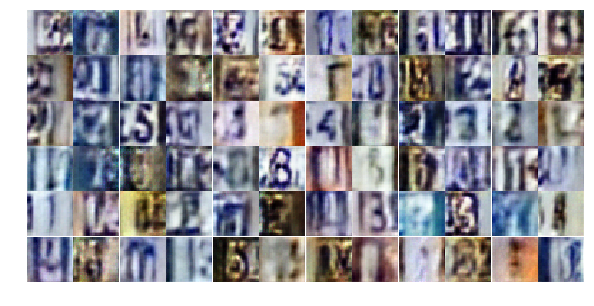

Epoch 6/25... Discriminator Loss: 0.5259... Generator Loss: 1.4670
Epoch 6/25... Discriminator Loss: 0.7075... Generator Loss: 1.4901
Epoch 6/25... Discriminator Loss: 0.6131... Generator Loss: 1.4172
Epoch 6/25... Discriminator Loss: 0.8169... Generator Loss: 0.7790
Epoch 6/25... Discriminator Loss: 0.4404... Generator Loss: 2.0365
Epoch 6/25... Discriminator Loss: 1.2352... Generator Loss: 0.4928
Epoch 6/25... Discriminator Loss: 0.5300... Generator Loss: 1.1999
Epoch 6/25... Discriminator Loss: 0.4056... Generator Loss: 1.4568
Epoch 6/25... Discriminator Loss: 0.4277... Generator Loss: 1.5480
Epoch 6/25... Discriminator Loss: 0.3962... Generator Loss: 1.8241


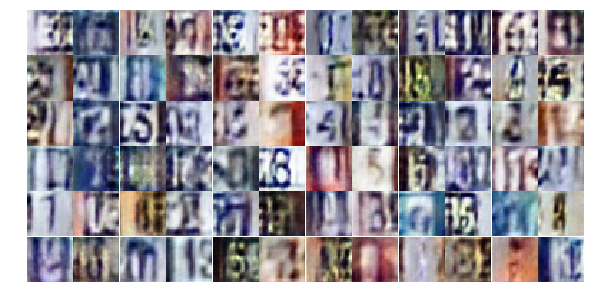

Epoch 6/25... Discriminator Loss: 1.5426... Generator Loss: 0.3246
Epoch 6/25... Discriminator Loss: 1.7314... Generator Loss: 3.6765
Epoch 6/25... Discriminator Loss: 0.7486... Generator Loss: 0.9675
Epoch 6/25... Discriminator Loss: 0.6279... Generator Loss: 1.1285
Epoch 6/25... Discriminator Loss: 0.9877... Generator Loss: 0.6304
Epoch 6/25... Discriminator Loss: 0.6651... Generator Loss: 1.0979
Epoch 6/25... Discriminator Loss: 0.5731... Generator Loss: 1.7393
Epoch 6/25... Discriminator Loss: 0.6988... Generator Loss: 1.3613
Epoch 6/25... Discriminator Loss: 0.7028... Generator Loss: 1.2924
Epoch 6/25... Discriminator Loss: 0.6259... Generator Loss: 1.0147


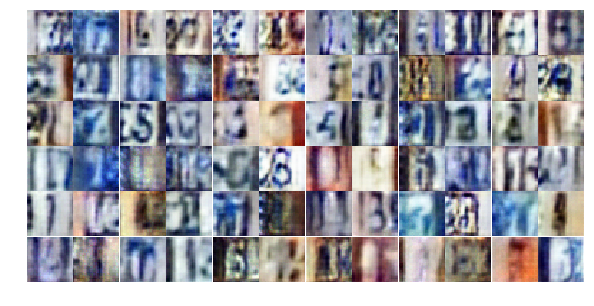

Epoch 6/25... Discriminator Loss: 0.6637... Generator Loss: 0.9725
Epoch 6/25... Discriminator Loss: 0.5361... Generator Loss: 1.4421
Epoch 6/25... Discriminator Loss: 1.0342... Generator Loss: 0.6166
Epoch 6/25... Discriminator Loss: 0.6248... Generator Loss: 1.7967
Epoch 6/25... Discriminator Loss: 0.4886... Generator Loss: 1.4524
Epoch 6/25... Discriminator Loss: 0.6306... Generator Loss: 1.0257
Epoch 6/25... Discriminator Loss: 0.7996... Generator Loss: 0.8184
Epoch 6/25... Discriminator Loss: 1.1606... Generator Loss: 0.4527
Epoch 6/25... Discriminator Loss: 1.1273... Generator Loss: 0.5749
Epoch 6/25... Discriminator Loss: 1.4443... Generator Loss: 0.3680


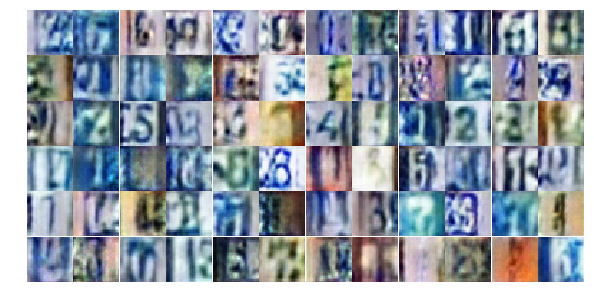

Epoch 6/25... Discriminator Loss: 0.5711... Generator Loss: 1.2396
Epoch 6/25... Discriminator Loss: 0.4691... Generator Loss: 1.6395
Epoch 6/25... Discriminator Loss: 0.5376... Generator Loss: 1.2907
Epoch 7/25... Discriminator Loss: 0.5199... Generator Loss: 1.4088
Epoch 7/25... Discriminator Loss: 0.5552... Generator Loss: 1.5311
Epoch 7/25... Discriminator Loss: 0.8129... Generator Loss: 0.8227
Epoch 7/25... Discriminator Loss: 0.3887... Generator Loss: 1.7761
Epoch 7/25... Discriminator Loss: 0.4772... Generator Loss: 1.7128
Epoch 7/25... Discriminator Loss: 0.6110... Generator Loss: 2.4367
Epoch 7/25... Discriminator Loss: 1.7393... Generator Loss: 0.2673


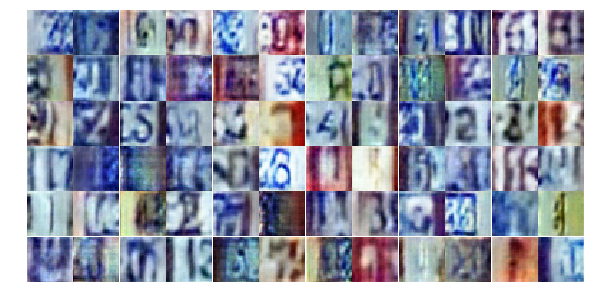

Epoch 7/25... Discriminator Loss: 0.8518... Generator Loss: 2.1041
Epoch 7/25... Discriminator Loss: 0.7112... Generator Loss: 0.9651
Epoch 7/25... Discriminator Loss: 0.6998... Generator Loss: 1.0107
Epoch 7/25... Discriminator Loss: 0.5566... Generator Loss: 1.5145
Epoch 7/25... Discriminator Loss: 0.4512... Generator Loss: 1.3688
Epoch 7/25... Discriminator Loss: 0.3966... Generator Loss: 1.7701
Epoch 7/25... Discriminator Loss: 0.9317... Generator Loss: 2.6870
Epoch 7/25... Discriminator Loss: 1.6389... Generator Loss: 3.3769
Epoch 7/25... Discriminator Loss: 0.6920... Generator Loss: 2.2504
Epoch 7/25... Discriminator Loss: 0.6347... Generator Loss: 1.1376


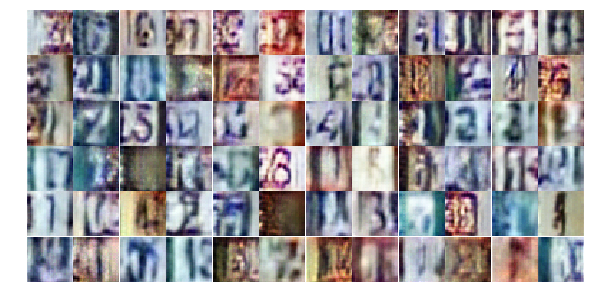

Epoch 7/25... Discriminator Loss: 0.5650... Generator Loss: 1.6314
Epoch 7/25... Discriminator Loss: 0.4761... Generator Loss: 2.2538
Epoch 7/25... Discriminator Loss: 0.8517... Generator Loss: 0.7969
Epoch 7/25... Discriminator Loss: 0.6719... Generator Loss: 1.1124
Epoch 7/25... Discriminator Loss: 0.5516... Generator Loss: 1.4117
Epoch 7/25... Discriminator Loss: 0.4741... Generator Loss: 1.3284
Epoch 7/25... Discriminator Loss: 0.6712... Generator Loss: 0.9690
Epoch 7/25... Discriminator Loss: 1.1394... Generator Loss: 0.5335
Epoch 7/25... Discriminator Loss: 0.3626... Generator Loss: 2.0530
Epoch 7/25... Discriminator Loss: 0.4092... Generator Loss: 1.9089


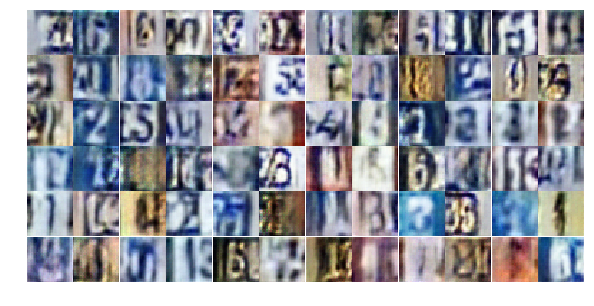

Epoch 7/25... Discriminator Loss: 1.0868... Generator Loss: 0.5282
Epoch 7/25... Discriminator Loss: 1.5555... Generator Loss: 0.3599
Epoch 7/25... Discriminator Loss: 0.4806... Generator Loss: 1.4562
Epoch 7/25... Discriminator Loss: 0.5084... Generator Loss: 1.3900
Epoch 7/25... Discriminator Loss: 0.6850... Generator Loss: 0.9712
Epoch 7/25... Discriminator Loss: 0.8356... Generator Loss: 0.7708
Epoch 7/25... Discriminator Loss: 0.4487... Generator Loss: 1.5223
Epoch 7/25... Discriminator Loss: 0.9700... Generator Loss: 0.6458
Epoch 7/25... Discriminator Loss: 0.6881... Generator Loss: 1.1955
Epoch 7/25... Discriminator Loss: 0.4028... Generator Loss: 1.9461


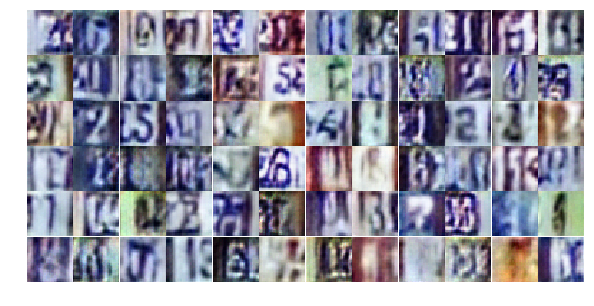

Epoch 7/25... Discriminator Loss: 0.9762... Generator Loss: 0.6627
Epoch 7/25... Discriminator Loss: 0.6924... Generator Loss: 1.2099
Epoch 7/25... Discriminator Loss: 0.3861... Generator Loss: 1.6321
Epoch 7/25... Discriminator Loss: 0.6266... Generator Loss: 1.5049
Epoch 7/25... Discriminator Loss: 1.6759... Generator Loss: 3.8379
Epoch 7/25... Discriminator Loss: 0.5199... Generator Loss: 1.3058
Epoch 7/25... Discriminator Loss: 0.6776... Generator Loss: 0.9532
Epoch 7/25... Discriminator Loss: 0.8121... Generator Loss: 0.8566
Epoch 7/25... Discriminator Loss: 0.2927... Generator Loss: 1.9882
Epoch 7/25... Discriminator Loss: 1.3164... Generator Loss: 0.4085


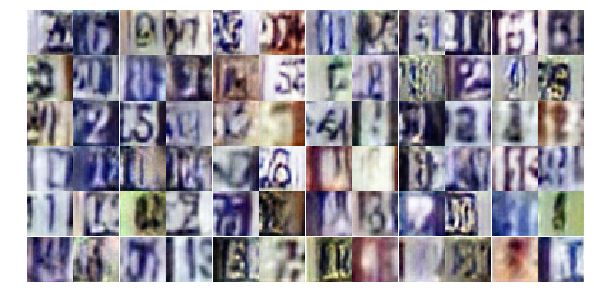

Epoch 7/25... Discriminator Loss: 0.6817... Generator Loss: 3.3145
Epoch 7/25... Discriminator Loss: 0.8863... Generator Loss: 0.8274
Epoch 7/25... Discriminator Loss: 0.6983... Generator Loss: 0.9985
Epoch 7/25... Discriminator Loss: 0.6831... Generator Loss: 1.0638
Epoch 7/25... Discriminator Loss: 0.5704... Generator Loss: 1.2419
Epoch 7/25... Discriminator Loss: 0.5777... Generator Loss: 1.5779
Epoch 7/25... Discriminator Loss: 1.9546... Generator Loss: 0.2047
Epoch 7/25... Discriminator Loss: 0.7410... Generator Loss: 1.0820
Epoch 7/25... Discriminator Loss: 1.0202... Generator Loss: 0.6520
Epoch 7/25... Discriminator Loss: 0.5917... Generator Loss: 1.2151


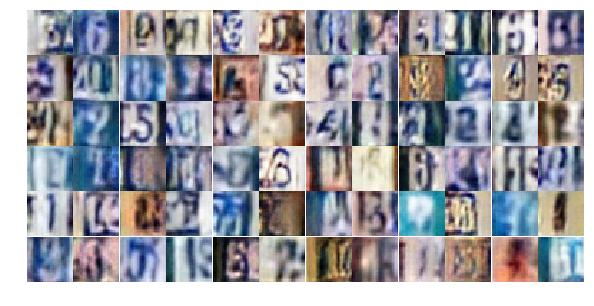

Epoch 7/25... Discriminator Loss: 0.4555... Generator Loss: 1.7465
Epoch 8/25... Discriminator Loss: 0.6827... Generator Loss: 0.9776
Epoch 8/25... Discriminator Loss: 0.6467... Generator Loss: 1.1132
Epoch 8/25... Discriminator Loss: 0.6000... Generator Loss: 1.2891
Epoch 8/25... Discriminator Loss: 0.4230... Generator Loss: 1.7935
Epoch 8/25... Discriminator Loss: 0.8042... Generator Loss: 1.5619
Epoch 8/25... Discriminator Loss: 0.6803... Generator Loss: 1.0969
Epoch 8/25... Discriminator Loss: 0.6846... Generator Loss: 2.8254
Epoch 8/25... Discriminator Loss: 1.2879... Generator Loss: 0.4476
Epoch 8/25... Discriminator Loss: 0.7071... Generator Loss: 1.4222


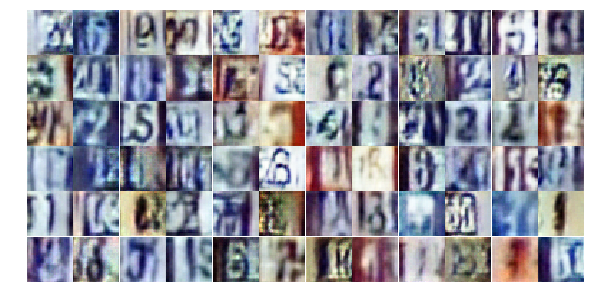

Epoch 8/25... Discriminator Loss: 0.5053... Generator Loss: 1.7779
Epoch 8/25... Discriminator Loss: 0.5115... Generator Loss: 1.2487
Epoch 8/25... Discriminator Loss: 0.6094... Generator Loss: 1.1004
Epoch 8/25... Discriminator Loss: 0.5836... Generator Loss: 2.8592
Epoch 8/25... Discriminator Loss: 1.3848... Generator Loss: 0.4075
Epoch 8/25... Discriminator Loss: 0.5301... Generator Loss: 1.5719
Epoch 8/25... Discriminator Loss: 0.3425... Generator Loss: 2.2665
Epoch 8/25... Discriminator Loss: 0.5001... Generator Loss: 1.9749
Epoch 8/25... Discriminator Loss: 0.8071... Generator Loss: 0.8322
Epoch 8/25... Discriminator Loss: 1.3641... Generator Loss: 0.3975


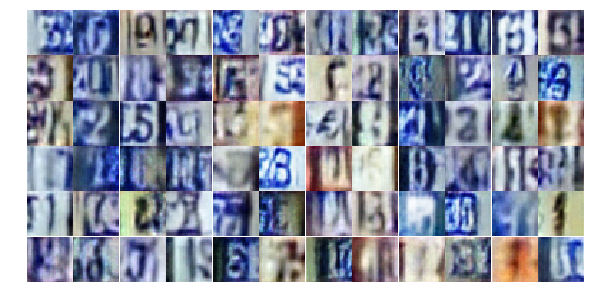

Epoch 8/25... Discriminator Loss: 0.5082... Generator Loss: 1.3177
Epoch 8/25... Discriminator Loss: 0.5164... Generator Loss: 1.2599
Epoch 8/25... Discriminator Loss: 0.6572... Generator Loss: 1.0233
Epoch 8/25... Discriminator Loss: 0.5505... Generator Loss: 1.4609
Epoch 8/25... Discriminator Loss: 0.4523... Generator Loss: 1.5388
Epoch 8/25... Discriminator Loss: 0.4889... Generator Loss: 1.3407
Epoch 8/25... Discriminator Loss: 0.5141... Generator Loss: 1.4616
Epoch 8/25... Discriminator Loss: 0.4631... Generator Loss: 1.3597
Epoch 8/25... Discriminator Loss: 0.6554... Generator Loss: 1.8128
Epoch 8/25... Discriminator Loss: 0.7316... Generator Loss: 1.5569


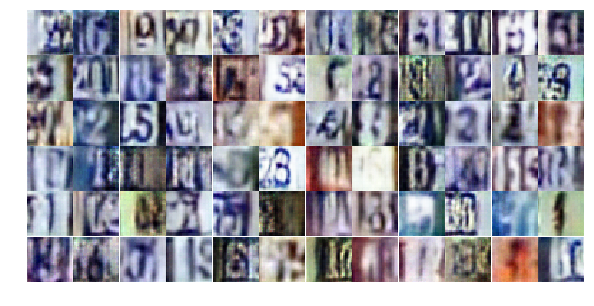

Epoch 8/25... Discriminator Loss: 0.5070... Generator Loss: 1.6199
Epoch 8/25... Discriminator Loss: 0.9893... Generator Loss: 0.6269
Epoch 8/25... Discriminator Loss: 0.6064... Generator Loss: 1.2957
Epoch 8/25... Discriminator Loss: 0.6398... Generator Loss: 0.9997
Epoch 8/25... Discriminator Loss: 1.4630... Generator Loss: 0.3896
Epoch 8/25... Discriminator Loss: 0.4988... Generator Loss: 1.3767
Epoch 8/25... Discriminator Loss: 0.4815... Generator Loss: 1.3931
Epoch 8/25... Discriminator Loss: 0.4405... Generator Loss: 1.4781
Epoch 8/25... Discriminator Loss: 0.6737... Generator Loss: 2.2700
Epoch 8/25... Discriminator Loss: 0.6121... Generator Loss: 1.0855


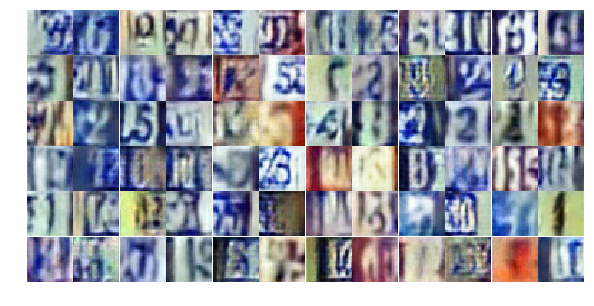

Epoch 8/25... Discriminator Loss: 0.3893... Generator Loss: 1.5751
Epoch 8/25... Discriminator Loss: 0.6948... Generator Loss: 1.0889
Epoch 8/25... Discriminator Loss: 0.5861... Generator Loss: 1.0719
Epoch 8/25... Discriminator Loss: 0.4921... Generator Loss: 1.4174
Epoch 8/25... Discriminator Loss: 0.9882... Generator Loss: 1.7778
Epoch 8/25... Discriminator Loss: 0.6951... Generator Loss: 1.0171
Epoch 8/25... Discriminator Loss: 1.3949... Generator Loss: 0.6016
Epoch 8/25... Discriminator Loss: 0.3983... Generator Loss: 1.9709
Epoch 8/25... Discriminator Loss: 0.6878... Generator Loss: 1.7133
Epoch 8/25... Discriminator Loss: 0.5121... Generator Loss: 1.6868


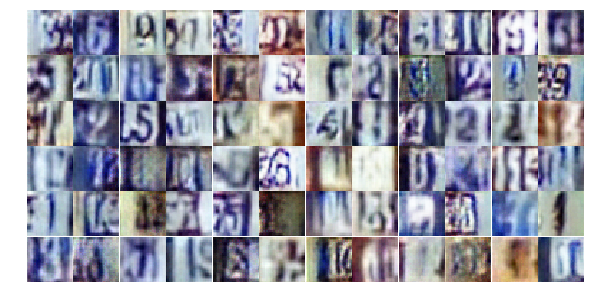

Epoch 8/25... Discriminator Loss: 0.4528... Generator Loss: 1.4108
Epoch 8/25... Discriminator Loss: 0.5406... Generator Loss: 1.2291
Epoch 8/25... Discriminator Loss: 0.6067... Generator Loss: 2.8039
Epoch 8/25... Discriminator Loss: 1.1001... Generator Loss: 0.5991
Epoch 8/25... Discriminator Loss: 0.4941... Generator Loss: 2.1077
Epoch 8/25... Discriminator Loss: 1.2880... Generator Loss: 0.4309
Epoch 8/25... Discriminator Loss: 0.5396... Generator Loss: 1.1995
Epoch 8/25... Discriminator Loss: 0.4844... Generator Loss: 1.4887
Epoch 9/25... Discriminator Loss: 0.8305... Generator Loss: 0.9920
Epoch 9/25... Discriminator Loss: 0.5682... Generator Loss: 1.1790


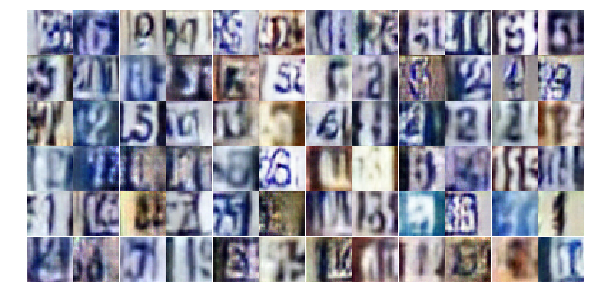

Epoch 9/25... Discriminator Loss: 0.6548... Generator Loss: 1.0773
Epoch 9/25... Discriminator Loss: 0.6345... Generator Loss: 1.0755
Epoch 9/25... Discriminator Loss: 1.0119... Generator Loss: 0.5950
Epoch 9/25... Discriminator Loss: 0.4770... Generator Loss: 1.3360
Epoch 9/25... Discriminator Loss: 1.2256... Generator Loss: 0.4669
Epoch 9/25... Discriminator Loss: 0.9647... Generator Loss: 2.5356
Epoch 9/25... Discriminator Loss: 0.6270... Generator Loss: 1.1572
Epoch 9/25... Discriminator Loss: 0.3433... Generator Loss: 1.8470
Epoch 9/25... Discriminator Loss: 0.7002... Generator Loss: 1.0150
Epoch 9/25... Discriminator Loss: 0.6084... Generator Loss: 1.4415


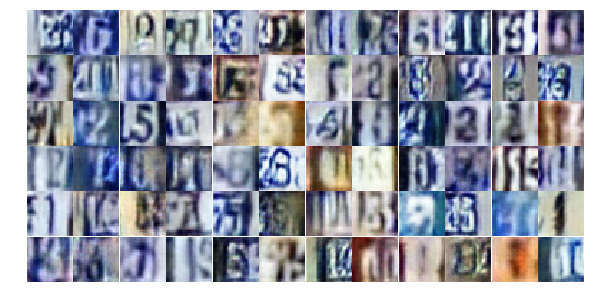

Epoch 9/25... Discriminator Loss: 0.6661... Generator Loss: 0.9834
Epoch 9/25... Discriminator Loss: 0.7006... Generator Loss: 1.3097
Epoch 9/25... Discriminator Loss: 0.6210... Generator Loss: 1.0904
Epoch 9/25... Discriminator Loss: 1.2839... Generator Loss: 0.4683
Epoch 9/25... Discriminator Loss: 0.4233... Generator Loss: 1.8070
Epoch 9/25... Discriminator Loss: 0.7138... Generator Loss: 0.9615
Epoch 9/25... Discriminator Loss: 0.7118... Generator Loss: 0.9524
Epoch 9/25... Discriminator Loss: 0.7171... Generator Loss: 0.9665
Epoch 9/25... Discriminator Loss: 0.8454... Generator Loss: 0.7697
Epoch 9/25... Discriminator Loss: 0.9444... Generator Loss: 0.6163


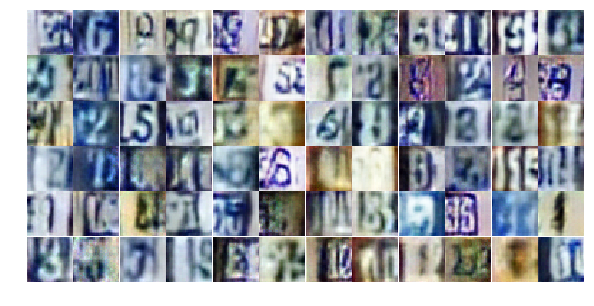

Epoch 9/25... Discriminator Loss: 1.4580... Generator Loss: 0.3940
Epoch 9/25... Discriminator Loss: 1.2509... Generator Loss: 0.4841
Epoch 9/25... Discriminator Loss: 0.6908... Generator Loss: 1.3294
Epoch 9/25... Discriminator Loss: 0.6625... Generator Loss: 1.0141
Epoch 9/25... Discriminator Loss: 0.7172... Generator Loss: 1.0061
Epoch 9/25... Discriminator Loss: 0.4661... Generator Loss: 1.6703
Epoch 9/25... Discriminator Loss: 1.0045... Generator Loss: 0.6197
Epoch 9/25... Discriminator Loss: 0.5882... Generator Loss: 1.7735
Epoch 9/25... Discriminator Loss: 0.4333... Generator Loss: 1.5908
Epoch 9/25... Discriminator Loss: 0.4764... Generator Loss: 1.5264


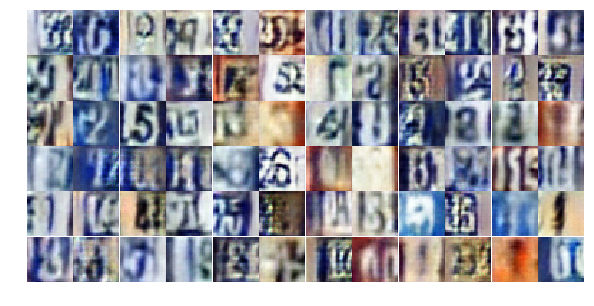

Epoch 9/25... Discriminator Loss: 0.7055... Generator Loss: 0.9339
Epoch 9/25... Discriminator Loss: 0.8496... Generator Loss: 0.7426
Epoch 9/25... Discriminator Loss: 0.4944... Generator Loss: 1.3718
Epoch 9/25... Discriminator Loss: 0.3885... Generator Loss: 1.8607
Epoch 9/25... Discriminator Loss: 0.6741... Generator Loss: 1.0009
Epoch 9/25... Discriminator Loss: 0.6619... Generator Loss: 1.2750
Epoch 9/25... Discriminator Loss: 0.4274... Generator Loss: 1.5222
Epoch 9/25... Discriminator Loss: 0.2890... Generator Loss: 1.9102
Epoch 9/25... Discriminator Loss: 1.0522... Generator Loss: 0.5706
Epoch 9/25... Discriminator Loss: 0.8198... Generator Loss: 2.1603


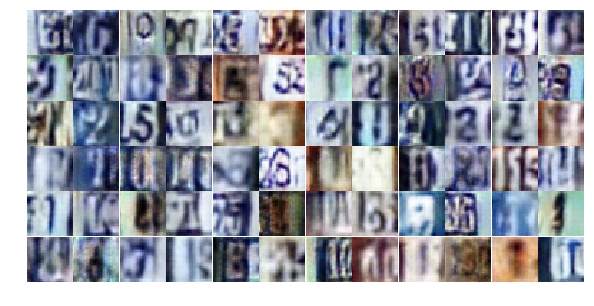

Epoch 9/25... Discriminator Loss: 0.6407... Generator Loss: 1.2231
Epoch 9/25... Discriminator Loss: 0.7207... Generator Loss: 0.9657
Epoch 9/25... Discriminator Loss: 0.7946... Generator Loss: 0.7897
Epoch 9/25... Discriminator Loss: 0.7524... Generator Loss: 0.9575
Epoch 9/25... Discriminator Loss: 0.5221... Generator Loss: 1.3164
Epoch 9/25... Discriminator Loss: 0.6266... Generator Loss: 1.2274
Epoch 9/25... Discriminator Loss: 0.6293... Generator Loss: 1.5517
Epoch 9/25... Discriminator Loss: 0.6558... Generator Loss: 1.0341
Epoch 9/25... Discriminator Loss: 0.4980... Generator Loss: 1.2422
Epoch 9/25... Discriminator Loss: 0.4157... Generator Loss: 2.6521


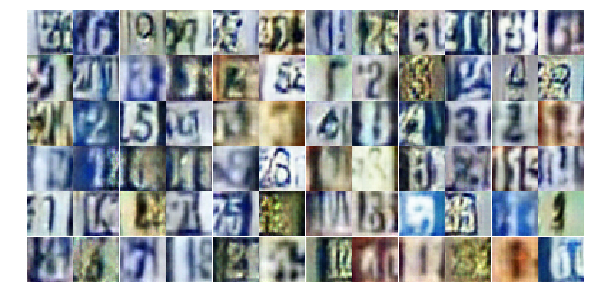

Epoch 9/25... Discriminator Loss: 0.7075... Generator Loss: 1.1468
Epoch 9/25... Discriminator Loss: 0.4915... Generator Loss: 2.4095
Epoch 9/25... Discriminator Loss: 0.6840... Generator Loss: 0.9969
Epoch 9/25... Discriminator Loss: 1.0792... Generator Loss: 0.6081
Epoch 9/25... Discriminator Loss: 0.6318... Generator Loss: 1.0738
Epoch 10/25... Discriminator Loss: 0.7630... Generator Loss: 0.8712
Epoch 10/25... Discriminator Loss: 0.5539... Generator Loss: 1.2518
Epoch 10/25... Discriminator Loss: 0.5822... Generator Loss: 1.1564
Epoch 10/25... Discriminator Loss: 0.9152... Generator Loss: 0.7233
Epoch 10/25... Discriminator Loss: 0.9538... Generator Loss: 0.6688


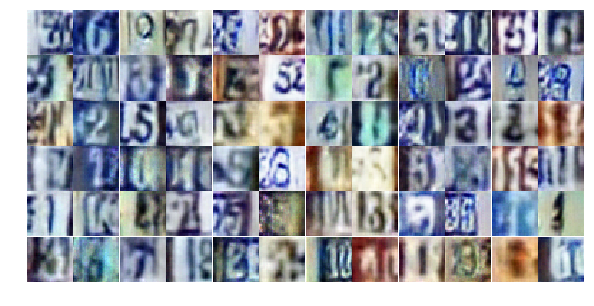

Epoch 10/25... Discriminator Loss: 0.7870... Generator Loss: 0.9047
Epoch 10/25... Discriminator Loss: 0.6907... Generator Loss: 1.1210
Epoch 10/25... Discriminator Loss: 0.6162... Generator Loss: 1.4066
Epoch 10/25... Discriminator Loss: 0.7280... Generator Loss: 1.0140
Epoch 10/25... Discriminator Loss: 0.4698... Generator Loss: 1.5905
Epoch 10/25... Discriminator Loss: 0.6872... Generator Loss: 1.0844
Epoch 10/25... Discriminator Loss: 0.4477... Generator Loss: 1.3604
Epoch 10/25... Discriminator Loss: 1.1243... Generator Loss: 0.5681
Epoch 10/25... Discriminator Loss: 0.7247... Generator Loss: 1.2106
Epoch 10/25... Discriminator Loss: 0.7472... Generator Loss: 0.9784


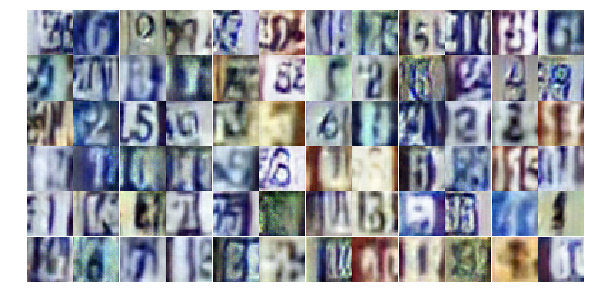

Epoch 10/25... Discriminator Loss: 0.8773... Generator Loss: 1.0390
Epoch 10/25... Discriminator Loss: 0.7286... Generator Loss: 1.0621
Epoch 10/25... Discriminator Loss: 0.6895... Generator Loss: 0.9639
Epoch 10/25... Discriminator Loss: 1.1720... Generator Loss: 0.5052
Epoch 10/25... Discriminator Loss: 0.5861... Generator Loss: 1.1631
Epoch 10/25... Discriminator Loss: 0.4133... Generator Loss: 1.6357
Epoch 10/25... Discriminator Loss: 1.1292... Generator Loss: 0.5451
Epoch 10/25... Discriminator Loss: 0.5055... Generator Loss: 1.4008
Epoch 10/25... Discriminator Loss: 0.7742... Generator Loss: 0.8925
Epoch 10/25... Discriminator Loss: 0.3686... Generator Loss: 1.7087


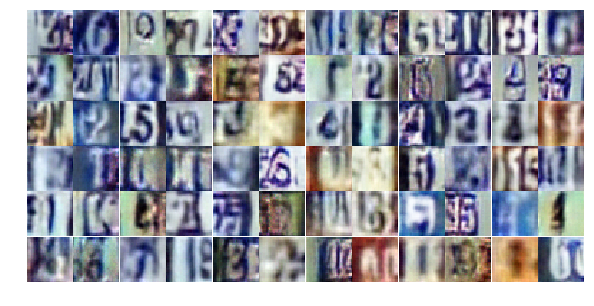

Epoch 10/25... Discriminator Loss: 0.8492... Generator Loss: 0.7372
Epoch 10/25... Discriminator Loss: 0.6759... Generator Loss: 1.1240
Epoch 10/25... Discriminator Loss: 0.3834... Generator Loss: 1.5096
Epoch 10/25... Discriminator Loss: 0.6756... Generator Loss: 3.0940
Epoch 10/25... Discriminator Loss: 1.8136... Generator Loss: 0.2488
Epoch 10/25... Discriminator Loss: 0.6380... Generator Loss: 1.0859
Epoch 10/25... Discriminator Loss: 0.3698... Generator Loss: 1.5618
Epoch 10/25... Discriminator Loss: 0.5380... Generator Loss: 1.3477
Epoch 10/25... Discriminator Loss: 0.7955... Generator Loss: 0.8472
Epoch 10/25... Discriminator Loss: 0.5839... Generator Loss: 1.6097


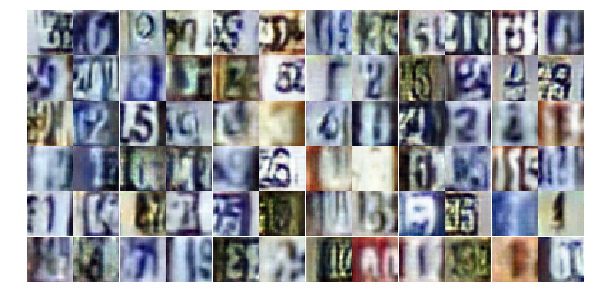

Epoch 10/25... Discriminator Loss: 0.7281... Generator Loss: 0.9165
Epoch 10/25... Discriminator Loss: 0.3361... Generator Loss: 2.2093
Epoch 10/25... Discriminator Loss: 0.4383... Generator Loss: 1.5881
Epoch 10/25... Discriminator Loss: 0.5028... Generator Loss: 1.3740
Epoch 10/25... Discriminator Loss: 0.6709... Generator Loss: 0.9632
Epoch 10/25... Discriminator Loss: 0.5291... Generator Loss: 1.3350
Epoch 10/25... Discriminator Loss: 0.6112... Generator Loss: 1.1721
Epoch 10/25... Discriminator Loss: 1.2594... Generator Loss: 0.5859
Epoch 10/25... Discriminator Loss: 0.7298... Generator Loss: 0.9230
Epoch 10/25... Discriminator Loss: 0.4460... Generator Loss: 1.9879


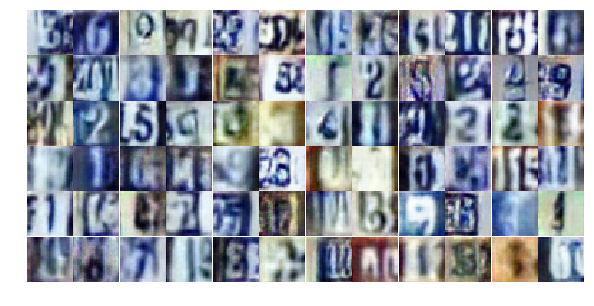

Epoch 10/25... Discriminator Loss: 1.5258... Generator Loss: 0.3627
Epoch 10/25... Discriminator Loss: 1.2647... Generator Loss: 0.5651
Epoch 10/25... Discriminator Loss: 0.8441... Generator Loss: 1.0065
Epoch 10/25... Discriminator Loss: 0.7899... Generator Loss: 0.8305
Epoch 10/25... Discriminator Loss: 0.4698... Generator Loss: 1.7651
Epoch 10/25... Discriminator Loss: 0.8390... Generator Loss: 0.8063
Epoch 10/25... Discriminator Loss: 0.5827... Generator Loss: 1.1314
Epoch 10/25... Discriminator Loss: 0.5781... Generator Loss: 1.1920
Epoch 10/25... Discriminator Loss: 0.7214... Generator Loss: 1.3797
Epoch 10/25... Discriminator Loss: 0.4773... Generator Loss: 1.4989


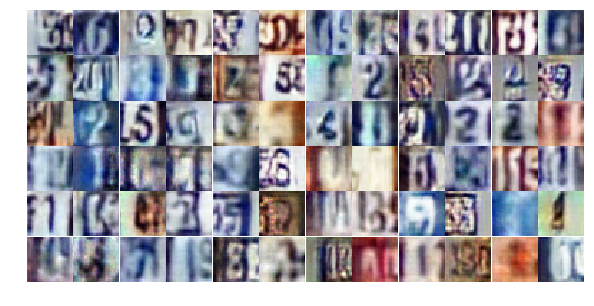

Epoch 10/25... Discriminator Loss: 1.1001... Generator Loss: 0.5545
Epoch 10/25... Discriminator Loss: 0.4546... Generator Loss: 1.4393
Epoch 10/25... Discriminator Loss: 0.5878... Generator Loss: 1.3321
Epoch 11/25... Discriminator Loss: 0.7219... Generator Loss: 1.8557
Epoch 11/25... Discriminator Loss: 0.7729... Generator Loss: 0.8691
Epoch 11/25... Discriminator Loss: 1.0726... Generator Loss: 0.5592
Epoch 11/25... Discriminator Loss: 1.0997... Generator Loss: 0.5364
Epoch 11/25... Discriminator Loss: 0.5579... Generator Loss: 1.3026
Epoch 11/25... Discriminator Loss: 1.2088... Generator Loss: 1.0581
Epoch 11/25... Discriminator Loss: 1.5564... Generator Loss: 0.3484


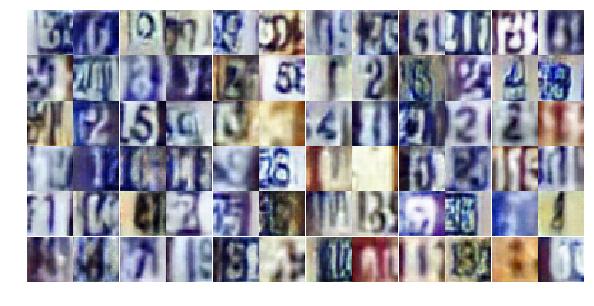

Epoch 11/25... Discriminator Loss: 0.3660... Generator Loss: 2.7259
Epoch 11/25... Discriminator Loss: 0.6933... Generator Loss: 1.0093
Epoch 11/25... Discriminator Loss: 0.5398... Generator Loss: 1.2689
Epoch 11/25... Discriminator Loss: 0.4801... Generator Loss: 1.4959
Epoch 11/25... Discriminator Loss: 0.8506... Generator Loss: 0.8560
Epoch 11/25... Discriminator Loss: 0.3661... Generator Loss: 1.8441
Epoch 11/25... Discriminator Loss: 0.5275... Generator Loss: 1.3695
Epoch 11/25... Discriminator Loss: 0.4705... Generator Loss: 2.7368
Epoch 11/25... Discriminator Loss: 0.7326... Generator Loss: 0.9682
Epoch 11/25... Discriminator Loss: 1.1385... Generator Loss: 0.5932


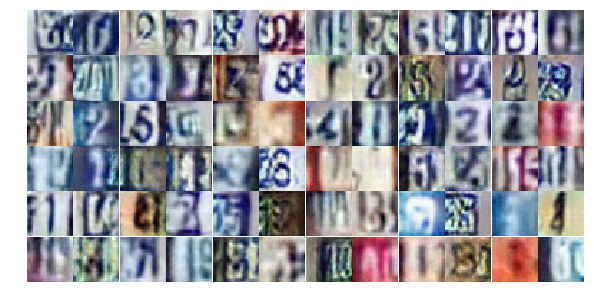

Epoch 11/25... Discriminator Loss: 0.9767... Generator Loss: 0.6286
Epoch 11/25... Discriminator Loss: 0.4295... Generator Loss: 1.8490
Epoch 11/25... Discriminator Loss: 0.8723... Generator Loss: 0.7153
Epoch 11/25... Discriminator Loss: 0.4573... Generator Loss: 1.4104
Epoch 11/25... Discriminator Loss: 0.4000... Generator Loss: 1.5000
Epoch 11/25... Discriminator Loss: 0.3587... Generator Loss: 1.8548
Epoch 11/25... Discriminator Loss: 0.5861... Generator Loss: 1.4230
Epoch 11/25... Discriminator Loss: 1.4864... Generator Loss: 0.4090
Epoch 11/25... Discriminator Loss: 0.3950... Generator Loss: 1.9772
Epoch 11/25... Discriminator Loss: 0.7909... Generator Loss: 0.8268


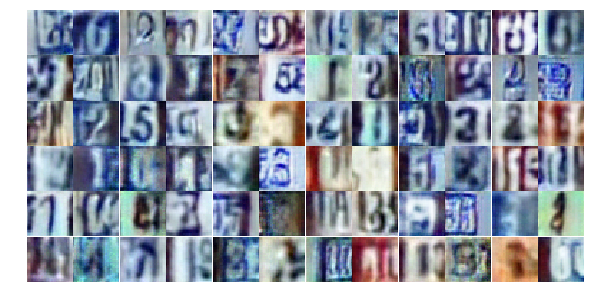

Epoch 11/25... Discriminator Loss: 1.0049... Generator Loss: 0.6274
Epoch 11/25... Discriminator Loss: 0.5964... Generator Loss: 1.1758
Epoch 11/25... Discriminator Loss: 0.5964... Generator Loss: 1.6867
Epoch 11/25... Discriminator Loss: 0.5103... Generator Loss: 1.2438
Epoch 11/25... Discriminator Loss: 0.7554... Generator Loss: 0.8282
Epoch 11/25... Discriminator Loss: 0.6714... Generator Loss: 0.9918
Epoch 11/25... Discriminator Loss: 0.7571... Generator Loss: 1.0201
Epoch 11/25... Discriminator Loss: 0.6945... Generator Loss: 0.9680
Epoch 11/25... Discriminator Loss: 0.5034... Generator Loss: 1.2190
Epoch 11/25... Discriminator Loss: 1.2752... Generator Loss: 0.4144


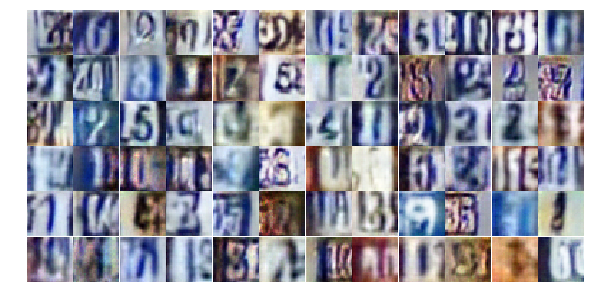

Epoch 11/25... Discriminator Loss: 0.4410... Generator Loss: 1.3918
Epoch 11/25... Discriminator Loss: 0.5158... Generator Loss: 1.2974
Epoch 11/25... Discriminator Loss: 0.5665... Generator Loss: 1.2830
Epoch 11/25... Discriminator Loss: 0.5095... Generator Loss: 1.4206
Epoch 11/25... Discriminator Loss: 0.7469... Generator Loss: 0.8191
Epoch 11/25... Discriminator Loss: 0.6422... Generator Loss: 1.0094
Epoch 11/25... Discriminator Loss: 0.2528... Generator Loss: 2.3232
Epoch 11/25... Discriminator Loss: 0.5953... Generator Loss: 1.0571
Epoch 11/25... Discriminator Loss: 1.2903... Generator Loss: 0.4387
Epoch 11/25... Discriminator Loss: 0.3087... Generator Loss: 1.8777


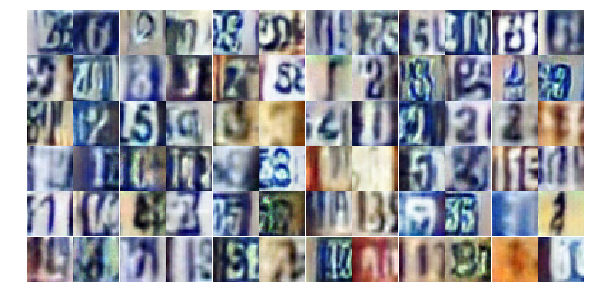

Epoch 11/25... Discriminator Loss: 0.8504... Generator Loss: 0.7700
Epoch 11/25... Discriminator Loss: 0.3684... Generator Loss: 2.4398
Epoch 11/25... Discriminator Loss: 1.3776... Generator Loss: 0.5163
Epoch 11/25... Discriminator Loss: 0.8225... Generator Loss: 0.8064
Epoch 11/25... Discriminator Loss: 0.7666... Generator Loss: 1.1319
Epoch 11/25... Discriminator Loss: 0.8739... Generator Loss: 0.7544
Epoch 11/25... Discriminator Loss: 0.7904... Generator Loss: 0.9412
Epoch 11/25... Discriminator Loss: 0.3728... Generator Loss: 1.6958
Epoch 11/25... Discriminator Loss: 0.8670... Generator Loss: 0.8348
Epoch 11/25... Discriminator Loss: 1.1964... Generator Loss: 0.5842


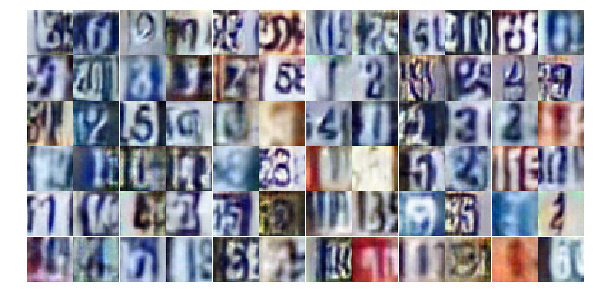

Epoch 12/25... Discriminator Loss: 0.6599... Generator Loss: 1.0140
Epoch 12/25... Discriminator Loss: 0.6128... Generator Loss: 1.0345
Epoch 12/25... Discriminator Loss: 0.9493... Generator Loss: 0.7486
Epoch 12/25... Discriminator Loss: 0.4394... Generator Loss: 1.4258
Epoch 12/25... Discriminator Loss: 0.4499... Generator Loss: 1.3640
Epoch 12/25... Discriminator Loss: 0.8938... Generator Loss: 0.7590
Epoch 12/25... Discriminator Loss: 0.5605... Generator Loss: 1.4118
Epoch 12/25... Discriminator Loss: 0.5233... Generator Loss: 1.4398
Epoch 12/25... Discriminator Loss: 0.7498... Generator Loss: 0.9189
Epoch 12/25... Discriminator Loss: 1.1745... Generator Loss: 0.5509


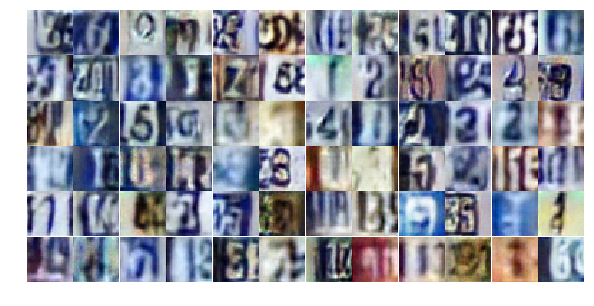

Epoch 12/25... Discriminator Loss: 0.5228... Generator Loss: 1.3827
Epoch 12/25... Discriminator Loss: 1.2998... Generator Loss: 0.4270
Epoch 12/25... Discriminator Loss: 0.4252... Generator Loss: 1.8006
Epoch 12/25... Discriminator Loss: 1.2666... Generator Loss: 2.5448
Epoch 12/25... Discriminator Loss: 0.6905... Generator Loss: 1.7417
Epoch 12/25... Discriminator Loss: 0.6975... Generator Loss: 1.1896
Epoch 12/25... Discriminator Loss: 1.6658... Generator Loss: 0.3107
Epoch 12/25... Discriminator Loss: 0.4177... Generator Loss: 1.8216
Epoch 12/25... Discriminator Loss: 0.5370... Generator Loss: 1.1648
Epoch 12/25... Discriminator Loss: 0.9514... Generator Loss: 0.7224


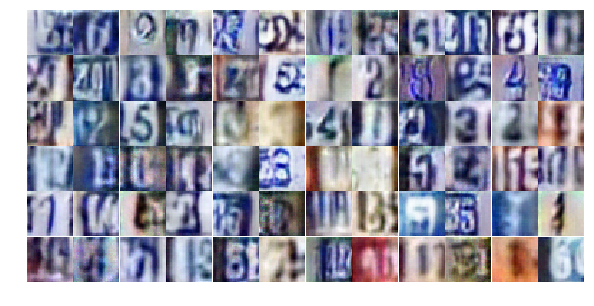

Epoch 12/25... Discriminator Loss: 0.4172... Generator Loss: 1.4333
Epoch 12/25... Discriminator Loss: 0.3933... Generator Loss: 1.8700
Epoch 12/25... Discriminator Loss: 0.8733... Generator Loss: 0.7653
Epoch 12/25... Discriminator Loss: 0.4679... Generator Loss: 1.3181
Epoch 12/25... Discriminator Loss: 0.4000... Generator Loss: 1.4444
Epoch 12/25... Discriminator Loss: 0.5105... Generator Loss: 1.2141
Epoch 12/25... Discriminator Loss: 0.6516... Generator Loss: 1.0296
Epoch 12/25... Discriminator Loss: 0.2909... Generator Loss: 1.9308
Epoch 12/25... Discriminator Loss: 0.3665... Generator Loss: 2.2617
Epoch 12/25... Discriminator Loss: 0.4823... Generator Loss: 1.5795


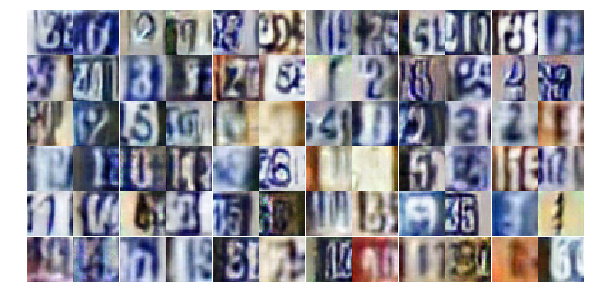

Epoch 12/25... Discriminator Loss: 0.5735... Generator Loss: 1.2130
Epoch 12/25... Discriminator Loss: 0.5743... Generator Loss: 1.4678
Epoch 12/25... Discriminator Loss: 1.0938... Generator Loss: 0.5736
Epoch 12/25... Discriminator Loss: 1.8831... Generator Loss: 0.2305
Epoch 12/25... Discriminator Loss: 1.3713... Generator Loss: 3.2879
Epoch 12/25... Discriminator Loss: 0.7599... Generator Loss: 1.0960
Epoch 12/25... Discriminator Loss: 0.6852... Generator Loss: 0.9401
Epoch 12/25... Discriminator Loss: 0.7141... Generator Loss: 1.0729
Epoch 12/25... Discriminator Loss: 0.4801... Generator Loss: 1.6061
Epoch 12/25... Discriminator Loss: 0.3836... Generator Loss: 1.5813


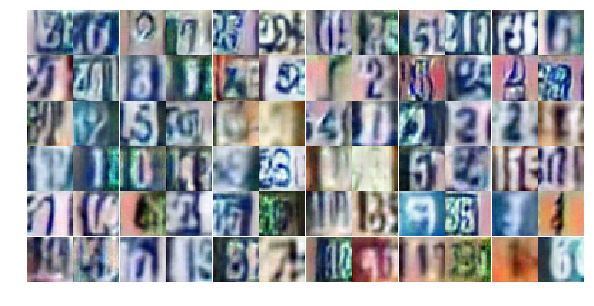

Epoch 12/25... Discriminator Loss: 0.5969... Generator Loss: 1.2169
Epoch 12/25... Discriminator Loss: 0.3650... Generator Loss: 1.4970
Epoch 12/25... Discriminator Loss: 0.4351... Generator Loss: 1.3899
Epoch 12/25... Discriminator Loss: 0.8461... Generator Loss: 0.8131
Epoch 12/25... Discriminator Loss: 1.1625... Generator Loss: 0.5453
Epoch 12/25... Discriminator Loss: 0.9170... Generator Loss: 0.7244
Epoch 12/25... Discriminator Loss: 0.9512... Generator Loss: 0.6968
Epoch 12/25... Discriminator Loss: 0.9595... Generator Loss: 0.6900
Epoch 12/25... Discriminator Loss: 0.4178... Generator Loss: 1.5082
Epoch 12/25... Discriminator Loss: 0.5869... Generator Loss: 1.0754


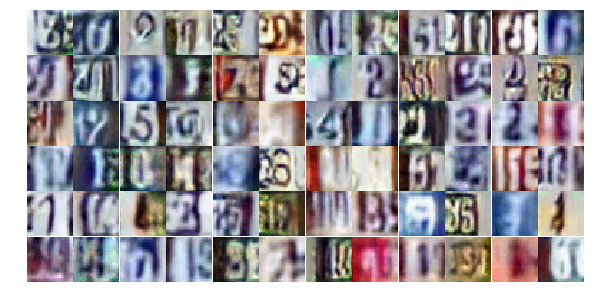

Epoch 12/25... Discriminator Loss: 0.9623... Generator Loss: 0.7480
Epoch 12/25... Discriminator Loss: 0.5231... Generator Loss: 1.2917
Epoch 12/25... Discriminator Loss: 2.3623... Generator Loss: 3.7420
Epoch 12/25... Discriminator Loss: 1.0048... Generator Loss: 0.7747
Epoch 12/25... Discriminator Loss: 0.7381... Generator Loss: 0.9200
Epoch 12/25... Discriminator Loss: 0.6686... Generator Loss: 1.2992
Epoch 12/25... Discriminator Loss: 1.0219... Generator Loss: 0.6259
Epoch 13/25... Discriminator Loss: 0.4902... Generator Loss: 1.3970
Epoch 13/25... Discriminator Loss: 0.4178... Generator Loss: 1.5147
Epoch 13/25... Discriminator Loss: 0.7838... Generator Loss: 1.0656


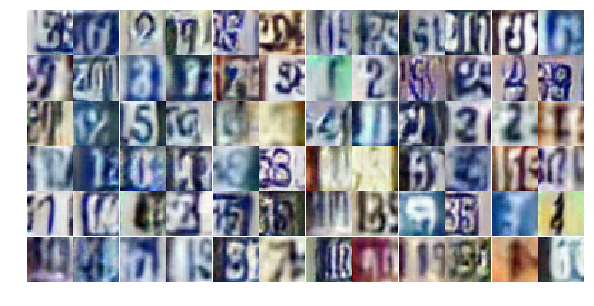

Epoch 13/25... Discriminator Loss: 0.4296... Generator Loss: 1.5307
Epoch 13/25... Discriminator Loss: 0.4268... Generator Loss: 1.5953
Epoch 13/25... Discriminator Loss: 1.3693... Generator Loss: 0.3920
Epoch 13/25... Discriminator Loss: 1.1237... Generator Loss: 0.5276
Epoch 13/25... Discriminator Loss: 0.6424... Generator Loss: 1.1295
Epoch 13/25... Discriminator Loss: 0.4047... Generator Loss: 1.6936
Epoch 13/25... Discriminator Loss: 0.3019... Generator Loss: 2.0111
Epoch 13/25... Discriminator Loss: 0.5436... Generator Loss: 1.2059
Epoch 13/25... Discriminator Loss: 0.4609... Generator Loss: 1.2845
Epoch 13/25... Discriminator Loss: 0.5670... Generator Loss: 1.8539


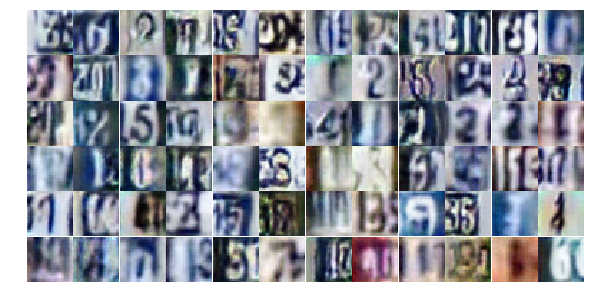

Epoch 13/25... Discriminator Loss: 0.6054... Generator Loss: 1.1816
Epoch 13/25... Discriminator Loss: 0.4243... Generator Loss: 1.9929
Epoch 13/25... Discriminator Loss: 0.8940... Generator Loss: 0.7363
Epoch 13/25... Discriminator Loss: 0.7090... Generator Loss: 0.9175
Epoch 13/25... Discriminator Loss: 0.5765... Generator Loss: 1.2659
Epoch 13/25... Discriminator Loss: 2.6880... Generator Loss: 0.7490
Epoch 13/25... Discriminator Loss: 0.8034... Generator Loss: 0.9230
Epoch 13/25... Discriminator Loss: 1.1539... Generator Loss: 0.5353
Epoch 13/25... Discriminator Loss: 0.7361... Generator Loss: 0.9689
Epoch 13/25... Discriminator Loss: 0.8097... Generator Loss: 0.8507


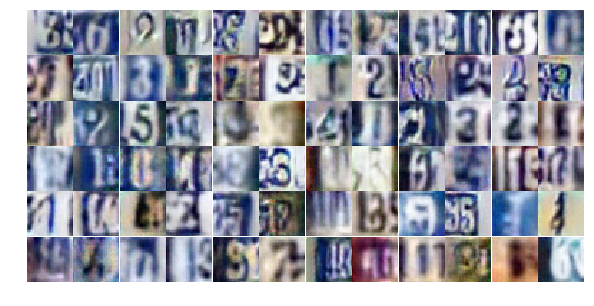

Epoch 13/25... Discriminator Loss: 0.7039... Generator Loss: 0.9729
Epoch 13/25... Discriminator Loss: 0.5573... Generator Loss: 1.3147
Epoch 13/25... Discriminator Loss: 0.6396... Generator Loss: 1.4036
Epoch 13/25... Discriminator Loss: 0.6605... Generator Loss: 0.9585
Epoch 13/25... Discriminator Loss: 0.7254... Generator Loss: 0.9876
Epoch 13/25... Discriminator Loss: 0.6444... Generator Loss: 1.3263
Epoch 13/25... Discriminator Loss: 1.0039... Generator Loss: 2.0132
Epoch 13/25... Discriminator Loss: 0.4544... Generator Loss: 1.7624
Epoch 13/25... Discriminator Loss: 0.5405... Generator Loss: 1.2779
Epoch 13/25... Discriminator Loss: 0.4530... Generator Loss: 1.7251


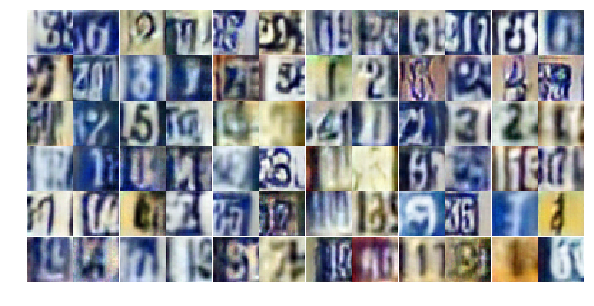

Epoch 13/25... Discriminator Loss: 1.0970... Generator Loss: 0.5443
Epoch 13/25... Discriminator Loss: 0.5477... Generator Loss: 1.6038
Epoch 13/25... Discriminator Loss: 0.6281... Generator Loss: 1.0662
Epoch 13/25... Discriminator Loss: 1.0292... Generator Loss: 0.5988
Epoch 13/25... Discriminator Loss: 0.5561... Generator Loss: 1.1555
Epoch 13/25... Discriminator Loss: 0.3343... Generator Loss: 1.6827
Epoch 13/25... Discriminator Loss: 0.4142... Generator Loss: 1.4542
Epoch 13/25... Discriminator Loss: 0.9393... Generator Loss: 0.7343
Epoch 13/25... Discriminator Loss: 0.7153... Generator Loss: 0.9543
Epoch 13/25... Discriminator Loss: 0.4236... Generator Loss: 1.5766


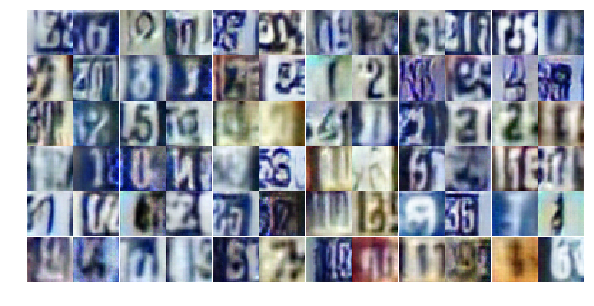

Epoch 13/25... Discriminator Loss: 0.5587... Generator Loss: 1.2749
Epoch 13/25... Discriminator Loss: 1.2063... Generator Loss: 1.9554
Epoch 13/25... Discriminator Loss: 0.9701... Generator Loss: 0.7873
Epoch 13/25... Discriminator Loss: 0.5424... Generator Loss: 1.7913
Epoch 13/25... Discriminator Loss: 0.8539... Generator Loss: 0.8121
Epoch 13/25... Discriminator Loss: 0.7219... Generator Loss: 0.8613
Epoch 13/25... Discriminator Loss: 0.7384... Generator Loss: 0.9131
Epoch 13/25... Discriminator Loss: 0.5632... Generator Loss: 1.2100
Epoch 13/25... Discriminator Loss: 0.9027... Generator Loss: 0.7557
Epoch 13/25... Discriminator Loss: 1.3717... Generator Loss: 0.4063


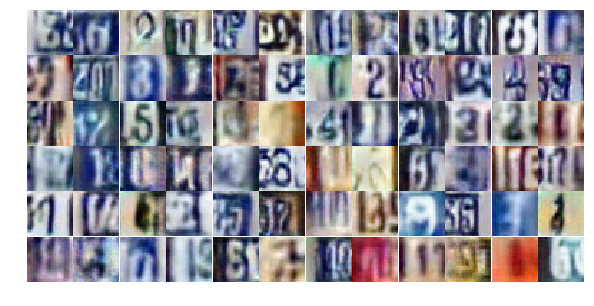

Epoch 13/25... Discriminator Loss: 0.3414... Generator Loss: 2.2010
Epoch 13/25... Discriminator Loss: 0.9912... Generator Loss: 0.7163
Epoch 13/25... Discriminator Loss: 0.5946... Generator Loss: 1.4492
Epoch 13/25... Discriminator Loss: 0.7047... Generator Loss: 0.8822
Epoch 14/25... Discriminator Loss: 0.9715... Generator Loss: 0.7308
Epoch 14/25... Discriminator Loss: 0.7296... Generator Loss: 1.0111
Epoch 14/25... Discriminator Loss: 0.6967... Generator Loss: 1.0102
Epoch 14/25... Discriminator Loss: 0.4444... Generator Loss: 1.6485
Epoch 14/25... Discriminator Loss: 0.6340... Generator Loss: 1.0765
Epoch 14/25... Discriminator Loss: 0.8285... Generator Loss: 0.7866


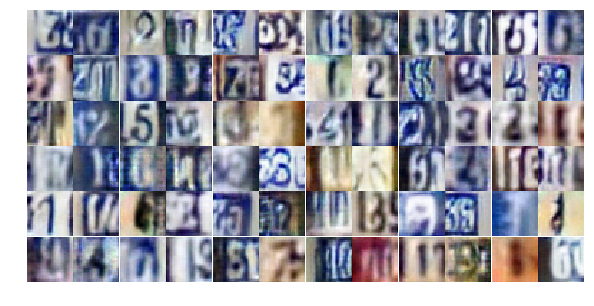

Epoch 14/25... Discriminator Loss: 0.7954... Generator Loss: 2.7282
Epoch 14/25... Discriminator Loss: 0.9681... Generator Loss: 0.7056
Epoch 14/25... Discriminator Loss: 0.7014... Generator Loss: 1.0764
Epoch 14/25... Discriminator Loss: 0.6201... Generator Loss: 1.1171
Epoch 14/25... Discriminator Loss: 1.1069... Generator Loss: 0.6246
Epoch 14/25... Discriminator Loss: 0.3426... Generator Loss: 1.4858
Epoch 14/25... Discriminator Loss: 0.4280... Generator Loss: 1.6706
Epoch 14/25... Discriminator Loss: 1.2949... Generator Loss: 0.4546
Epoch 14/25... Discriminator Loss: 0.7376... Generator Loss: 1.0111
Epoch 14/25... Discriminator Loss: 1.6720... Generator Loss: 0.3025


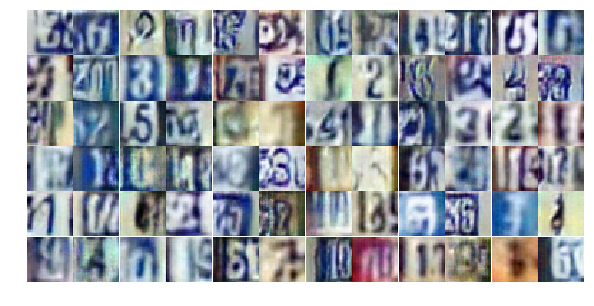

Epoch 14/25... Discriminator Loss: 0.4802... Generator Loss: 1.2663
Epoch 14/25... Discriminator Loss: 0.6335... Generator Loss: 1.8052
Epoch 14/25... Discriminator Loss: 0.9231... Generator Loss: 0.8782
Epoch 14/25... Discriminator Loss: 0.4747... Generator Loss: 1.4085
Epoch 14/25... Discriminator Loss: 0.8545... Generator Loss: 0.7579
Epoch 14/25... Discriminator Loss: 0.5991... Generator Loss: 1.9459
Epoch 14/25... Discriminator Loss: 0.9537... Generator Loss: 0.7419
Epoch 14/25... Discriminator Loss: 0.6900... Generator Loss: 0.9847
Epoch 14/25... Discriminator Loss: 0.5924... Generator Loss: 1.0831
Epoch 14/25... Discriminator Loss: 0.3431... Generator Loss: 1.6635


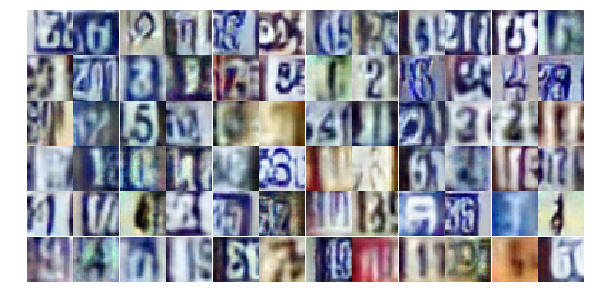

Epoch 14/25... Discriminator Loss: 1.3275... Generator Loss: 0.4227
Epoch 14/25... Discriminator Loss: 0.4408... Generator Loss: 1.4724
Epoch 14/25... Discriminator Loss: 0.5227... Generator Loss: 1.1401
Epoch 14/25... Discriminator Loss: 0.3533... Generator Loss: 1.6695
Epoch 14/25... Discriminator Loss: 0.5286... Generator Loss: 1.2110
Epoch 14/25... Discriminator Loss: 0.8749... Generator Loss: 0.8173
Epoch 14/25... Discriminator Loss: 0.6749... Generator Loss: 1.0880
Epoch 14/25... Discriminator Loss: 0.5294... Generator Loss: 1.2041
Epoch 14/25... Discriminator Loss: 0.4554... Generator Loss: 1.3152
Epoch 14/25... Discriminator Loss: 0.8496... Generator Loss: 0.8706


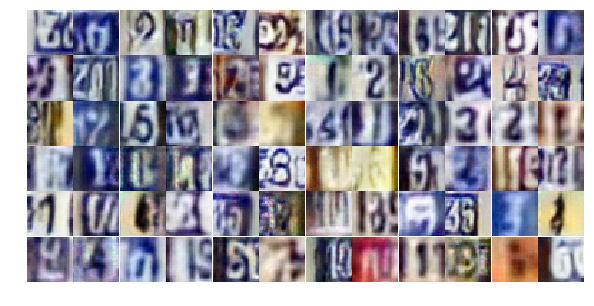

Epoch 14/25... Discriminator Loss: 1.1373... Generator Loss: 0.5638
Epoch 14/25... Discriminator Loss: 0.5705... Generator Loss: 2.1215
Epoch 14/25... Discriminator Loss: 0.8820... Generator Loss: 0.7767
Epoch 14/25... Discriminator Loss: 1.2828... Generator Loss: 0.4689
Epoch 14/25... Discriminator Loss: 0.6112... Generator Loss: 1.2317
Epoch 14/25... Discriminator Loss: 0.8836... Generator Loss: 0.8077
Epoch 14/25... Discriminator Loss: 0.5143... Generator Loss: 1.3612
Epoch 14/25... Discriminator Loss: 0.4543... Generator Loss: 1.8935
Epoch 14/25... Discriminator Loss: 1.4375... Generator Loss: 0.3884
Epoch 14/25... Discriminator Loss: 1.8682... Generator Loss: 0.2281


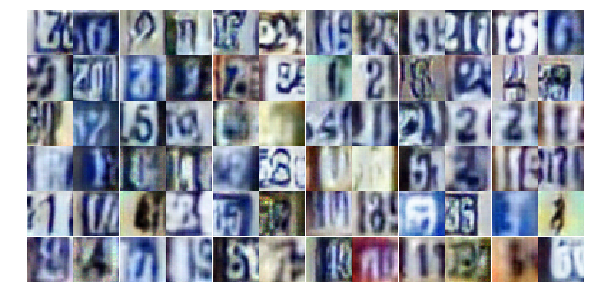

Epoch 14/25... Discriminator Loss: 1.7670... Generator Loss: 2.8408
Epoch 14/25... Discriminator Loss: 1.8395... Generator Loss: 0.2749
Epoch 14/25... Discriminator Loss: 0.5604... Generator Loss: 1.2738
Epoch 14/25... Discriminator Loss: 1.0755... Generator Loss: 0.5922
Epoch 14/25... Discriminator Loss: 0.5376... Generator Loss: 1.2220
Epoch 14/25... Discriminator Loss: 0.7397... Generator Loss: 0.9609
Epoch 14/25... Discriminator Loss: 0.7271... Generator Loss: 1.8177
Epoch 14/25... Discriminator Loss: 0.6735... Generator Loss: 1.0622
Epoch 14/25... Discriminator Loss: 1.1811... Generator Loss: 0.4858
Epoch 14/25... Discriminator Loss: 1.1362... Generator Loss: 0.6527


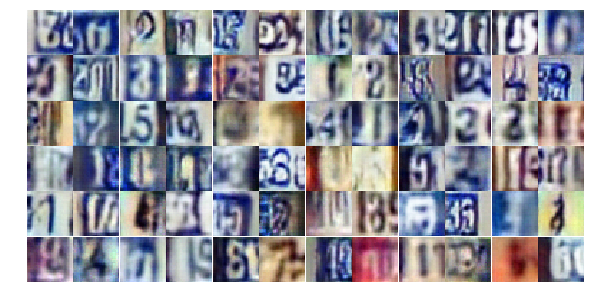

Epoch 14/25... Discriminator Loss: 0.7997... Generator Loss: 0.9752
Epoch 14/25... Discriminator Loss: 1.0476... Generator Loss: 0.6827
Epoch 15/25... Discriminator Loss: 0.7068... Generator Loss: 0.9919
Epoch 15/25... Discriminator Loss: 0.4904... Generator Loss: 1.6547
Epoch 15/25... Discriminator Loss: 0.5195... Generator Loss: 1.4376
Epoch 15/25... Discriminator Loss: 0.5171... Generator Loss: 1.3622
Epoch 15/25... Discriminator Loss: 1.0812... Generator Loss: 0.6323
Epoch 15/25... Discriminator Loss: 0.5897... Generator Loss: 1.4833
Epoch 15/25... Discriminator Loss: 1.9037... Generator Loss: 0.9645
Epoch 15/25... Discriminator Loss: 0.7202... Generator Loss: 1.2195


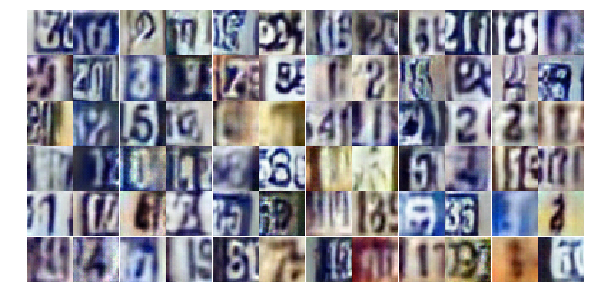

Epoch 15/25... Discriminator Loss: 0.6631... Generator Loss: 1.0476
Epoch 15/25... Discriminator Loss: 0.6884... Generator Loss: 1.1847
Epoch 15/25... Discriminator Loss: 0.6601... Generator Loss: 1.0667
Epoch 15/25... Discriminator Loss: 0.6515... Generator Loss: 1.1322
Epoch 15/25... Discriminator Loss: 1.0998... Generator Loss: 0.6171
Epoch 15/25... Discriminator Loss: 0.4131... Generator Loss: 1.4884
Epoch 15/25... Discriminator Loss: 1.0672... Generator Loss: 0.6013
Epoch 15/25... Discriminator Loss: 0.6362... Generator Loss: 1.1412
Epoch 15/25... Discriminator Loss: 0.2897... Generator Loss: 2.4418
Epoch 15/25... Discriminator Loss: 0.6460... Generator Loss: 1.0881


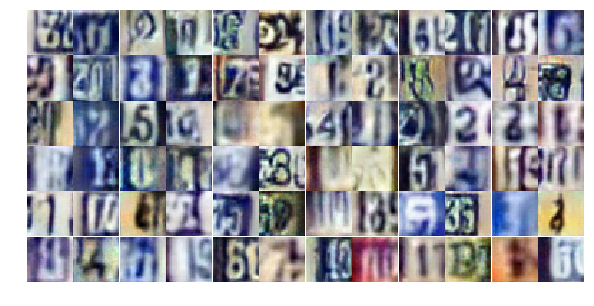

Epoch 15/25... Discriminator Loss: 0.9878... Generator Loss: 0.6527
Epoch 15/25... Discriminator Loss: 0.5269... Generator Loss: 1.2782
Epoch 15/25... Discriminator Loss: 0.6239... Generator Loss: 1.1339
Epoch 15/25... Discriminator Loss: 1.1600... Generator Loss: 0.4949
Epoch 15/25... Discriminator Loss: 1.1479... Generator Loss: 0.5413
Epoch 15/25... Discriminator Loss: 0.4127... Generator Loss: 1.7077
Epoch 15/25... Discriminator Loss: 0.8114... Generator Loss: 0.8925
Epoch 15/25... Discriminator Loss: 0.7118... Generator Loss: 0.9591
Epoch 15/25... Discriminator Loss: 0.5647... Generator Loss: 1.1007
Epoch 15/25... Discriminator Loss: 1.3503... Generator Loss: 0.4530


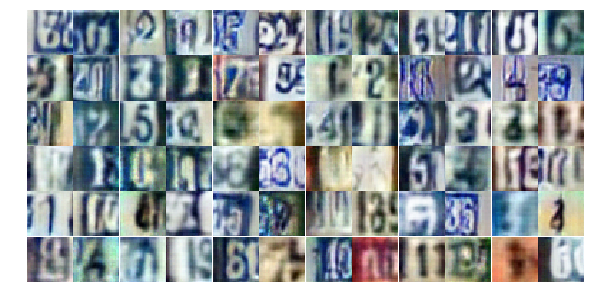

Epoch 15/25... Discriminator Loss: 0.6819... Generator Loss: 1.0271
Epoch 15/25... Discriminator Loss: 1.0592... Generator Loss: 0.6375
Epoch 15/25... Discriminator Loss: 0.4119... Generator Loss: 1.5049
Epoch 15/25... Discriminator Loss: 0.5154... Generator Loss: 1.3122
Epoch 15/25... Discriminator Loss: 0.5717... Generator Loss: 1.0702
Epoch 15/25... Discriminator Loss: 0.6704... Generator Loss: 2.5074
Epoch 15/25... Discriminator Loss: 0.4096... Generator Loss: 1.8488
Epoch 15/25... Discriminator Loss: 0.6453... Generator Loss: 1.2607
Epoch 15/25... Discriminator Loss: 0.6616... Generator Loss: 0.9654
Epoch 15/25... Discriminator Loss: 1.1351... Generator Loss: 0.5669


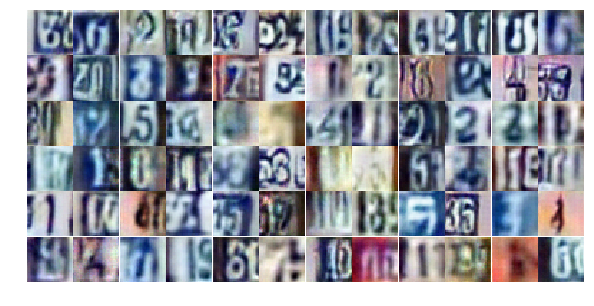

Epoch 15/25... Discriminator Loss: 0.5430... Generator Loss: 1.2183
Epoch 15/25... Discriminator Loss: 1.0923... Generator Loss: 0.5551
Epoch 15/25... Discriminator Loss: 0.9583... Generator Loss: 0.7486
Epoch 15/25... Discriminator Loss: 0.4496... Generator Loss: 1.5059
Epoch 15/25... Discriminator Loss: 0.7250... Generator Loss: 0.8606
Epoch 15/25... Discriminator Loss: 1.8933... Generator Loss: 3.2907
Epoch 15/25... Discriminator Loss: 0.4130... Generator Loss: 1.7645
Epoch 15/25... Discriminator Loss: 0.6177... Generator Loss: 1.2444
Epoch 15/25... Discriminator Loss: 1.0537... Generator Loss: 0.5763
Epoch 15/25... Discriminator Loss: 0.6098... Generator Loss: 2.0849


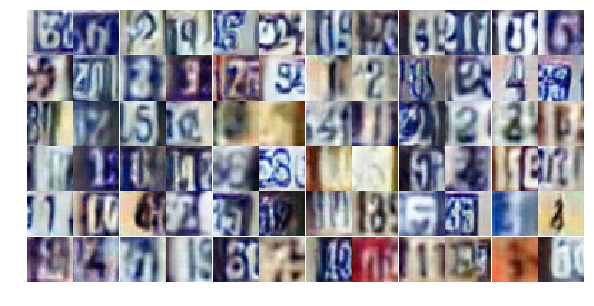

Epoch 15/25... Discriminator Loss: 1.4230... Generator Loss: 0.3965
Epoch 15/25... Discriminator Loss: 1.0229... Generator Loss: 0.7268
Epoch 15/25... Discriminator Loss: 0.3862... Generator Loss: 2.5509
Epoch 15/25... Discriminator Loss: 0.7296... Generator Loss: 0.9177
Epoch 15/25... Discriminator Loss: 0.4505... Generator Loss: 1.7673
Epoch 15/25... Discriminator Loss: 0.6167... Generator Loss: 1.0908
Epoch 15/25... Discriminator Loss: 0.7846... Generator Loss: 0.8752
Epoch 15/25... Discriminator Loss: 0.5670... Generator Loss: 1.2508
Epoch 15/25... Discriminator Loss: 1.0011... Generator Loss: 1.0471
Epoch 16/25... Discriminator Loss: 1.2303... Generator Loss: 0.5240


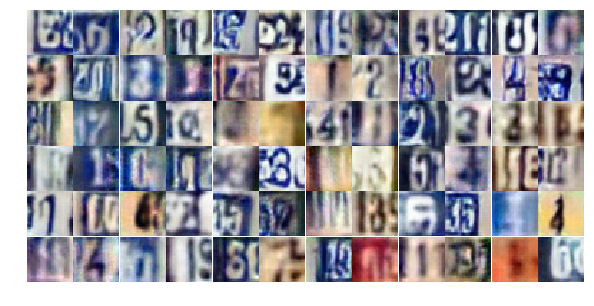

Epoch 16/25... Discriminator Loss: 0.7942... Generator Loss: 0.9554
Epoch 16/25... Discriminator Loss: 0.7432... Generator Loss: 1.0633
Epoch 16/25... Discriminator Loss: 0.7640... Generator Loss: 0.8152
Epoch 16/25... Discriminator Loss: 0.7672... Generator Loss: 1.0636
Epoch 16/25... Discriminator Loss: 0.3974... Generator Loss: 2.3996
Epoch 16/25... Discriminator Loss: 2.6788... Generator Loss: 4.7669
Epoch 16/25... Discriminator Loss: 1.5529... Generator Loss: 0.3770
Epoch 16/25... Discriminator Loss: 0.8308... Generator Loss: 0.8531
Epoch 16/25... Discriminator Loss: 0.6452... Generator Loss: 1.1161
Epoch 16/25... Discriminator Loss: 0.6407... Generator Loss: 1.0273


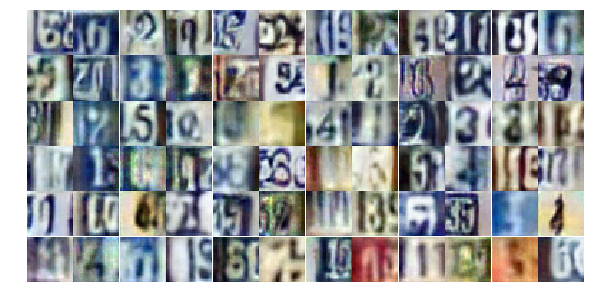

Epoch 16/25... Discriminator Loss: 1.2151... Generator Loss: 0.4882
Epoch 16/25... Discriminator Loss: 0.5239... Generator Loss: 1.5503
Epoch 16/25... Discriminator Loss: 0.6824... Generator Loss: 1.0210
Epoch 16/25... Discriminator Loss: 1.0805... Generator Loss: 0.5657
Epoch 16/25... Discriminator Loss: 0.4715... Generator Loss: 1.4709
Epoch 16/25... Discriminator Loss: 0.6174... Generator Loss: 1.1632
Epoch 16/25... Discriminator Loss: 1.4772... Generator Loss: 0.4045
Epoch 16/25... Discriminator Loss: 0.5462... Generator Loss: 1.2152
Epoch 16/25... Discriminator Loss: 0.4585... Generator Loss: 1.3400
Epoch 16/25... Discriminator Loss: 0.5147... Generator Loss: 1.2820


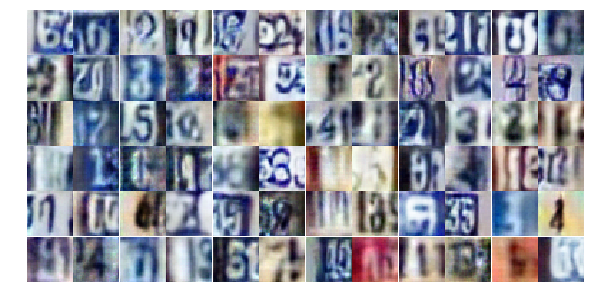

Epoch 16/25... Discriminator Loss: 0.5474... Generator Loss: 1.2847
Epoch 16/25... Discriminator Loss: 0.5793... Generator Loss: 1.1928
Epoch 16/25... Discriminator Loss: 0.7678... Generator Loss: 0.8887
Epoch 16/25... Discriminator Loss: 0.7551... Generator Loss: 0.8714
Epoch 16/25... Discriminator Loss: 0.7277... Generator Loss: 1.0550
Epoch 16/25... Discriminator Loss: 0.6984... Generator Loss: 1.1853
Epoch 16/25... Discriminator Loss: 0.5928... Generator Loss: 1.1183
Epoch 16/25... Discriminator Loss: 0.7528... Generator Loss: 0.8180
Epoch 16/25... Discriminator Loss: 0.6046... Generator Loss: 1.3155
Epoch 16/25... Discriminator Loss: 0.5062... Generator Loss: 1.3049


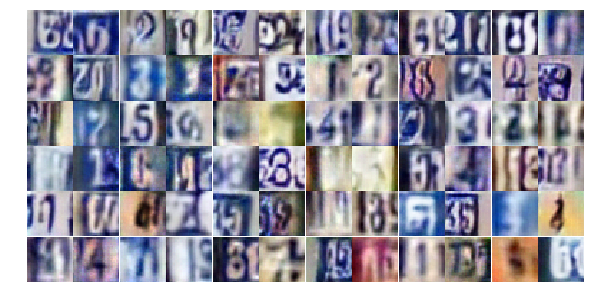

Epoch 16/25... Discriminator Loss: 0.6718... Generator Loss: 0.9445
Epoch 16/25... Discriminator Loss: 0.5247... Generator Loss: 1.2026
Epoch 16/25... Discriminator Loss: 0.5908... Generator Loss: 2.1417
Epoch 16/25... Discriminator Loss: 1.5406... Generator Loss: 0.3749
Epoch 16/25... Discriminator Loss: 0.9151... Generator Loss: 0.8074
Epoch 16/25... Discriminator Loss: 0.6191... Generator Loss: 1.1013
Epoch 16/25... Discriminator Loss: 0.4732... Generator Loss: 1.5271
Epoch 16/25... Discriminator Loss: 0.5084... Generator Loss: 1.2669
Epoch 16/25... Discriminator Loss: 0.9002... Generator Loss: 0.7231
Epoch 16/25... Discriminator Loss: 0.5621... Generator Loss: 2.7591


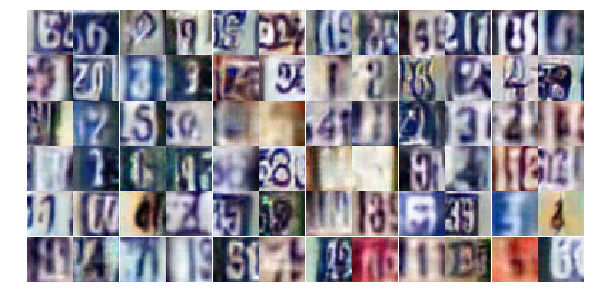

Epoch 16/25... Discriminator Loss: 0.5868... Generator Loss: 1.2582
Epoch 16/25... Discriminator Loss: 0.6031... Generator Loss: 1.1871
Epoch 16/25... Discriminator Loss: 1.0267... Generator Loss: 0.5874
Epoch 16/25... Discriminator Loss: 0.6519... Generator Loss: 1.4622
Epoch 16/25... Discriminator Loss: 0.7741... Generator Loss: 1.0769
Epoch 16/25... Discriminator Loss: 0.9517... Generator Loss: 0.7241
Epoch 16/25... Discriminator Loss: 0.4460... Generator Loss: 1.3836
Epoch 16/25... Discriminator Loss: 0.9557... Generator Loss: 0.6851
Epoch 16/25... Discriminator Loss: 0.5783... Generator Loss: 1.0704
Epoch 16/25... Discriminator Loss: 1.2108... Generator Loss: 0.5210


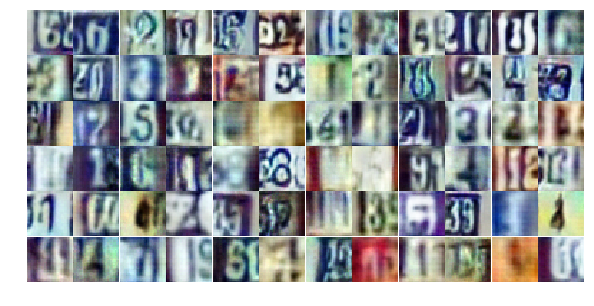

Epoch 16/25... Discriminator Loss: 0.9998... Generator Loss: 0.8667
Epoch 16/25... Discriminator Loss: 0.7720... Generator Loss: 2.6533
Epoch 16/25... Discriminator Loss: 1.8288... Generator Loss: 0.2993
Epoch 16/25... Discriminator Loss: 0.4042... Generator Loss: 1.6308
Epoch 16/25... Discriminator Loss: 0.5747... Generator Loss: 1.1923
Epoch 16/25... Discriminator Loss: 0.5122... Generator Loss: 1.1919
Epoch 17/25... Discriminator Loss: 0.5576... Generator Loss: 1.1887
Epoch 17/25... Discriminator Loss: 0.6636... Generator Loss: 1.0011
Epoch 17/25... Discriminator Loss: 0.8120... Generator Loss: 0.8208
Epoch 17/25... Discriminator Loss: 0.6261... Generator Loss: 1.7127


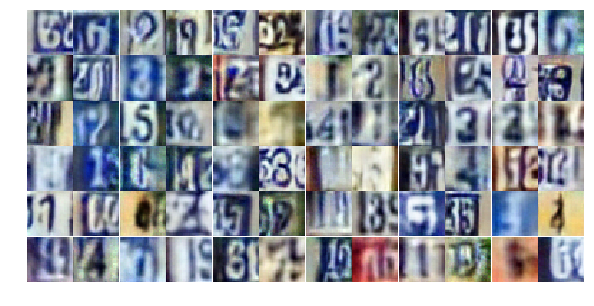

Epoch 17/25... Discriminator Loss: 0.4325... Generator Loss: 1.4836
Epoch 17/25... Discriminator Loss: 0.6820... Generator Loss: 1.0228
Epoch 17/25... Discriminator Loss: 1.7353... Generator Loss: 0.3330
Epoch 17/25... Discriminator Loss: 1.3592... Generator Loss: 0.4740
Epoch 17/25... Discriminator Loss: 1.1134... Generator Loss: 0.6590
Epoch 17/25... Discriminator Loss: 1.3986... Generator Loss: 0.4301
Epoch 17/25... Discriminator Loss: 0.7525... Generator Loss: 1.0253
Epoch 17/25... Discriminator Loss: 0.4315... Generator Loss: 1.5441
Epoch 17/25... Discriminator Loss: 0.3893... Generator Loss: 1.6332
Epoch 17/25... Discriminator Loss: 0.7133... Generator Loss: 0.9764


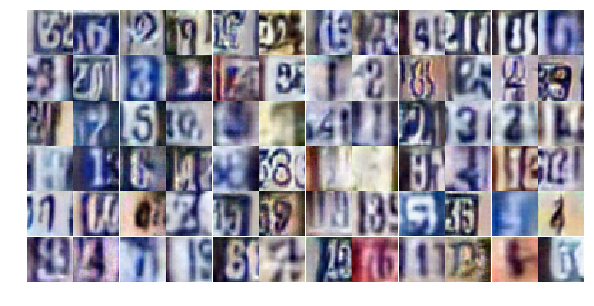

Epoch 17/25... Discriminator Loss: 0.8391... Generator Loss: 0.8652
Epoch 17/25... Discriminator Loss: 0.7833... Generator Loss: 0.8284
Epoch 17/25... Discriminator Loss: 0.4846... Generator Loss: 1.4113
Epoch 17/25... Discriminator Loss: 0.6413... Generator Loss: 1.1275
Epoch 17/25... Discriminator Loss: 0.4742... Generator Loss: 1.7667
Epoch 17/25... Discriminator Loss: 0.6349... Generator Loss: 1.0923
Epoch 17/25... Discriminator Loss: 0.5554... Generator Loss: 1.3923
Epoch 17/25... Discriminator Loss: 0.4673... Generator Loss: 1.3063
Epoch 17/25... Discriminator Loss: 0.5080... Generator Loss: 1.6010
Epoch 17/25... Discriminator Loss: 0.6024... Generator Loss: 1.0294


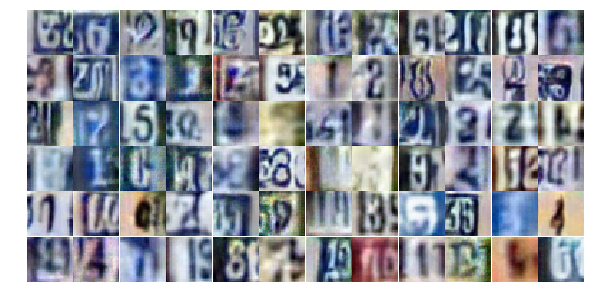

Epoch 17/25... Discriminator Loss: 1.7180... Generator Loss: 0.3016
Epoch 17/25... Discriminator Loss: 0.3909... Generator Loss: 1.6242
Epoch 17/25... Discriminator Loss: 0.4790... Generator Loss: 1.2858
Epoch 17/25... Discriminator Loss: 1.3450... Generator Loss: 0.4099
Epoch 17/25... Discriminator Loss: 1.5043... Generator Loss: 0.3726
Epoch 17/25... Discriminator Loss: 0.4813... Generator Loss: 1.3877
Epoch 17/25... Discriminator Loss: 0.8308... Generator Loss: 0.7785
Epoch 17/25... Discriminator Loss: 0.9390... Generator Loss: 0.6916
Epoch 17/25... Discriminator Loss: 1.2512... Generator Loss: 0.4392
Epoch 17/25... Discriminator Loss: 0.4180... Generator Loss: 1.5676


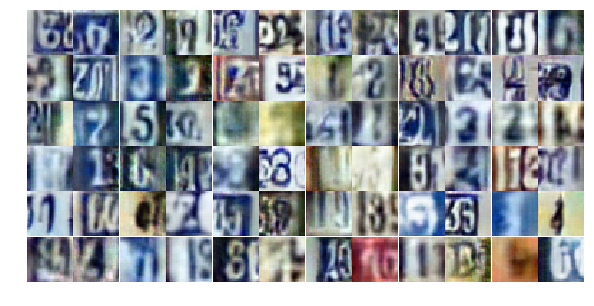

Epoch 17/25... Discriminator Loss: 0.5946... Generator Loss: 1.1664
Epoch 17/25... Discriminator Loss: 0.7680... Generator Loss: 0.9102
Epoch 17/25... Discriminator Loss: 0.4635... Generator Loss: 1.4814
Epoch 17/25... Discriminator Loss: 0.8355... Generator Loss: 0.9331
Epoch 17/25... Discriminator Loss: 1.1961... Generator Loss: 0.5074
Epoch 17/25... Discriminator Loss: 0.5418... Generator Loss: 2.7168
Epoch 17/25... Discriminator Loss: 1.5234... Generator Loss: 0.3631
Epoch 17/25... Discriminator Loss: 0.9005... Generator Loss: 0.7490
Epoch 17/25... Discriminator Loss: 0.4317... Generator Loss: 1.3955
Epoch 17/25... Discriminator Loss: 1.0608... Generator Loss: 0.5720


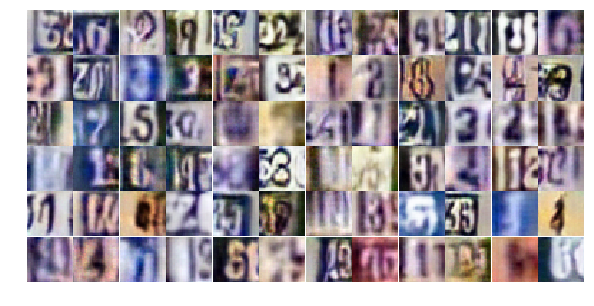

Epoch 17/25... Discriminator Loss: 1.2668... Generator Loss: 0.5459
Epoch 17/25... Discriminator Loss: 0.3377... Generator Loss: 2.4300
Epoch 17/25... Discriminator Loss: 0.6909... Generator Loss: 1.4616
Epoch 17/25... Discriminator Loss: 0.3465... Generator Loss: 1.4734
Epoch 17/25... Discriminator Loss: 0.8270... Generator Loss: 0.7859
Epoch 17/25... Discriminator Loss: 0.5694... Generator Loss: 1.3719
Epoch 17/25... Discriminator Loss: 1.2655... Generator Loss: 0.4673
Epoch 17/25... Discriminator Loss: 0.4326... Generator Loss: 1.4844
Epoch 17/25... Discriminator Loss: 0.5081... Generator Loss: 1.5867
Epoch 17/25... Discriminator Loss: 1.6324... Generator Loss: 0.3056


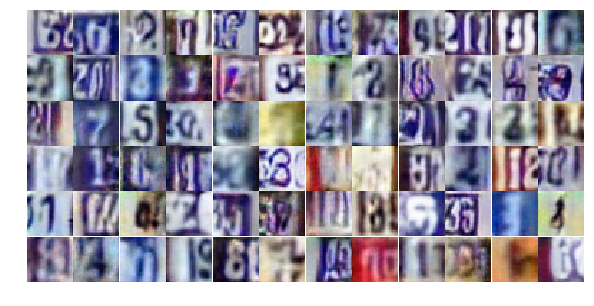

Epoch 17/25... Discriminator Loss: 0.6798... Generator Loss: 1.9588
Epoch 17/25... Discriminator Loss: 0.9007... Generator Loss: 1.5461
Epoch 17/25... Discriminator Loss: 0.5847... Generator Loss: 1.2319
Epoch 17/25... Discriminator Loss: 0.5830... Generator Loss: 1.2467
Epoch 18/25... Discriminator Loss: 1.0640... Generator Loss: 0.6146
Epoch 18/25... Discriminator Loss: 1.2893... Generator Loss: 0.5075
Epoch 18/25... Discriminator Loss: 0.9590... Generator Loss: 0.7046
Epoch 18/25... Discriminator Loss: 0.9034... Generator Loss: 0.7242
Epoch 18/25... Discriminator Loss: 1.4107... Generator Loss: 0.4031
Epoch 18/25... Discriminator Loss: 0.5312... Generator Loss: 1.1899


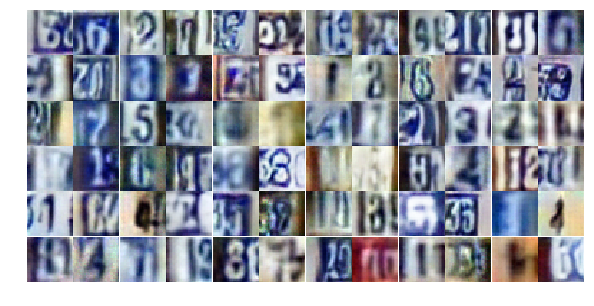

Epoch 18/25... Discriminator Loss: 0.2797... Generator Loss: 1.9287
Epoch 18/25... Discriminator Loss: 1.2145... Generator Loss: 0.4673
Epoch 18/25... Discriminator Loss: 0.7210... Generator Loss: 0.9199
Epoch 18/25... Discriminator Loss: 0.4178... Generator Loss: 1.8581
Epoch 18/25... Discriminator Loss: 0.7877... Generator Loss: 0.8261
Epoch 18/25... Discriminator Loss: 0.8485... Generator Loss: 0.8241
Epoch 18/25... Discriminator Loss: 0.5958... Generator Loss: 1.1294
Epoch 18/25... Discriminator Loss: 0.7207... Generator Loss: 0.9487
Epoch 18/25... Discriminator Loss: 0.5691... Generator Loss: 1.1873
Epoch 18/25... Discriminator Loss: 0.6024... Generator Loss: 1.2183


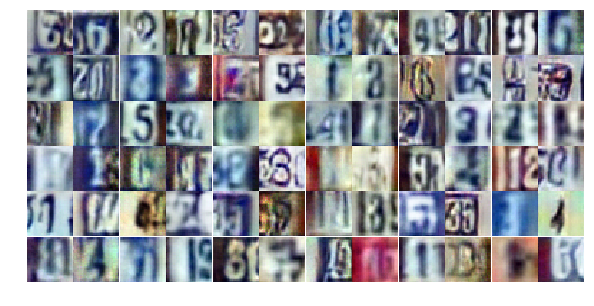

Epoch 18/25... Discriminator Loss: 1.3744... Generator Loss: 0.5651
Epoch 18/25... Discriminator Loss: 0.5960... Generator Loss: 1.2780
Epoch 18/25... Discriminator Loss: 0.9114... Generator Loss: 0.7680
Epoch 18/25... Discriminator Loss: 0.5700... Generator Loss: 1.2530
Epoch 18/25... Discriminator Loss: 0.9306... Generator Loss: 0.7556
Epoch 18/25... Discriminator Loss: 1.4054... Generator Loss: 3.4282
Epoch 18/25... Discriminator Loss: 2.2356... Generator Loss: 2.9534
Epoch 18/25... Discriminator Loss: 0.5615... Generator Loss: 1.6639
Epoch 18/25... Discriminator Loss: 0.8256... Generator Loss: 0.8123
Epoch 18/25... Discriminator Loss: 0.6028... Generator Loss: 1.0695


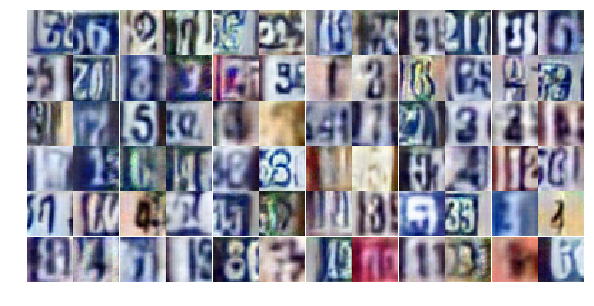

Epoch 18/25... Discriminator Loss: 0.4576... Generator Loss: 1.3826
Epoch 18/25... Discriminator Loss: 0.7993... Generator Loss: 1.0739
Epoch 18/25... Discriminator Loss: 0.5558... Generator Loss: 1.2275
Epoch 18/25... Discriminator Loss: 0.7460... Generator Loss: 0.9193
Epoch 18/25... Discriminator Loss: 0.9687... Generator Loss: 0.6820
Epoch 18/25... Discriminator Loss: 0.5599... Generator Loss: 1.1400
Epoch 18/25... Discriminator Loss: 0.6173... Generator Loss: 1.0730
Epoch 18/25... Discriminator Loss: 0.4517... Generator Loss: 1.6356
Epoch 18/25... Discriminator Loss: 0.5244... Generator Loss: 1.2375
Epoch 18/25... Discriminator Loss: 0.6846... Generator Loss: 1.1212


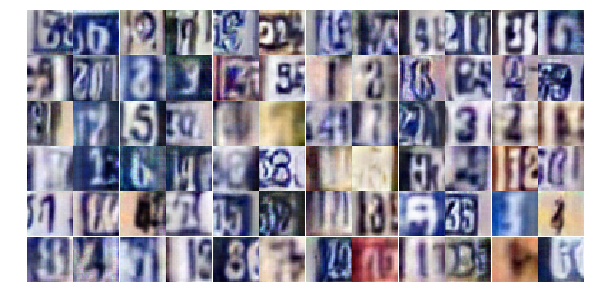

Epoch 18/25... Discriminator Loss: 0.5992... Generator Loss: 1.1827
Epoch 18/25... Discriminator Loss: 0.6473... Generator Loss: 0.9958
Epoch 18/25... Discriminator Loss: 0.5740... Generator Loss: 1.0669
Epoch 18/25... Discriminator Loss: 0.6967... Generator Loss: 0.9414
Epoch 18/25... Discriminator Loss: 0.7852... Generator Loss: 0.8823
Epoch 18/25... Discriminator Loss: 0.4164... Generator Loss: 1.4882
Epoch 18/25... Discriminator Loss: 0.8999... Generator Loss: 0.8029
Epoch 18/25... Discriminator Loss: 1.4171... Generator Loss: 3.1896
Epoch 18/25... Discriminator Loss: 1.3652... Generator Loss: 0.4683
Epoch 18/25... Discriminator Loss: 0.4401... Generator Loss: 2.1902


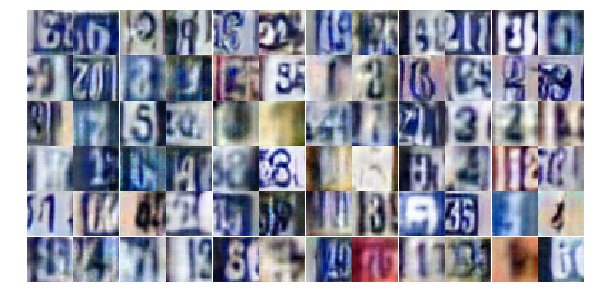

Epoch 18/25... Discriminator Loss: 0.9854... Generator Loss: 0.6635
Epoch 18/25... Discriminator Loss: 0.7524... Generator Loss: 0.8570
Epoch 18/25... Discriminator Loss: 1.0245... Generator Loss: 0.5997
Epoch 18/25... Discriminator Loss: 0.6165... Generator Loss: 1.4737
Epoch 18/25... Discriminator Loss: 0.5622... Generator Loss: 1.1811
Epoch 18/25... Discriminator Loss: 0.6058... Generator Loss: 2.6888
Epoch 18/25... Discriminator Loss: 0.7100... Generator Loss: 3.5612
Epoch 18/25... Discriminator Loss: 0.5232... Generator Loss: 1.6705
Epoch 18/25... Discriminator Loss: 0.9088... Generator Loss: 0.9765
Epoch 18/25... Discriminator Loss: 1.2730... Generator Loss: 0.4854


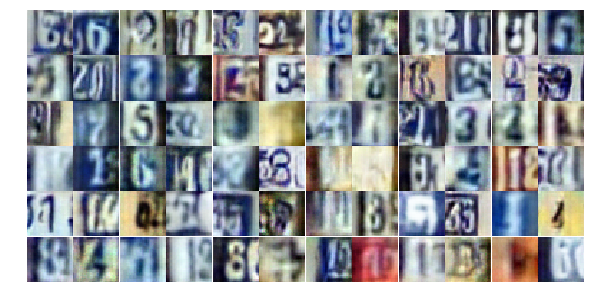

Epoch 18/25... Discriminator Loss: 0.6500... Generator Loss: 1.4547
Epoch 19/25... Discriminator Loss: 0.8500... Generator Loss: 0.9625
Epoch 19/25... Discriminator Loss: 1.0189... Generator Loss: 0.6178
Epoch 19/25... Discriminator Loss: 0.9999... Generator Loss: 0.6514
Epoch 19/25... Discriminator Loss: 0.6760... Generator Loss: 0.9812
Epoch 19/25... Discriminator Loss: 1.0552... Generator Loss: 0.6745
Epoch 19/25... Discriminator Loss: 0.3595... Generator Loss: 1.8165
Epoch 19/25... Discriminator Loss: 0.6591... Generator Loss: 1.5907
Epoch 19/25... Discriminator Loss: 0.6763... Generator Loss: 2.2078
Epoch 19/25... Discriminator Loss: 1.1254... Generator Loss: 0.5794


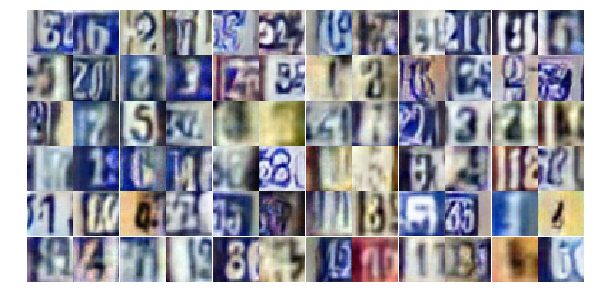

Epoch 19/25... Discriminator Loss: 0.7681... Generator Loss: 0.8801
Epoch 19/25... Discriminator Loss: 0.7344... Generator Loss: 0.9122
Epoch 19/25... Discriminator Loss: 0.7461... Generator Loss: 0.9512
Epoch 19/25... Discriminator Loss: 1.2945... Generator Loss: 0.4391
Epoch 19/25... Discriminator Loss: 0.8506... Generator Loss: 0.8405
Epoch 19/25... Discriminator Loss: 0.5745... Generator Loss: 1.2108
Epoch 19/25... Discriminator Loss: 1.0310... Generator Loss: 0.6286
Epoch 19/25... Discriminator Loss: 0.4437... Generator Loss: 1.9580
Epoch 19/25... Discriminator Loss: 0.6757... Generator Loss: 1.6650
Epoch 19/25... Discriminator Loss: 1.5481... Generator Loss: 0.3913


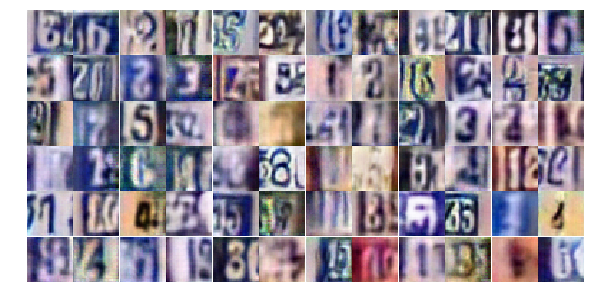

Epoch 19/25... Discriminator Loss: 0.5834... Generator Loss: 1.1250
Epoch 19/25... Discriminator Loss: 0.9984... Generator Loss: 0.7238
Epoch 19/25... Discriminator Loss: 1.7084... Generator Loss: 0.3139
Epoch 19/25... Discriminator Loss: 0.8391... Generator Loss: 0.8540
Epoch 19/25... Discriminator Loss: 0.9442... Generator Loss: 0.7375
Epoch 19/25... Discriminator Loss: 0.8471... Generator Loss: 0.8399
Epoch 19/25... Discriminator Loss: 0.6364... Generator Loss: 1.1167
Epoch 19/25... Discriminator Loss: 0.4865... Generator Loss: 2.8957
Epoch 19/25... Discriminator Loss: 0.6724... Generator Loss: 1.0209
Epoch 19/25... Discriminator Loss: 0.8255... Generator Loss: 0.8594


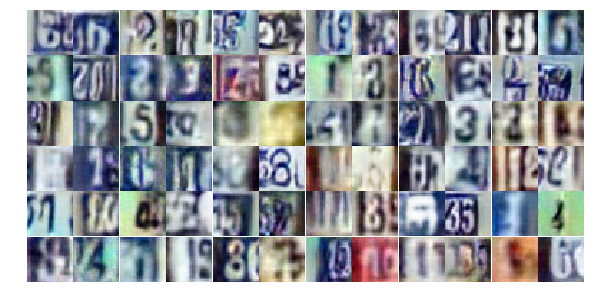

Epoch 19/25... Discriminator Loss: 0.7511... Generator Loss: 0.9002
Epoch 19/25... Discriminator Loss: 0.6174... Generator Loss: 1.1435
Epoch 19/25... Discriminator Loss: 1.0290... Generator Loss: 0.6272
Epoch 19/25... Discriminator Loss: 0.4363... Generator Loss: 1.4762
Epoch 19/25... Discriminator Loss: 0.6562... Generator Loss: 1.1026
Epoch 19/25... Discriminator Loss: 1.1821... Generator Loss: 0.6660
Epoch 19/25... Discriminator Loss: 0.8146... Generator Loss: 3.2314
Epoch 19/25... Discriminator Loss: 0.6155... Generator Loss: 1.1662
Epoch 19/25... Discriminator Loss: 0.9996... Generator Loss: 0.7240
Epoch 19/25... Discriminator Loss: 0.6396... Generator Loss: 1.0917


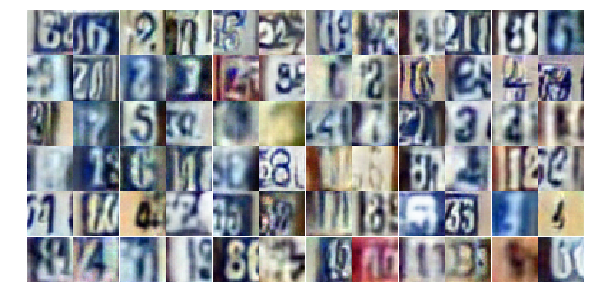

Epoch 19/25... Discriminator Loss: 0.4967... Generator Loss: 1.2371
Epoch 19/25... Discriminator Loss: 0.6868... Generator Loss: 1.0446
Epoch 19/25... Discriminator Loss: 0.8281... Generator Loss: 0.8014
Epoch 19/25... Discriminator Loss: 0.5210... Generator Loss: 1.2362
Epoch 19/25... Discriminator Loss: 0.5146... Generator Loss: 1.5616
Epoch 19/25... Discriminator Loss: 3.2529... Generator Loss: 0.1808
Epoch 19/25... Discriminator Loss: 0.9366... Generator Loss: 1.2065
Epoch 19/25... Discriminator Loss: 0.4852... Generator Loss: 1.5944
Epoch 19/25... Discriminator Loss: 0.5066... Generator Loss: 1.3085
Epoch 19/25... Discriminator Loss: 0.9333... Generator Loss: 0.8030


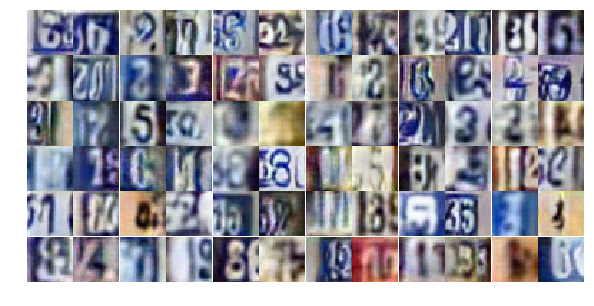

Epoch 19/25... Discriminator Loss: 0.8907... Generator Loss: 0.6968
Epoch 19/25... Discriminator Loss: 0.6780... Generator Loss: 1.5764
Epoch 19/25... Discriminator Loss: 0.5108... Generator Loss: 1.7095
Epoch 19/25... Discriminator Loss: 1.2500... Generator Loss: 0.4805
Epoch 19/25... Discriminator Loss: 0.8183... Generator Loss: 3.3923
Epoch 19/25... Discriminator Loss: 0.5656... Generator Loss: 1.4644
Epoch 19/25... Discriminator Loss: 1.0310... Generator Loss: 0.6195
Epoch 19/25... Discriminator Loss: 0.5411... Generator Loss: 1.3942
Epoch 20/25... Discriminator Loss: 0.9532... Generator Loss: 0.8941
Epoch 20/25... Discriminator Loss: 0.7532... Generator Loss: 0.9412


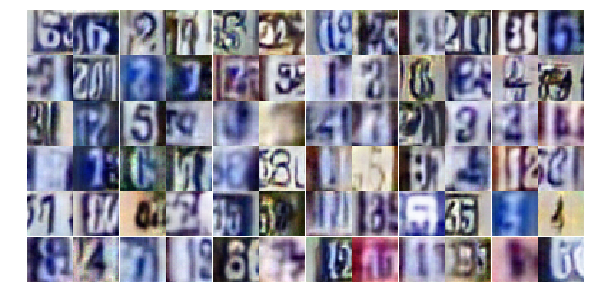

Epoch 20/25... Discriminator Loss: 0.7663... Generator Loss: 0.8605
Epoch 20/25... Discriminator Loss: 0.7573... Generator Loss: 0.9014
Epoch 20/25... Discriminator Loss: 1.3574... Generator Loss: 0.4404
Epoch 20/25... Discriminator Loss: 1.3569... Generator Loss: 0.4288
Epoch 20/25... Discriminator Loss: 0.4737... Generator Loss: 1.3306
Epoch 20/25... Discriminator Loss: 0.5653... Generator Loss: 1.2698
Epoch 20/25... Discriminator Loss: 0.7780... Generator Loss: 2.2349
Epoch 20/25... Discriminator Loss: 0.7740... Generator Loss: 0.9536
Epoch 20/25... Discriminator Loss: 0.7526... Generator Loss: 0.9753
Epoch 20/25... Discriminator Loss: 0.6964... Generator Loss: 0.8815


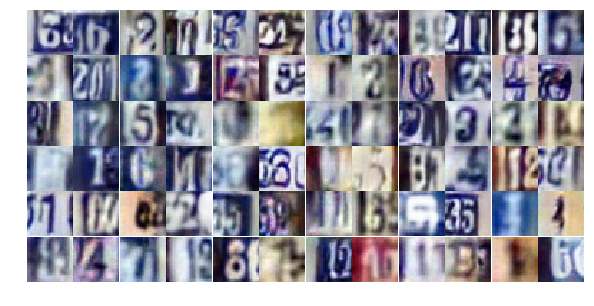

Epoch 20/25... Discriminator Loss: 1.0934... Generator Loss: 0.6456
Epoch 20/25... Discriminator Loss: 0.8707... Generator Loss: 0.7661
Epoch 20/25... Discriminator Loss: 0.6074... Generator Loss: 1.2612
Epoch 20/25... Discriminator Loss: 2.9050... Generator Loss: 0.1900
Epoch 20/25... Discriminator Loss: 4.7829... Generator Loss: 1.8008
Epoch 20/25... Discriminator Loss: 1.4779... Generator Loss: 0.5445
Epoch 20/25... Discriminator Loss: 1.2626... Generator Loss: 0.4925
Epoch 20/25... Discriminator Loss: 0.6060... Generator Loss: 1.2081
Epoch 20/25... Discriminator Loss: 0.7831... Generator Loss: 0.9146
Epoch 20/25... Discriminator Loss: 1.2465... Generator Loss: 0.4861


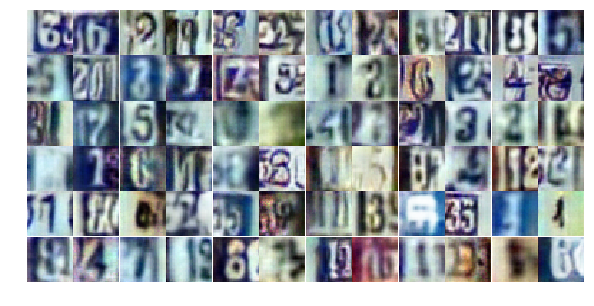

Epoch 20/25... Discriminator Loss: 0.5419... Generator Loss: 1.3453
Epoch 20/25... Discriminator Loss: 0.9653... Generator Loss: 0.6977
Epoch 20/25... Discriminator Loss: 0.3625... Generator Loss: 1.6256
Epoch 20/25... Discriminator Loss: 1.1527... Generator Loss: 0.6336
Epoch 20/25... Discriminator Loss: 0.7022... Generator Loss: 1.0230
Epoch 20/25... Discriminator Loss: 0.4272... Generator Loss: 1.6257
Epoch 20/25... Discriminator Loss: 0.5347... Generator Loss: 1.2797
Epoch 20/25... Discriminator Loss: 1.5736... Generator Loss: 0.3067
Epoch 20/25... Discriminator Loss: 1.0254... Generator Loss: 0.6182
Epoch 20/25... Discriminator Loss: 0.5234... Generator Loss: 1.1005


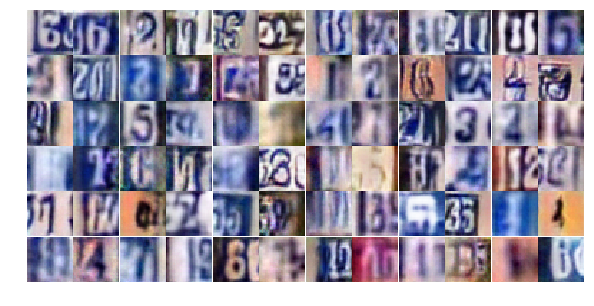

Epoch 20/25... Discriminator Loss: 0.6584... Generator Loss: 1.0979
Epoch 20/25... Discriminator Loss: 0.4568... Generator Loss: 1.4782
Epoch 20/25... Discriminator Loss: 1.1579... Generator Loss: 0.6003
Epoch 20/25... Discriminator Loss: 0.6060... Generator Loss: 1.2168
Epoch 20/25... Discriminator Loss: 1.0565... Generator Loss: 0.6659
Epoch 20/25... Discriminator Loss: 0.5264... Generator Loss: 1.3954
Epoch 20/25... Discriminator Loss: 0.6592... Generator Loss: 1.3183
Epoch 20/25... Discriminator Loss: 0.9949... Generator Loss: 0.6924
Epoch 20/25... Discriminator Loss: 0.7200... Generator Loss: 0.9694
Epoch 20/25... Discriminator Loss: 0.8495... Generator Loss: 0.7947


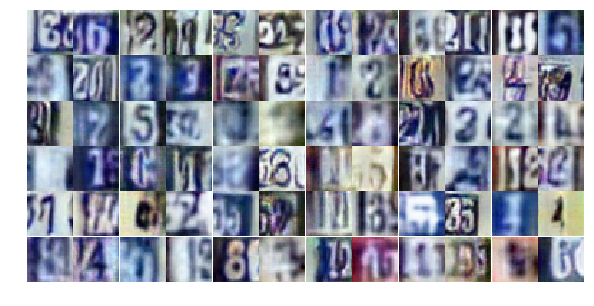

Epoch 20/25... Discriminator Loss: 0.6099... Generator Loss: 1.0577
Epoch 20/25... Discriminator Loss: 0.6437... Generator Loss: 1.1265
Epoch 20/25... Discriminator Loss: 0.6291... Generator Loss: 1.3722
Epoch 20/25... Discriminator Loss: 0.6686... Generator Loss: 1.0267
Epoch 20/25... Discriminator Loss: 0.5724... Generator Loss: 1.2355
Epoch 20/25... Discriminator Loss: 1.1596... Generator Loss: 0.4992
Epoch 20/25... Discriminator Loss: 0.9694... Generator Loss: 0.7481
Epoch 20/25... Discriminator Loss: 0.5090... Generator Loss: 1.4171
Epoch 20/25... Discriminator Loss: 0.8138... Generator Loss: 0.7788
Epoch 20/25... Discriminator Loss: 0.7619... Generator Loss: 1.0469


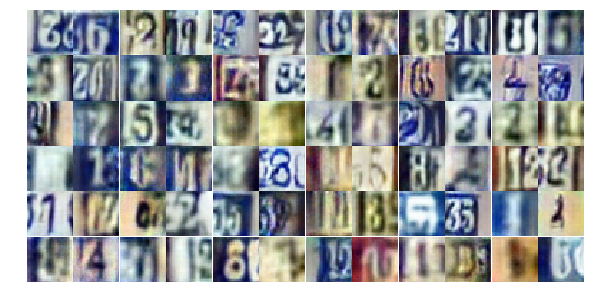

Epoch 20/25... Discriminator Loss: 0.5281... Generator Loss: 1.3790
Epoch 20/25... Discriminator Loss: 0.5842... Generator Loss: 1.4488
Epoch 20/25... Discriminator Loss: 0.5023... Generator Loss: 1.4699
Epoch 20/25... Discriminator Loss: 0.6275... Generator Loss: 1.2619
Epoch 20/25... Discriminator Loss: 0.5489... Generator Loss: 1.3199
Epoch 20/25... Discriminator Loss: 0.4394... Generator Loss: 1.4987
Epoch 21/25... Discriminator Loss: 0.9514... Generator Loss: 0.7390
Epoch 21/25... Discriminator Loss: 0.8240... Generator Loss: 0.8227
Epoch 21/25... Discriminator Loss: 1.2546... Generator Loss: 0.4845
Epoch 21/25... Discriminator Loss: 0.7887... Generator Loss: 0.8286


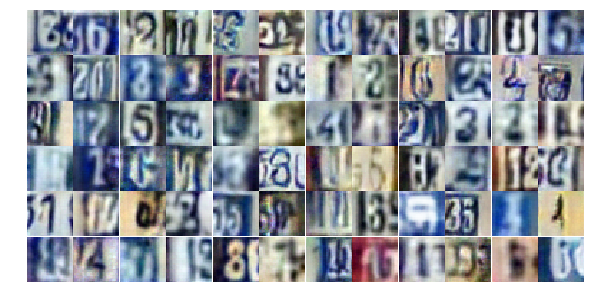

Epoch 21/25... Discriminator Loss: 0.5352... Generator Loss: 2.4125
Epoch 21/25... Discriminator Loss: 1.6017... Generator Loss: 0.3912
Epoch 21/25... Discriminator Loss: 0.3883... Generator Loss: 1.9995
Epoch 21/25... Discriminator Loss: 0.3585... Generator Loss: 1.6158
Epoch 21/25... Discriminator Loss: 0.7830... Generator Loss: 0.8357
Epoch 21/25... Discriminator Loss: 0.5928... Generator Loss: 1.1563
Epoch 21/25... Discriminator Loss: 0.7295... Generator Loss: 0.9263
Epoch 21/25... Discriminator Loss: 0.6973... Generator Loss: 0.9728
Epoch 21/25... Discriminator Loss: 0.6718... Generator Loss: 0.9621
Epoch 21/25... Discriminator Loss: 0.9581... Generator Loss: 0.7454


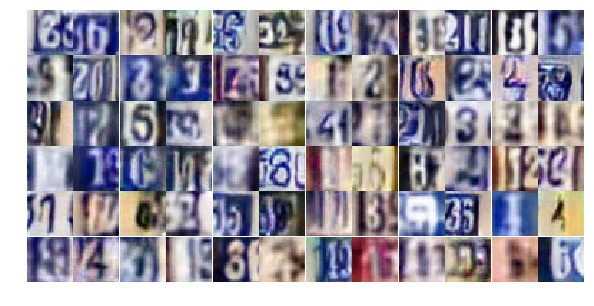

Epoch 21/25... Discriminator Loss: 0.5085... Generator Loss: 1.2415
Epoch 21/25... Discriminator Loss: 0.8230... Generator Loss: 0.8052
Epoch 21/25... Discriminator Loss: 1.1673... Generator Loss: 0.6344
Epoch 21/25... Discriminator Loss: 1.9773... Generator Loss: 0.3692
Epoch 21/25... Discriminator Loss: 0.5763... Generator Loss: 1.3346
Epoch 21/25... Discriminator Loss: 1.2265... Generator Loss: 0.5437
Epoch 21/25... Discriminator Loss: 0.8887... Generator Loss: 0.7348
Epoch 21/25... Discriminator Loss: 0.3867... Generator Loss: 1.9871
Epoch 21/25... Discriminator Loss: 0.4711... Generator Loss: 1.3937
Epoch 21/25... Discriminator Loss: 0.7542... Generator Loss: 1.0084


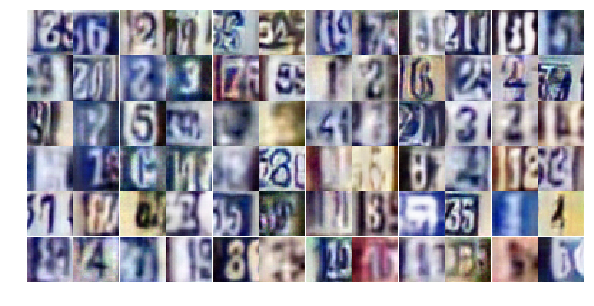

Epoch 21/25... Discriminator Loss: 1.5783... Generator Loss: 0.3770
Epoch 21/25... Discriminator Loss: 0.3501... Generator Loss: 1.9758
Epoch 21/25... Discriminator Loss: 0.7720... Generator Loss: 1.4637
Epoch 21/25... Discriminator Loss: 0.8199... Generator Loss: 0.9445
Epoch 21/25... Discriminator Loss: 1.1925... Generator Loss: 0.5523
Epoch 21/25... Discriminator Loss: 0.8102... Generator Loss: 0.8734
Epoch 21/25... Discriminator Loss: 0.5449... Generator Loss: 1.3685
Epoch 21/25... Discriminator Loss: 1.0878... Generator Loss: 0.6283
Epoch 21/25... Discriminator Loss: 1.1731... Generator Loss: 0.5755
Epoch 21/25... Discriminator Loss: 1.7487... Generator Loss: 0.3241


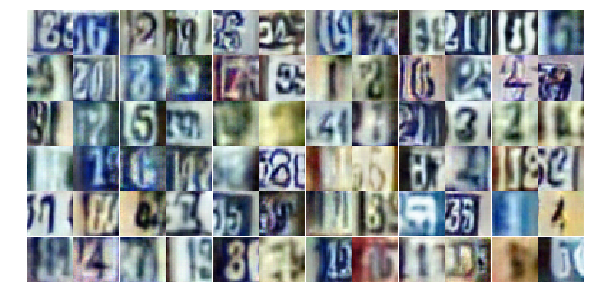

Epoch 21/25... Discriminator Loss: 1.4651... Generator Loss: 0.3713
Epoch 21/25... Discriminator Loss: 0.6613... Generator Loss: 0.9953
Epoch 21/25... Discriminator Loss: 0.9493... Generator Loss: 0.6702
Epoch 21/25... Discriminator Loss: 0.4058... Generator Loss: 1.7074
Epoch 21/25... Discriminator Loss: 0.5755... Generator Loss: 1.1564
Epoch 21/25... Discriminator Loss: 0.7518... Generator Loss: 0.8833
Epoch 21/25... Discriminator Loss: 0.5146... Generator Loss: 1.3598
Epoch 21/25... Discriminator Loss: 1.2298... Generator Loss: 0.4646
Epoch 21/25... Discriminator Loss: 0.8555... Generator Loss: 0.7851
Epoch 21/25... Discriminator Loss: 0.2573... Generator Loss: 2.4916


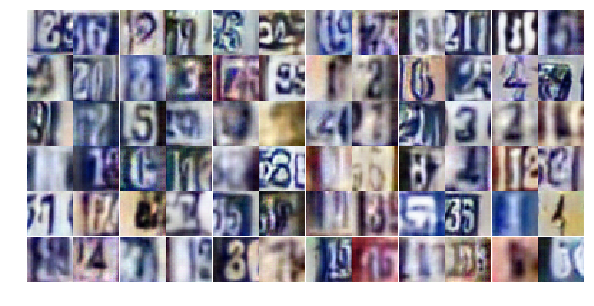

Epoch 21/25... Discriminator Loss: 1.0350... Generator Loss: 0.6381
Epoch 21/25... Discriminator Loss: 1.8889... Generator Loss: 0.2842
Epoch 21/25... Discriminator Loss: 0.6160... Generator Loss: 1.0377
Epoch 21/25... Discriminator Loss: 0.7135... Generator Loss: 1.0257
Epoch 21/25... Discriminator Loss: 0.4176... Generator Loss: 1.3348
Epoch 21/25... Discriminator Loss: 0.5600... Generator Loss: 1.2229
Epoch 21/25... Discriminator Loss: 0.9896... Generator Loss: 0.7139
Epoch 21/25... Discriminator Loss: 3.1141... Generator Loss: 0.1219
Epoch 21/25... Discriminator Loss: 2.4118... Generator Loss: 0.6989
Epoch 21/25... Discriminator Loss: 1.3099... Generator Loss: 0.4829


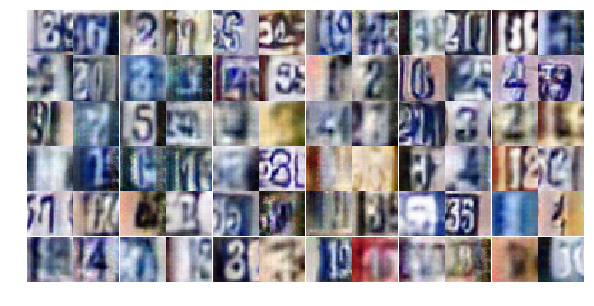

Epoch 21/25... Discriminator Loss: 0.8856... Generator Loss: 2.1653
Epoch 21/25... Discriminator Loss: 1.0460... Generator Loss: 0.7201
Epoch 21/25... Discriminator Loss: 0.8816... Generator Loss: 0.9044
Epoch 22/25... Discriminator Loss: 0.8804... Generator Loss: 0.7855
Epoch 22/25... Discriminator Loss: 1.4186... Generator Loss: 0.4555
Epoch 22/25... Discriminator Loss: 0.7390... Generator Loss: 1.0040
Epoch 22/25... Discriminator Loss: 0.6750... Generator Loss: 1.0116
Epoch 22/25... Discriminator Loss: 0.7266... Generator Loss: 1.0682
Epoch 22/25... Discriminator Loss: 1.0316... Generator Loss: 0.6626
Epoch 22/25... Discriminator Loss: 1.0551... Generator Loss: 0.6319


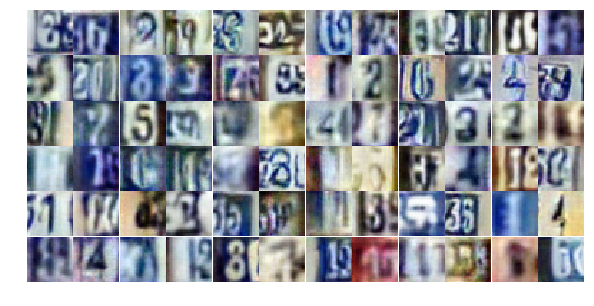

Epoch 22/25... Discriminator Loss: 0.5196... Generator Loss: 1.4556
Epoch 22/25... Discriminator Loss: 0.6820... Generator Loss: 1.4421
Epoch 22/25... Discriminator Loss: 1.3512... Generator Loss: 0.4736
Epoch 22/25... Discriminator Loss: 1.0960... Generator Loss: 0.5602
Epoch 22/25... Discriminator Loss: 0.7058... Generator Loss: 0.9822
Epoch 22/25... Discriminator Loss: 0.9424... Generator Loss: 0.7381
Epoch 22/25... Discriminator Loss: 0.8172... Generator Loss: 0.9639
Epoch 22/25... Discriminator Loss: 0.4942... Generator Loss: 1.3336
Epoch 22/25... Discriminator Loss: 0.9938... Generator Loss: 0.6403
Epoch 22/25... Discriminator Loss: 1.6677... Generator Loss: 0.3244


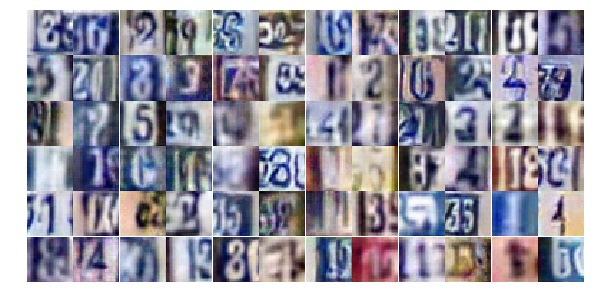

Epoch 22/25... Discriminator Loss: 0.5294... Generator Loss: 1.1979
Epoch 22/25... Discriminator Loss: 0.7613... Generator Loss: 0.8866
Epoch 22/25... Discriminator Loss: 0.9415... Generator Loss: 0.7533
Epoch 22/25... Discriminator Loss: 0.4481... Generator Loss: 1.3803
Epoch 22/25... Discriminator Loss: 0.5213... Generator Loss: 1.8024
Epoch 22/25... Discriminator Loss: 0.7997... Generator Loss: 0.8886
Epoch 22/25... Discriminator Loss: 0.4816... Generator Loss: 1.5919
Epoch 22/25... Discriminator Loss: 0.3891... Generator Loss: 1.7616
Epoch 22/25... Discriminator Loss: 0.5412... Generator Loss: 1.1804
Epoch 22/25... Discriminator Loss: 0.7627... Generator Loss: 0.8836


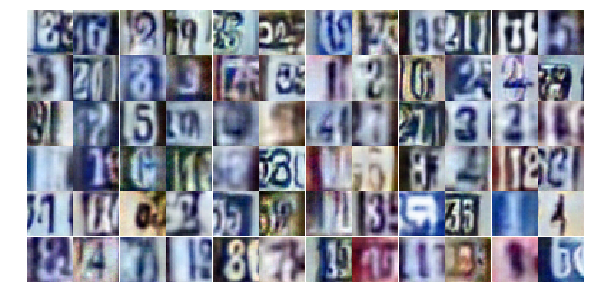

Epoch 22/25... Discriminator Loss: 0.3426... Generator Loss: 1.6607
Epoch 22/25... Discriminator Loss: 0.6207... Generator Loss: 1.0559
Epoch 22/25... Discriminator Loss: 1.2255... Generator Loss: 0.5861
Epoch 22/25... Discriminator Loss: 0.9357... Generator Loss: 0.7255
Epoch 22/25... Discriminator Loss: 0.8327... Generator Loss: 0.8537
Epoch 22/25... Discriminator Loss: 1.1718... Generator Loss: 0.5689
Epoch 22/25... Discriminator Loss: 1.8131... Generator Loss: 0.2600
Epoch 22/25... Discriminator Loss: 0.5346... Generator Loss: 1.3211
Epoch 22/25... Discriminator Loss: 0.7712... Generator Loss: 0.8887
Epoch 22/25... Discriminator Loss: 0.6730... Generator Loss: 0.9538


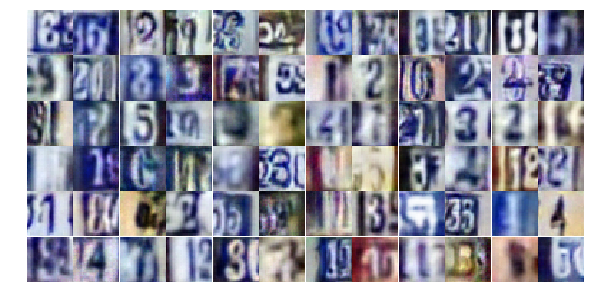

Epoch 22/25... Discriminator Loss: 0.6919... Generator Loss: 1.0525
Epoch 22/25... Discriminator Loss: 0.5245... Generator Loss: 1.4745
Epoch 22/25... Discriminator Loss: 0.3893... Generator Loss: 1.8064
Epoch 22/25... Discriminator Loss: 0.6250... Generator Loss: 1.1636
Epoch 22/25... Discriminator Loss: 0.3094... Generator Loss: 2.6418
Epoch 22/25... Discriminator Loss: 0.7962... Generator Loss: 0.8412
Epoch 22/25... Discriminator Loss: 1.1336... Generator Loss: 0.5973
Epoch 22/25... Discriminator Loss: 0.7267... Generator Loss: 1.0055
Epoch 22/25... Discriminator Loss: 1.5206... Generator Loss: 0.3672
Epoch 22/25... Discriminator Loss: 0.7877... Generator Loss: 1.1266


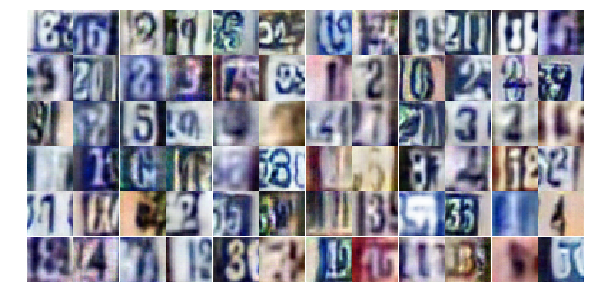

Epoch 22/25... Discriminator Loss: 0.8631... Generator Loss: 0.8287
Epoch 22/25... Discriminator Loss: 0.5037... Generator Loss: 1.3914
Epoch 22/25... Discriminator Loss: 0.9186... Generator Loss: 0.7562
Epoch 22/25... Discriminator Loss: 1.0710... Generator Loss: 0.6549
Epoch 22/25... Discriminator Loss: 1.6136... Generator Loss: 0.3944
Epoch 22/25... Discriminator Loss: 0.8432... Generator Loss: 1.0625
Epoch 22/25... Discriminator Loss: 0.7765... Generator Loss: 1.0827
Epoch 22/25... Discriminator Loss: 0.5447... Generator Loss: 1.1732
Epoch 22/25... Discriminator Loss: 0.6602... Generator Loss: 1.5214
Epoch 22/25... Discriminator Loss: 0.7315... Generator Loss: 0.9047


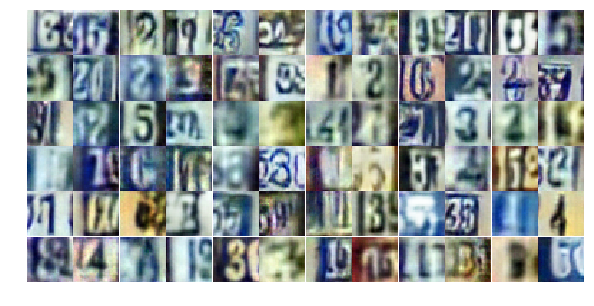

Epoch 23/25... Discriminator Loss: 0.4782... Generator Loss: 1.4285
Epoch 23/25... Discriminator Loss: 0.6130... Generator Loss: 1.0971
Epoch 23/25... Discriminator Loss: 1.0637... Generator Loss: 0.6902
Epoch 23/25... Discriminator Loss: 0.5478... Generator Loss: 1.1759
Epoch 23/25... Discriminator Loss: 0.8134... Generator Loss: 0.7686
Epoch 23/25... Discriminator Loss: 1.2304... Generator Loss: 0.5325
Epoch 23/25... Discriminator Loss: 1.4012... Generator Loss: 0.4566
Epoch 23/25... Discriminator Loss: 0.8612... Generator Loss: 0.7634
Epoch 23/25... Discriminator Loss: 0.5646... Generator Loss: 1.1815
Epoch 23/25... Discriminator Loss: 0.4128... Generator Loss: 2.0301


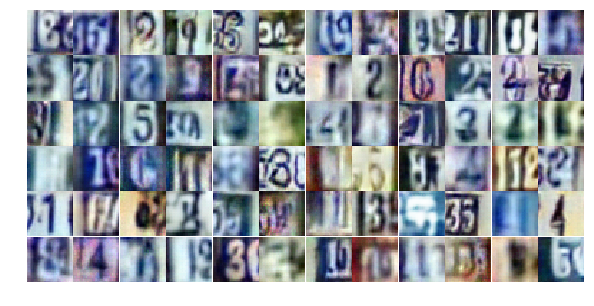

Epoch 23/25... Discriminator Loss: 0.7701... Generator Loss: 0.8332
Epoch 23/25... Discriminator Loss: 0.5564... Generator Loss: 1.1957
Epoch 23/25... Discriminator Loss: 0.6527... Generator Loss: 1.1637
Epoch 23/25... Discriminator Loss: 0.6489... Generator Loss: 1.0575
Epoch 23/25... Discriminator Loss: 0.3847... Generator Loss: 1.6098
Epoch 23/25... Discriminator Loss: 1.2685... Generator Loss: 0.4856
Epoch 23/25... Discriminator Loss: 1.1265... Generator Loss: 0.5541
Epoch 23/25... Discriminator Loss: 0.6197... Generator Loss: 1.2076
Epoch 23/25... Discriminator Loss: 1.2681... Generator Loss: 0.4845
Epoch 23/25... Discriminator Loss: 0.8891... Generator Loss: 0.7701


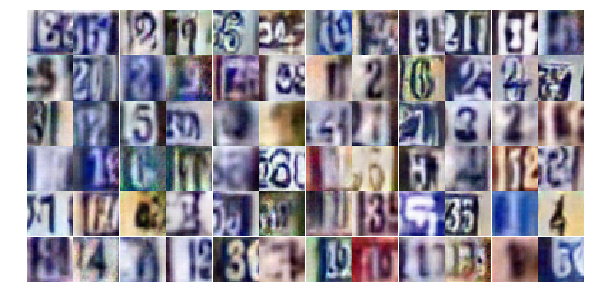

Epoch 23/25... Discriminator Loss: 1.6628... Generator Loss: 0.3507
Epoch 23/25... Discriminator Loss: 0.5050... Generator Loss: 1.3154
Epoch 23/25... Discriminator Loss: 1.2263... Generator Loss: 0.5029
Epoch 23/25... Discriminator Loss: 0.9680... Generator Loss: 0.6876
Epoch 23/25... Discriminator Loss: 1.1890... Generator Loss: 0.4971
Epoch 23/25... Discriminator Loss: 0.7393... Generator Loss: 1.0333
Epoch 23/25... Discriminator Loss: 0.4431... Generator Loss: 1.7081
Epoch 23/25... Discriminator Loss: 0.6395... Generator Loss: 1.1336
Epoch 23/25... Discriminator Loss: 4.8736... Generator Loss: 0.0678
Epoch 23/25... Discriminator Loss: 1.1431... Generator Loss: 1.8397


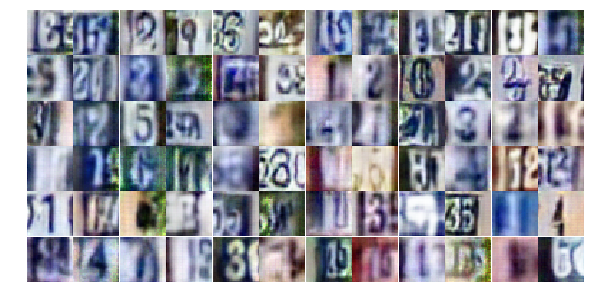

Epoch 23/25... Discriminator Loss: 0.5956... Generator Loss: 1.3839
Epoch 23/25... Discriminator Loss: 0.6969... Generator Loss: 0.9907
Epoch 23/25... Discriminator Loss: 0.5278... Generator Loss: 1.4896
Epoch 23/25... Discriminator Loss: 1.2482... Generator Loss: 0.4934
Epoch 23/25... Discriminator Loss: 0.8757... Generator Loss: 0.8423
Epoch 23/25... Discriminator Loss: 0.9965... Generator Loss: 0.6586
Epoch 23/25... Discriminator Loss: 1.1601... Generator Loss: 0.5604
Epoch 23/25... Discriminator Loss: 0.6047... Generator Loss: 1.2181
Epoch 23/25... Discriminator Loss: 0.3869... Generator Loss: 1.7796
Epoch 23/25... Discriminator Loss: 0.5587... Generator Loss: 1.2363


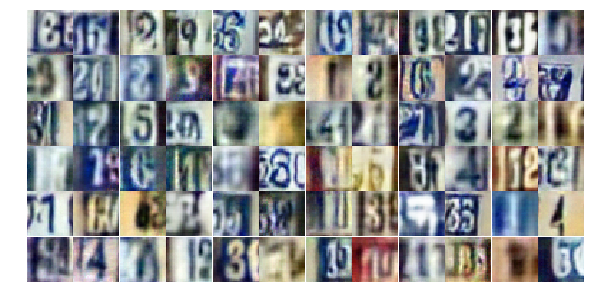

Epoch 23/25... Discriminator Loss: 1.2159... Generator Loss: 0.5932
Epoch 23/25... Discriminator Loss: 0.9662... Generator Loss: 0.6254
Epoch 23/25... Discriminator Loss: 0.8817... Generator Loss: 0.7741
Epoch 23/25... Discriminator Loss: 0.7555... Generator Loss: 1.0461
Epoch 23/25... Discriminator Loss: 1.2803... Generator Loss: 0.6301
Epoch 23/25... Discriminator Loss: 1.4903... Generator Loss: 0.4678
Epoch 23/25... Discriminator Loss: 0.7746... Generator Loss: 0.9840
Epoch 23/25... Discriminator Loss: 1.0754... Generator Loss: 0.6566
Epoch 23/25... Discriminator Loss: 0.5670... Generator Loss: 1.2199
Epoch 23/25... Discriminator Loss: 1.1363... Generator Loss: 0.5775


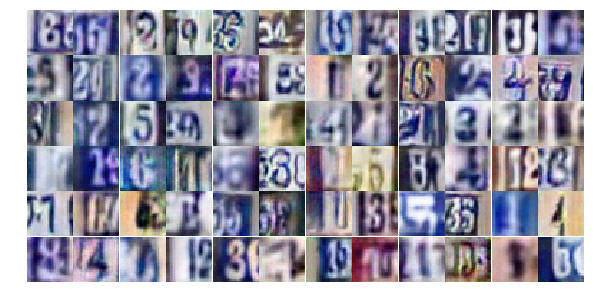

Epoch 23/25... Discriminator Loss: 0.7850... Generator Loss: 0.8170
Epoch 23/25... Discriminator Loss: 1.0310... Generator Loss: 0.6722
Epoch 23/25... Discriminator Loss: 1.0061... Generator Loss: 0.7807
Epoch 23/25... Discriminator Loss: 0.2533... Generator Loss: 2.1103
Epoch 23/25... Discriminator Loss: 1.1203... Generator Loss: 0.6757
Epoch 23/25... Discriminator Loss: 0.4177... Generator Loss: 1.9634
Epoch 23/25... Discriminator Loss: 1.2074... Generator Loss: 0.6122
Epoch 24/25... Discriminator Loss: 0.7025... Generator Loss: 1.2417
Epoch 24/25... Discriminator Loss: 1.3661... Generator Loss: 0.5496
Epoch 24/25... Discriminator Loss: 0.8358... Generator Loss: 0.8337


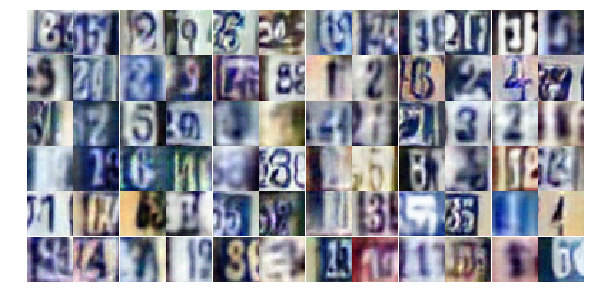

Epoch 24/25... Discriminator Loss: 0.5992... Generator Loss: 1.3126
Epoch 24/25... Discriminator Loss: 0.6599... Generator Loss: 1.1276
Epoch 24/25... Discriminator Loss: 0.6053... Generator Loss: 1.1560
Epoch 24/25... Discriminator Loss: 0.6989... Generator Loss: 1.0698
Epoch 24/25... Discriminator Loss: 0.4552... Generator Loss: 1.4249
Epoch 24/25... Discriminator Loss: 0.5420... Generator Loss: 1.6608
Epoch 24/25... Discriminator Loss: 0.8325... Generator Loss: 1.0447
Epoch 24/25... Discriminator Loss: 1.3867... Generator Loss: 0.4119
Epoch 24/25... Discriminator Loss: 0.3583... Generator Loss: 1.6038
Epoch 24/25... Discriminator Loss: 0.5271... Generator Loss: 2.3164


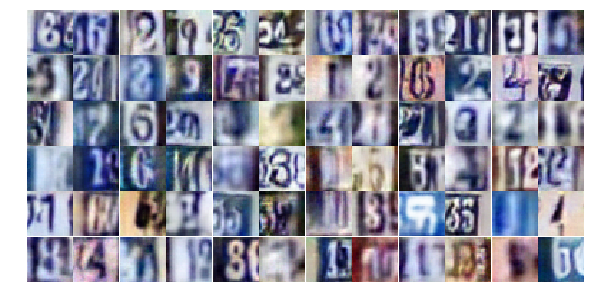

Epoch 24/25... Discriminator Loss: 0.7639... Generator Loss: 1.5983
Epoch 24/25... Discriminator Loss: 1.1166... Generator Loss: 0.5396
Epoch 24/25... Discriminator Loss: 0.9727... Generator Loss: 0.7252
Epoch 24/25... Discriminator Loss: 0.6201... Generator Loss: 1.0239
Epoch 24/25... Discriminator Loss: 0.6094... Generator Loss: 1.3150
Epoch 24/25... Discriminator Loss: 0.9898... Generator Loss: 0.6619
Epoch 24/25... Discriminator Loss: 0.4795... Generator Loss: 1.3371
Epoch 24/25... Discriminator Loss: 0.9164... Generator Loss: 0.8220
Epoch 24/25... Discriminator Loss: 0.6464... Generator Loss: 1.3329
Epoch 24/25... Discriminator Loss: 0.6511... Generator Loss: 1.1564


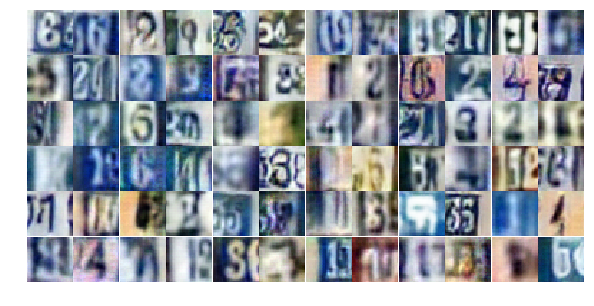

Epoch 24/25... Discriminator Loss: 0.5039... Generator Loss: 1.3100
Epoch 24/25... Discriminator Loss: 0.6124... Generator Loss: 1.0438
Epoch 24/25... Discriminator Loss: 0.4612... Generator Loss: 1.4726
Epoch 24/25... Discriminator Loss: 1.2726... Generator Loss: 0.5366
Epoch 24/25... Discriminator Loss: 0.5881... Generator Loss: 1.1355
Epoch 24/25... Discriminator Loss: 0.7450... Generator Loss: 0.8734
Epoch 24/25... Discriminator Loss: 0.4601... Generator Loss: 1.2789
Epoch 24/25... Discriminator Loss: 0.5531... Generator Loss: 1.1986
Epoch 24/25... Discriminator Loss: 0.5235... Generator Loss: 1.4313
Epoch 24/25... Discriminator Loss: 1.0091... Generator Loss: 0.6271


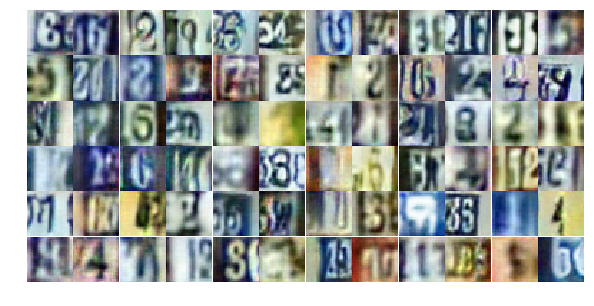

Epoch 24/25... Discriminator Loss: 0.5952... Generator Loss: 1.1065
Epoch 24/25... Discriminator Loss: 0.4463... Generator Loss: 1.4201
Epoch 24/25... Discriminator Loss: 0.8417... Generator Loss: 1.0208
Epoch 24/25... Discriminator Loss: 2.2448... Generator Loss: 0.1950
Epoch 24/25... Discriminator Loss: 1.0819... Generator Loss: 0.7695
Epoch 24/25... Discriminator Loss: 1.3134... Generator Loss: 0.4528
Epoch 24/25... Discriminator Loss: 1.3403... Generator Loss: 0.4799
Epoch 24/25... Discriminator Loss: 1.1304... Generator Loss: 0.5506
Epoch 24/25... Discriminator Loss: 0.7042... Generator Loss: 1.1212
Epoch 24/25... Discriminator Loss: 0.9890... Generator Loss: 0.6883


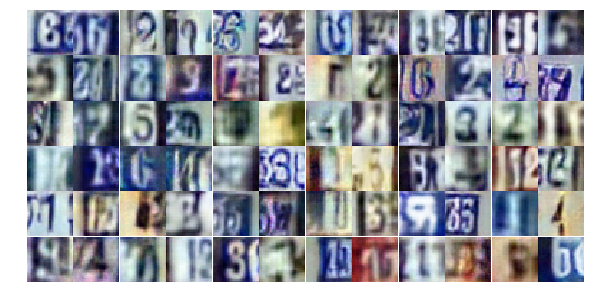

Epoch 24/25... Discriminator Loss: 0.8536... Generator Loss: 0.8963
Epoch 24/25... Discriminator Loss: 2.3309... Generator Loss: 0.1694
Epoch 24/25... Discriminator Loss: 1.6172... Generator Loss: 0.4244
Epoch 24/25... Discriminator Loss: 1.4172... Generator Loss: 0.4316
Epoch 24/25... Discriminator Loss: 0.9141... Generator Loss: 0.7716
Epoch 24/25... Discriminator Loss: 0.7185... Generator Loss: 0.9799
Epoch 24/25... Discriminator Loss: 1.3393... Generator Loss: 0.5205
Epoch 24/25... Discriminator Loss: 0.6494... Generator Loss: 1.0964
Epoch 24/25... Discriminator Loss: 1.0873... Generator Loss: 0.5538
Epoch 24/25... Discriminator Loss: 0.8915... Generator Loss: 0.8016


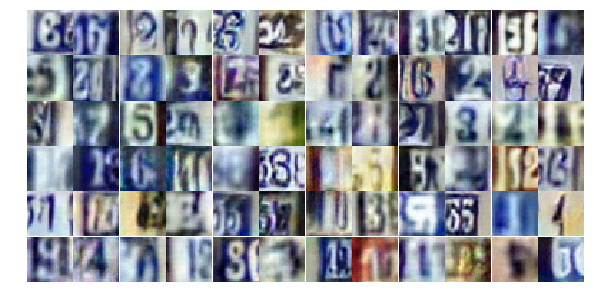

Epoch 24/25... Discriminator Loss: 0.9244... Generator Loss: 0.7746
Epoch 24/25... Discriminator Loss: 0.8649... Generator Loss: 0.8418
Epoch 24/25... Discriminator Loss: 1.5015... Generator Loss: 0.3611
Epoch 24/25... Discriminator Loss: 0.8424... Generator Loss: 0.8397
Epoch 24/25... Discriminator Loss: 1.2208... Generator Loss: 0.5185
Epoch 25/25... Discriminator Loss: 0.7167... Generator Loss: 1.7097
Epoch 25/25... Discriminator Loss: 0.5313... Generator Loss: 1.2655
Epoch 25/25... Discriminator Loss: 0.7193... Generator Loss: 0.9712
Epoch 25/25... Discriminator Loss: 0.8229... Generator Loss: 0.8046
Epoch 25/25... Discriminator Loss: 1.0266... Generator Loss: 0.6809


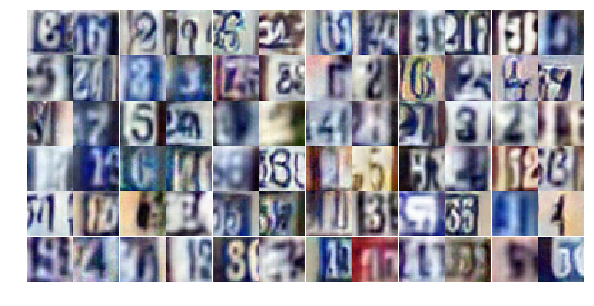

Epoch 25/25... Discriminator Loss: 0.9865... Generator Loss: 0.6872
Epoch 25/25... Discriminator Loss: 0.9648... Generator Loss: 0.7349
Epoch 25/25... Discriminator Loss: 1.0184... Generator Loss: 0.6478
Epoch 25/25... Discriminator Loss: 0.9980... Generator Loss: 0.7127
Epoch 25/25... Discriminator Loss: 0.7128... Generator Loss: 2.3540
Epoch 25/25... Discriminator Loss: 0.7762... Generator Loss: 0.9601
Epoch 25/25... Discriminator Loss: 0.5249... Generator Loss: 1.2111
Epoch 25/25... Discriminator Loss: 0.7926... Generator Loss: 0.9987
Epoch 25/25... Discriminator Loss: 0.5771... Generator Loss: 1.1965
Epoch 25/25... Discriminator Loss: 0.6518... Generator Loss: 1.0815


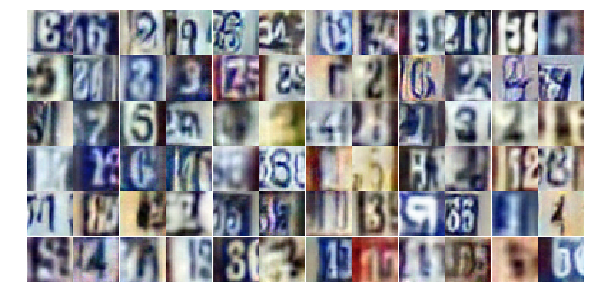

Epoch 25/25... Discriminator Loss: 0.5827... Generator Loss: 1.2603
Epoch 25/25... Discriminator Loss: 0.4403... Generator Loss: 1.5520
Epoch 25/25... Discriminator Loss: 0.8911... Generator Loss: 0.7851
Epoch 25/25... Discriminator Loss: 1.5163... Generator Loss: 0.3885
Epoch 25/25... Discriminator Loss: 0.5239... Generator Loss: 1.4491
Epoch 25/25... Discriminator Loss: 0.4634... Generator Loss: 1.4492
Epoch 25/25... Discriminator Loss: 0.8796... Generator Loss: 0.8412
Epoch 25/25... Discriminator Loss: 0.6366... Generator Loss: 1.2817
Epoch 25/25... Discriminator Loss: 0.6407... Generator Loss: 1.1121
Epoch 25/25... Discriminator Loss: 1.0287... Generator Loss: 0.6335


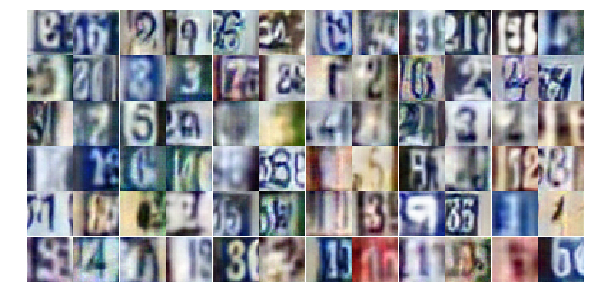

Epoch 25/25... Discriminator Loss: 1.4785... Generator Loss: 0.4801
Epoch 25/25... Discriminator Loss: 0.7532... Generator Loss: 0.9799
Epoch 25/25... Discriminator Loss: 1.8573... Generator Loss: 0.3080
Epoch 25/25... Discriminator Loss: 1.5386... Generator Loss: 0.5750
Epoch 25/25... Discriminator Loss: 0.8744... Generator Loss: 1.0331
Epoch 25/25... Discriminator Loss: 0.5468... Generator Loss: 1.2035
Epoch 25/25... Discriminator Loss: 0.7482... Generator Loss: 1.0768
Epoch 25/25... Discriminator Loss: 0.6846... Generator Loss: 1.0817
Epoch 25/25... Discriminator Loss: 1.0466... Generator Loss: 0.6977
Epoch 25/25... Discriminator Loss: 0.4968... Generator Loss: 1.3221


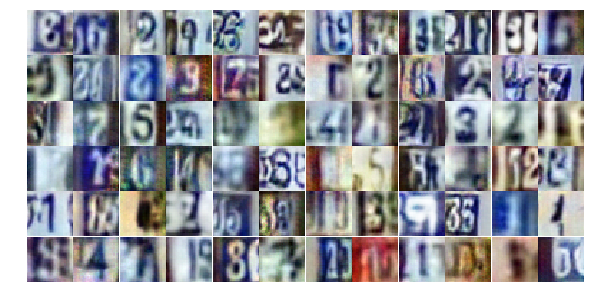

Epoch 25/25... Discriminator Loss: 0.8156... Generator Loss: 0.8675
Epoch 25/25... Discriminator Loss: 0.8863... Generator Loss: 0.7263
Epoch 25/25... Discriminator Loss: 0.9985... Generator Loss: 0.7387
Epoch 25/25... Discriminator Loss: 0.9570... Generator Loss: 0.7449
Epoch 25/25... Discriminator Loss: 0.9203... Generator Loss: 0.7718
Epoch 25/25... Discriminator Loss: 0.9893... Generator Loss: 0.6845
Epoch 25/25... Discriminator Loss: 0.7001... Generator Loss: 1.0275
Epoch 25/25... Discriminator Loss: 0.5931... Generator Loss: 1.1123
Epoch 25/25... Discriminator Loss: 1.8701... Generator Loss: 0.4001
Epoch 25/25... Discriminator Loss: 0.4848... Generator Loss: 1.4254


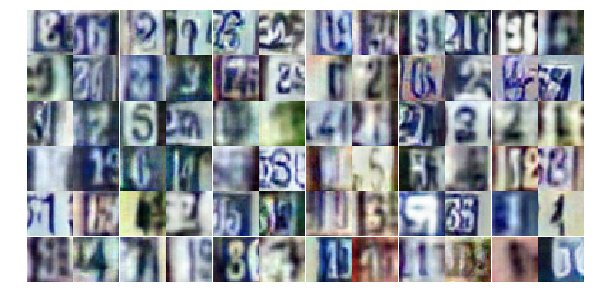

Epoch 25/25... Discriminator Loss: 0.9109... Generator Loss: 2.0698
Epoch 25/25... Discriminator Loss: 0.9123... Generator Loss: 0.7365
Epoch 25/25... Discriminator Loss: 0.9283... Generator Loss: 0.7233
Epoch 25/25... Discriminator Loss: 1.0528... Generator Loss: 0.6638
Epoch 25/25... Discriminator Loss: 0.9037... Generator Loss: 0.7499
Epoch 25/25... Discriminator Loss: 0.4985... Generator Loss: 2.7266
Epoch 25/25... Discriminator Loss: 1.0250... Generator Loss: 0.7186
Epoch 25/25... Discriminator Loss: 0.5952... Generator Loss: 1.1974
Epoch 25/25... Discriminator Loss: 0.5564... Generator Loss: 1.4471
Epoch 25/25... Discriminator Loss: 0.8342... Generator Loss: 0.8120


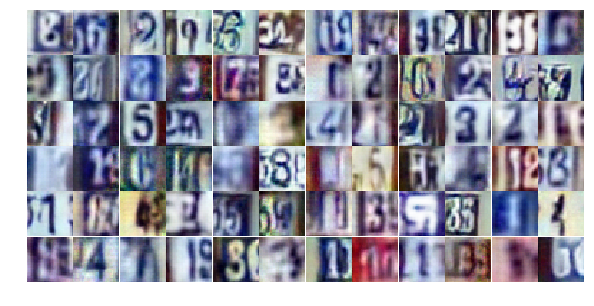

Epoch 25/25... Discriminator Loss: 0.3424... Generator Loss: 2.3203
Epoch 25/25... Discriminator Loss: 1.5199... Generator Loss: 0.4603


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

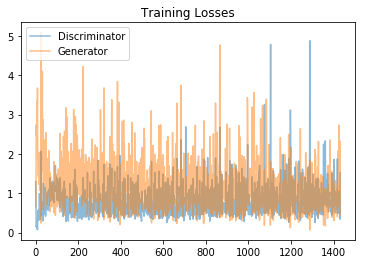

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

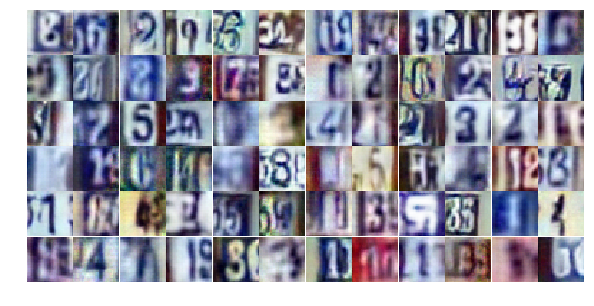

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))